In [104]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader

import torchvision.transforms as transforms
import torchvision.utils
from torchvision.utils import make_grid

import torchvision.datasets

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,6)

from tqdm import tqdm

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")


# Introduction to Generative Adversarial Networks (GANs)

In this notebook you will build a GAN from scratch, grossly following the DCGAN architecture.

**Goals:**


1.   Build a GAN arhictecture from scratch
2.   Write the GAN loss function and train GAN from scratch
3.   Have experience with some of the instability problems inherent with training GANs.
4.   [Bonus] Extend the unconditional GAN into a conditional GAN.



## 1. Getting Started

We will work with the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset. It contains 60,000 images size 28x28 of handwritten digits, from 0 to 9.

## 1. Dataloading

### 1.1 Define some hyperparameters and transforms


In [105]:
batch_size = 128 # Images per batch

# Resize to 32x32 for easier upsampling/downsampling
mytransform = transforms.Compose([transforms.Resize(32),
                                  transforms.ToTensor(),
                                 transforms.Normalize((.5), (.5))]) # normalize between [-1, 1] with tanh activation

mnist_train = torchvision.datasets.MNIST(root='.', download=True, transform=mytransform)

In [106]:
dataloader = DataLoader(dataset=mnist_train,
                         batch_size=batch_size,
                         shuffle=True)

In [107]:
# plot some images
real_batch, real_labels = next(iter(dataloader))

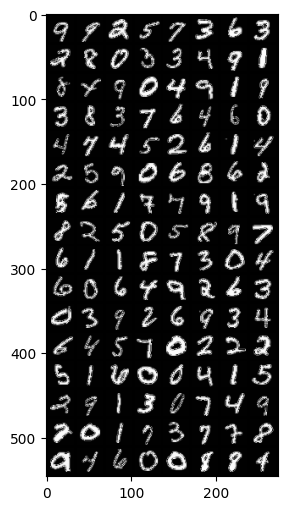

In [108]:
plt.imshow(transforms.ToPILImage()(make_grid(real_batch)))

## 2. Model Architecture

We will follow the general architecture of a DCGAN - or deep convolutional GAN. This [influential paper](https://arxiv.org/pdf/1511.06434v2.pdf) produced much of the foundation for modern GANs and how to train them.

(GANs are notoriously **hard** to train, we will try to get a feeling why in this notebook.)


Complete the function `get_upscaling_block`. Then, use the function to define our model defined as follows:

Input: Random "noise" $z$ shaped `[n_batch, n_z]`

Output: Generated image size `[n_batch, 1, 32, 32]` in range [-1, 1]

1. Reshape z into `[n_batch, n_z, 1, 1]` to make it into an "image"
2. First upscaling block $\rightarrow$ `[n_batch, ngf*4, 4, 4]`
3. Second upscaling block $\rightarrow$ `[n_batch, ngf*2, 8, 8]`
4. Third upscaling block $\rightarrow$ `[n_batch, ngf, 16, 16]`
5. Fourth (and last) upscaling block $\rightarrow$ `[n_batch, 1, 32, 32]`

## 2.1. The Generator



The generator performs subsequent upsampling blocks, transforming a latent vector shaped [batch_size, latent_size] into an image (values in [-1, 1]).

The generator block will consists of:
- Transpose Convolution
- Batch Norm
- ReLU

In [109]:
def get_upscaling_block(channels_in, channels_out, kernel, stride, padding, last_layer=False):
    '''
    Each transpose conv will be followed by BatchNorm and ReLU,
    except the last block (which is only followed by tanh)
    '''
    if last_layer:
        return nn.Sequential(
            nn.ConvTranspose2d(channels_in, channels_out, kernel, stride, padding),
            nn.Tanh()
        )
    else:
        return nn.Sequential(
            nn.ConvTranspose2d(channels_in, channels_out, kernel, stride, padding),
            nn.BatchNorm2d(channels_out),
            nn.ReLU(inplace=True)
        )




class Generator(nn.Module):
    def __init__(self, nz, ngf, nchannels=1):
        '''
        nz: The latent size (100 in our case)
        ngf: The channel-size before the last layer (32 our case)
        '''
        super().__init__()

        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #

        self.model = nn.Sequential(
            get_upscaling_block(nz, ngf * 4, kernel=4, stride=1, padding=0),  # [n_batch, ngf*4, 4, 4]
            get_upscaling_block(ngf * 4, ngf * 2, kernel=4, stride=2, padding=1),  # [n_batch, ngf*2, 8, 8]
            get_upscaling_block(ngf * 2, ngf, kernel=4, stride=2, padding=1),  # [n_batch, ngf, 16, 16]
            get_upscaling_block(ngf, nchannels, kernel=4, stride=2, padding=1, last_layer=True)  # [n_batch, 1, 32, 32]
        )

        ###################

    def forward(self, z):
        x = z.unsqueeze(2).unsqueeze(2) # give spatial dimensions to z
        return self.model(x)


### 2.1.3. Sanity Tests

In [110]:
nz = 10
z = torch.randn(batch_size, nz)

In [111]:
G = Generator(nz=nz, ngf=16)
assert G(z).shape == (batch_size, 1, 32, 32)

G = Generator(nz=nz, ngf=16)
assert G(z).shape == (batch_size, 1, 32, 32)

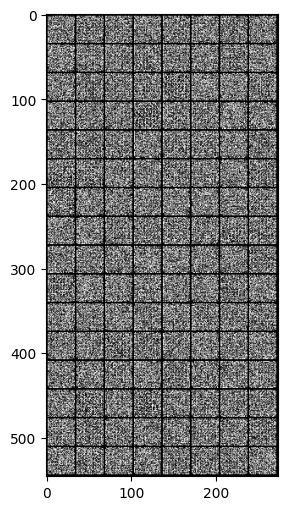

In [112]:
# visualize the output - at first it should just look like random noise!!
x_fake = G(z)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

## 2.2. The discriminator

The discriminator will be a mirror image of the generator.

The discriminator will also use a fully convolutional architecutre, with each block consisting of:
- Conv layer
- BatchNorm
- ReLU

Complete the function `get_downscaling_block` and then use it to define the following architecture for the discriminator:

Input: Image shaped `[n_batch, 1, 32, 32]` (in [-1, 1])
Output: Discriminator scores `[n_batch, 1]` in range [0, 1]

1. First downscaling block $\rightarrow$ `[n_batch, ndf, 16, 16]`
2. Second downscaling block $\rightarrow$ `[n_batch, ndf*2, 8, 8]`
3. Third downscaling block $\rightarrow$ `[n_batch, ndf*4, 4, 4]`
4. Last downscaling block $\rightarrow$ `[n_batch, 1]`

In [113]:
def get_downscaling_block(channels_in, channels_out, kernel, stride, padding, use_batch_norm=True, is_last=False):

    if is_last:
        return nn.Sequential(
            nn.Conv2d(channels_in, channels_out, kernel, stride, padding),
            nn.Sigmoid()
        )
    elif not use_batch_norm:
        return nn.Sequential(
            nn.Conv2d(channels_in, channels_out, kernel, stride, padding),
            nn.LeakyReLU(0.2, inplace=True)
        )
    else:
        return nn.Sequential(
            nn.Conv2d(channels_in, channels_out, kernel, stride, padding),
            nn.BatchNorm2d(channels_out),
            nn.LeakyReLU(0.2, inplace=True)
        )




class Discriminator(nn.Module):
    def __init__(self, ndf, nchannels=1):
        super().__init__()

        ###################
        #                 #
        # YOUR CODE HERE  #

        self.model = nn.Sequential(
            get_downscaling_block(nchannels, ndf, kernel=4, stride=2, padding=1, use_batch_norm=False),  # [n_batch, ndf, 16, 16]
            get_downscaling_block(ndf, ndf * 2, kernel=4, stride=2, padding=1),  # [n_batch, ndf*2, 8, 8]
            get_downscaling_block(ndf * 2, ndf * 4, kernel=4, stride=2, padding=1),  # [n_batch, ndf*4, 4, 4]
            get_downscaling_block(ndf * 4, 1, kernel=4, stride=1, padding=0, is_last=True)  # [n_batch, 1]
        )

        #                 #
        ###################

    def forward(self, x):
        return self.model(x).squeeze(1).squeeze(1) # remove spatial dimensions

### 2.2.3 Sanity Checking

In [114]:
real_batch, real_labels = next(iter(dataloader))

In [115]:
D = Discriminator(ndf=32, nchannels=1)
assert D(real_batch).shape == (real_batch.shape[0], 1)

# 3. Training

## 3.1 Loss
The essential thing to remember is that the logistic and the non-saturating logistic GAN losses can be written exclusively using the [binary cross entropy loss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html). Our GAN loss will be defined ONLY using the following criterion:



In [116]:
criterion = nn.BCELoss() # we will build off of this to make our final GAN loss!

## 3.2 Helper functions

We will need a few helper functions.
1. First, we need to continuously sample z from a Gaussian distribution.
2. Secondly, we need to make our "ground-truth" labels when using the BCE loss. This should output vectors of either 0s or 1s.

In [117]:
def sample_z(batch_size, nz):
    return torch.randn(batch_size, nz, device=device)

# this is for the real ground-truth label
def get_labels_one(batch_size):
    r = torch.ones(batch_size, 1)
    return r.to(device)

# this is for the generated ground-truth label
def get_labels_zero(batch_size):
    r = torch.zeros(batch_size, 1)
    return r.to(device)


# To initialize the weights of a GAN, the DCGAN paper found that best results are obtained
# with Gaussian initialization with mean=0; std=0.02
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


# for visualization
to_pil = transforms.ToPILImage()
renorm = transforms.Normalize((-1.), (2.))

## 3.3 Creating the optimizers and hyperparameters

The original DCGAN paper shows that Adam works well in the generator and the discriminator with a learning rate of 0.0002 and Beta1 = 0.5.

Define your optimizers

In [118]:
nz = 1000
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))


## 3.3 Training!

Now for the fun part, training!
Training a GAN consists in making an update to the discriminator, then the generator.
Training a GAN requires BABYSITTING!! Remember that many things can go wrong when training a GAN:
- The discriminator is too strong for the generator - the generator cannot improve.
- The generator easily fools the discriminator - cannot learn.
- Mode collapse - generator is not capable of generating diverse images.

it: 0; g_loss: 1.6963741779327393; d_loss: 1.3471415042877197; avg_real_score: 0.45935380458831787; avg_fake_score: 0.4091337323188782: : 0it [00:00, ?it/s]

generated images


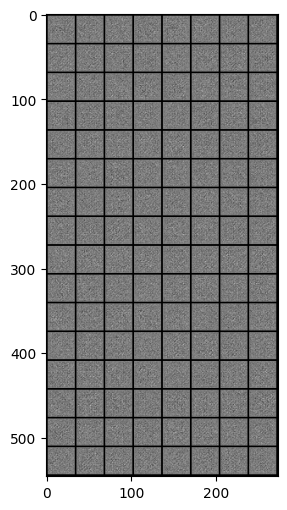

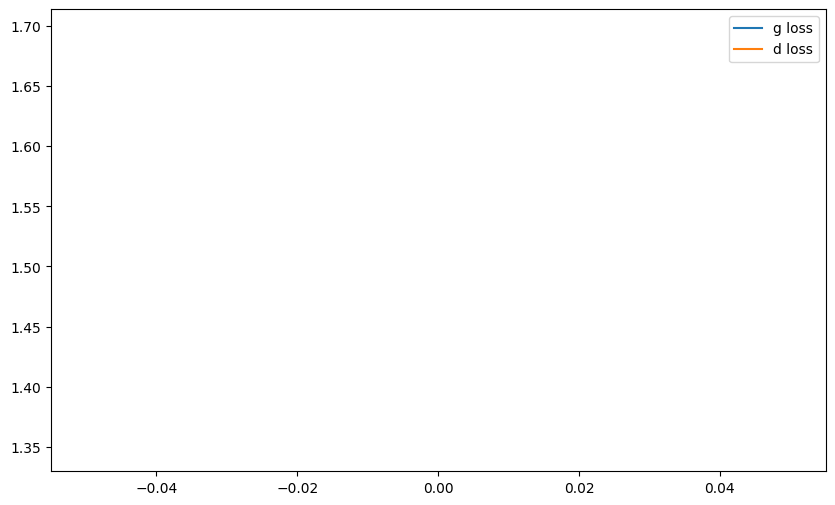

it: 200; g_loss: 1.4468402862548828; d_loss: 0.7911703586578369; avg_real_score: 0.6834479570388794; avg_fake_score: 0.30323702096939087: : 199it [00:14, 15.50it/s]  

generated images


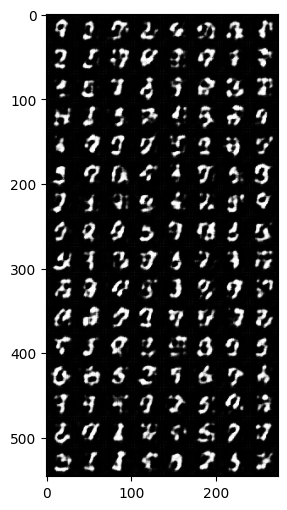

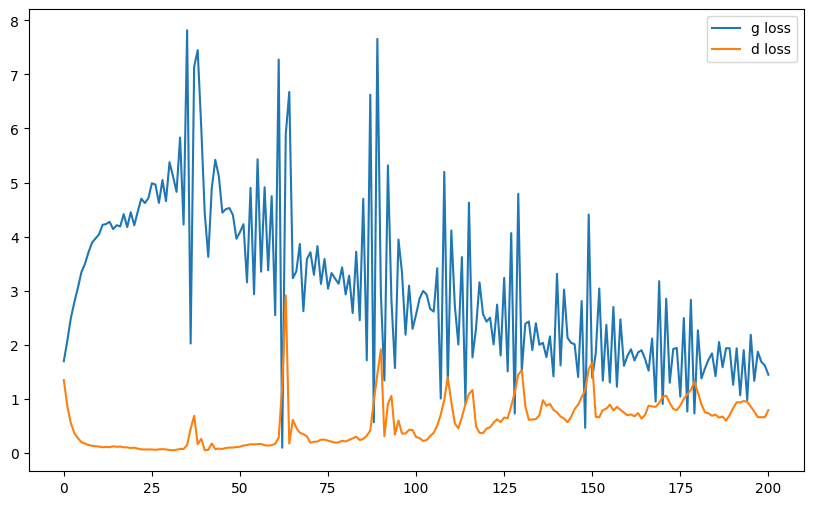

it: 400; g_loss: 0.7777283787727356; d_loss: 1.0304348468780518; avg_real_score: 0.48025479912757874; avg_fake_score: 0.22029359638690948: : 399it [00:27, 15.27it/s] 

generated images


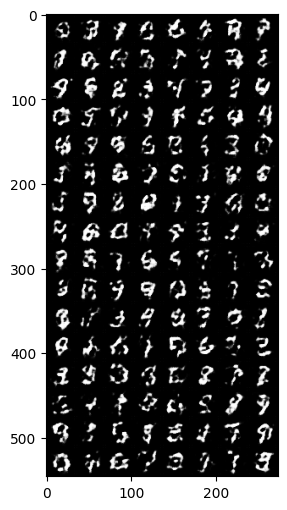

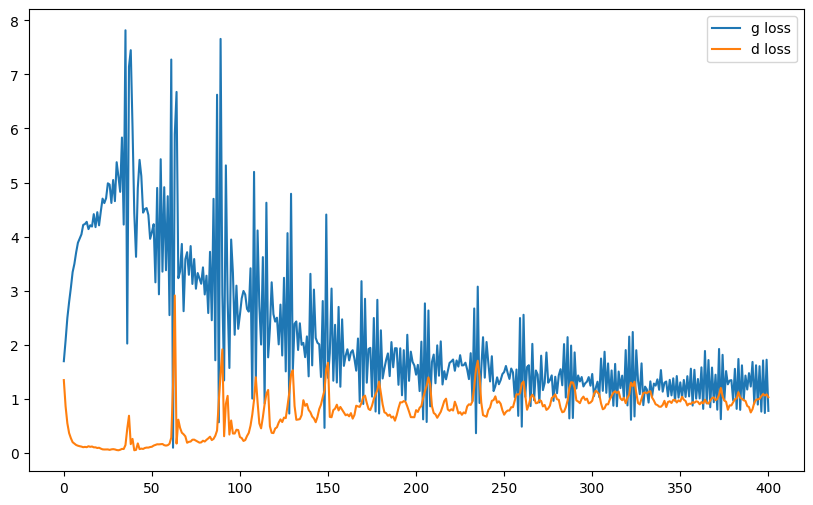

it: 468; g_loss: 1.4821327924728394; d_loss: 0.9269102811813354; avg_real_score: 0.685884952545166; avg_fake_score: 0.3997012972831726: : 469it [00:32, 14.24it/s]   
it: 469; g_loss: 1.091707706451416; d_loss: 0.898827075958252; avg_real_score: 0.5930782556533813; avg_fake_score: 0.28778719902038574: : 0it [00:00, ?it/s]

generated images


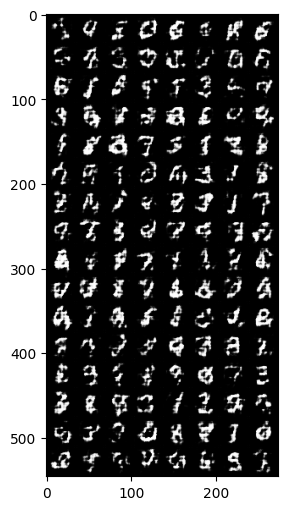

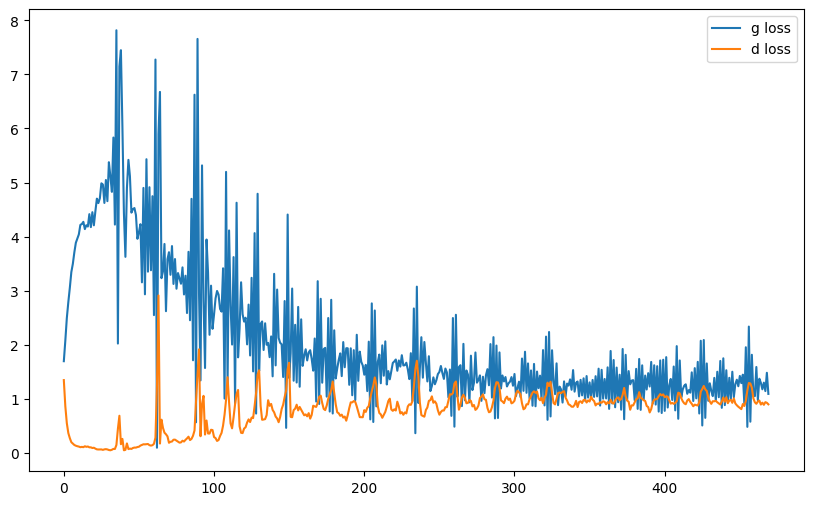

it: 669; g_loss: 1.5822656154632568; d_loss: 0.9716029167175293; avg_real_score: 0.7684705257415771; avg_fake_score: 0.48804306983947754: : 199it [00:16, 12.21it/s] 

generated images


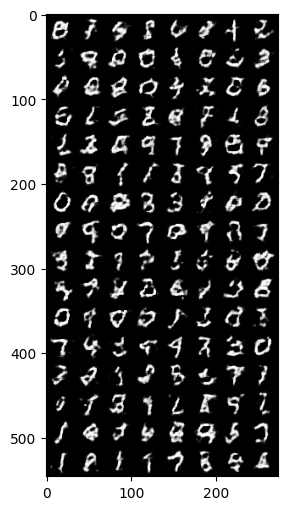

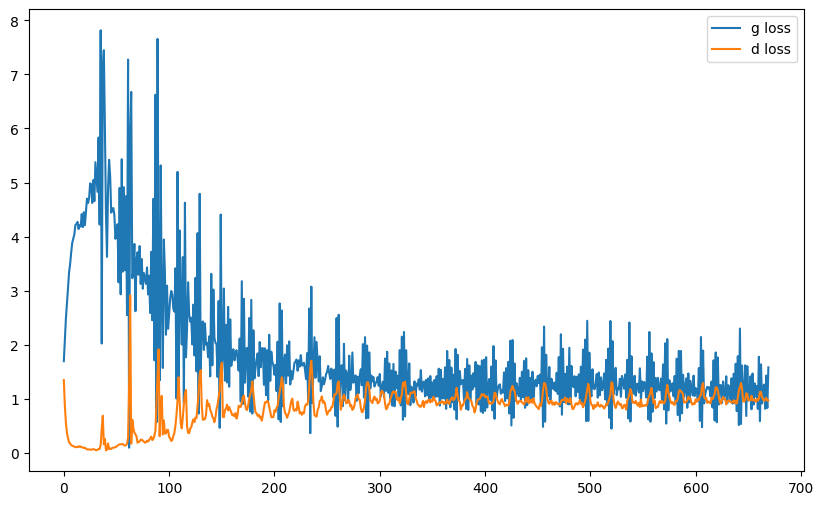

it: 869; g_loss: 1.7651052474975586; d_loss: 1.3613287210464478; avg_real_score: 0.8727851510047913; avg_fake_score: 0.6877422332763672: : 399it [00:30, 15.43it/s]  

generated images


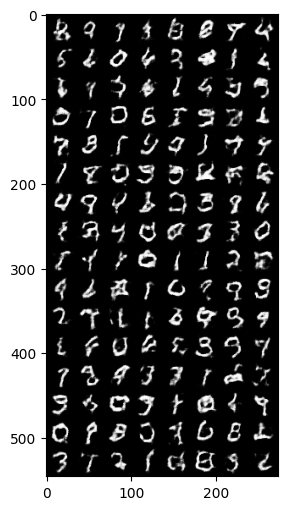

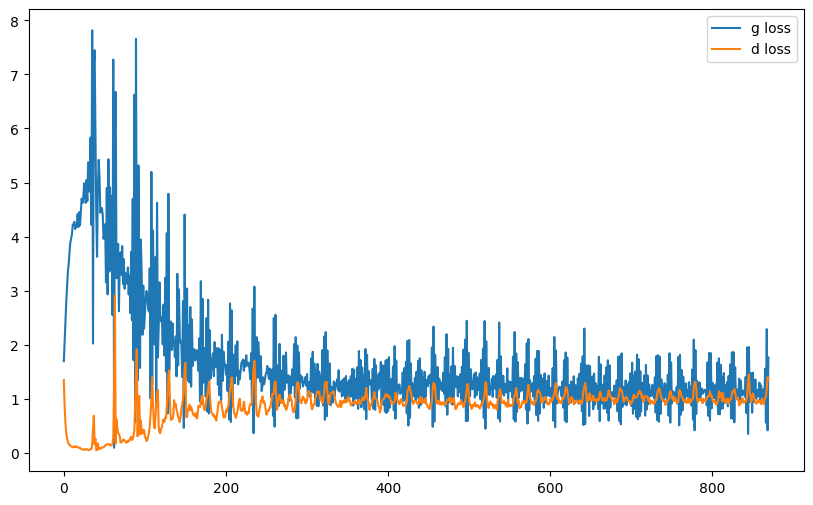

it: 937; g_loss: 0.9334063529968262; d_loss: 0.9559817314147949; avg_real_score: 0.57717365026474; avg_fake_score: 0.3080255687236786: : 469it [00:35, 13.07it/s]    
it: 938; g_loss: 1.5106287002563477; d_loss: 1.028078556060791; avg_real_score: 0.6966467499732971; avg_fake_score: 0.45539146661758423: : 0it [00:00, ?it/s]

generated images


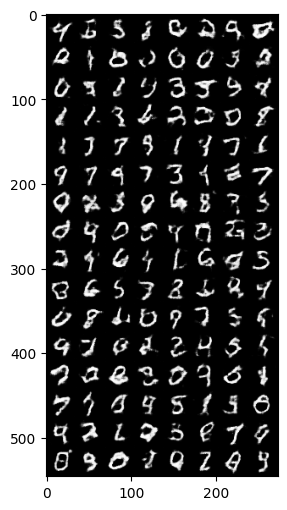

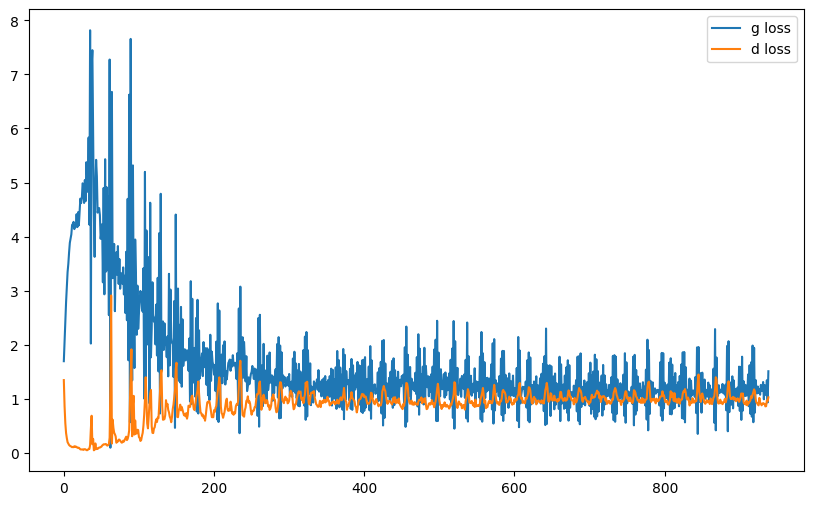

it: 1138; g_loss: 2.2714719772338867; d_loss: 1.0699955224990845; avg_real_score: 0.8323022127151489; avg_fake_score: 0.5659515857696533: : 199it [00:14, 13.58it/s]   

generated images


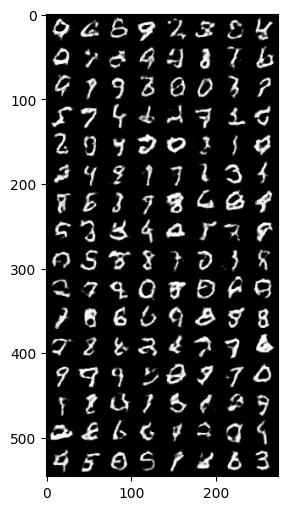

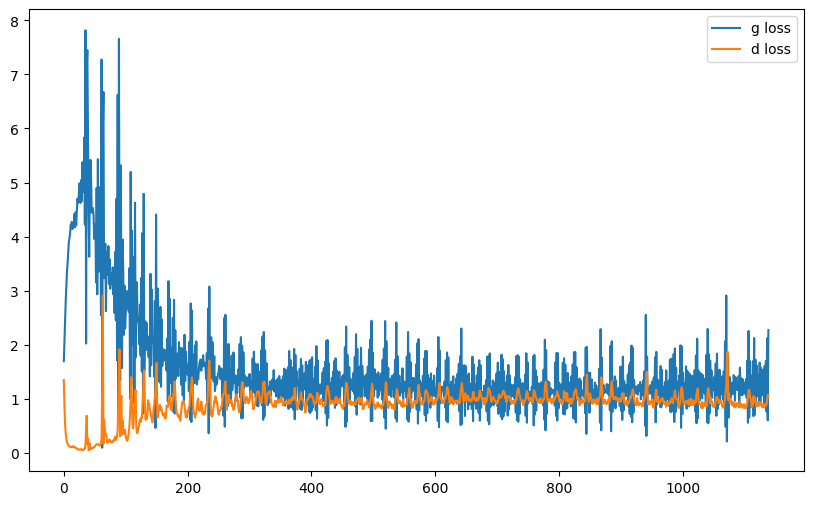

it: 1338; g_loss: 1.3277915716171265; d_loss: 0.9180728793144226; avg_real_score: 0.7310760021209717; avg_fake_score: 0.43292316794395447: : 399it [00:27, 14.85it/s]   

generated images


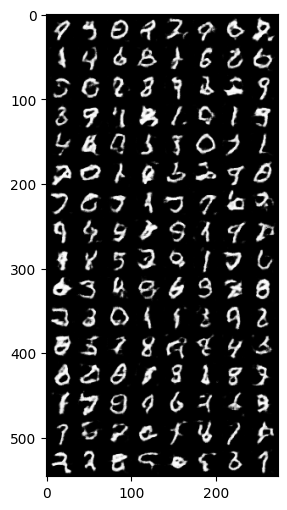

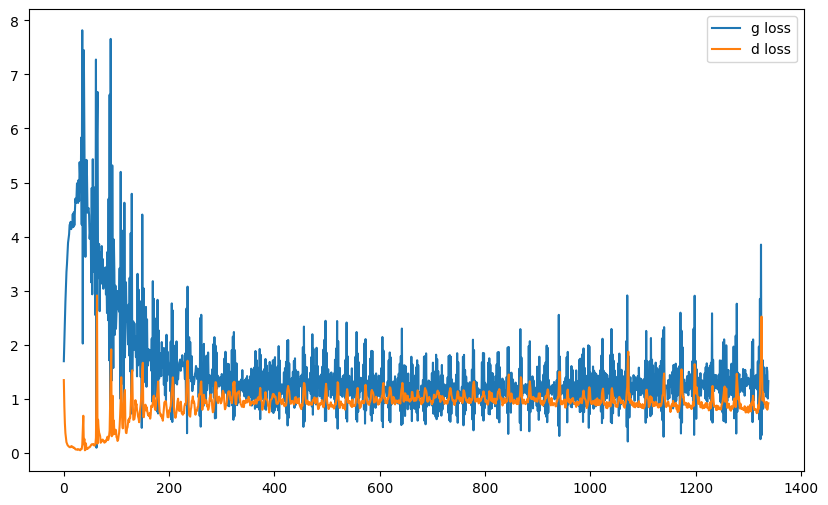

it: 1406; g_loss: 1.4927382469177246; d_loss: 0.734768271446228; avg_real_score: 0.7371038198471069; avg_fake_score: 0.3307291269302368: : 469it [00:33, 14.03it/s]    
it: 1407; g_loss: 1.1820319890975952; d_loss: 0.810829758644104; avg_real_score: 0.6387486457824707; avg_fake_score: 0.2791934609413147: : 0it [00:00, ?it/s]

generated images


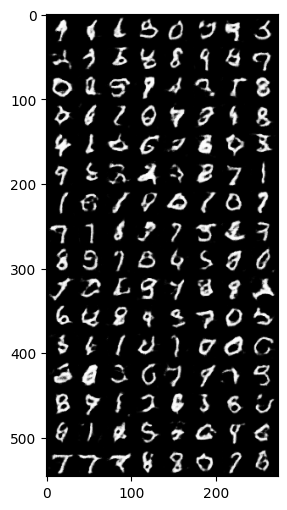

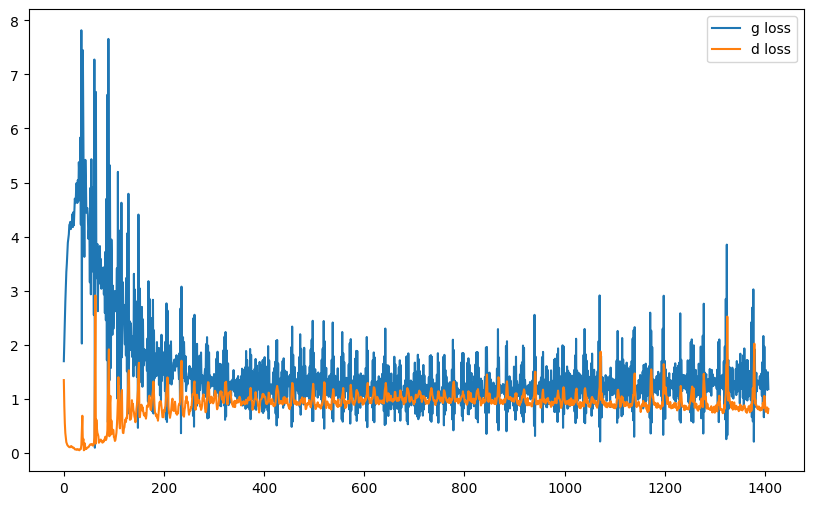

it: 1607; g_loss: 1.8193281888961792; d_loss: 0.6438453197479248; avg_real_score: 0.7627238035202026; avg_fake_score: 0.29529425501823425: : 200it [00:16, 15.30it/s]  

generated images


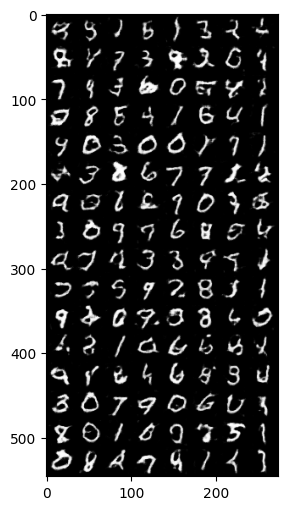

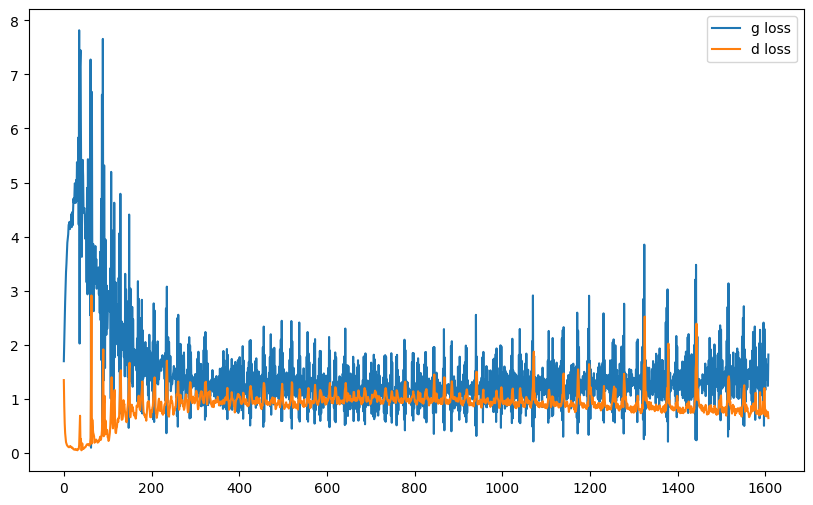

it: 1807; g_loss: 1.675093650817871; d_loss: 0.6471772193908691; avg_real_score: 0.6970585584640503; avg_fake_score: 0.22689881920814514: : 400it [00:31, 13.73it/s]   

generated images


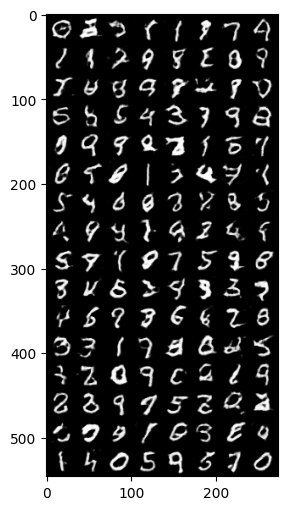

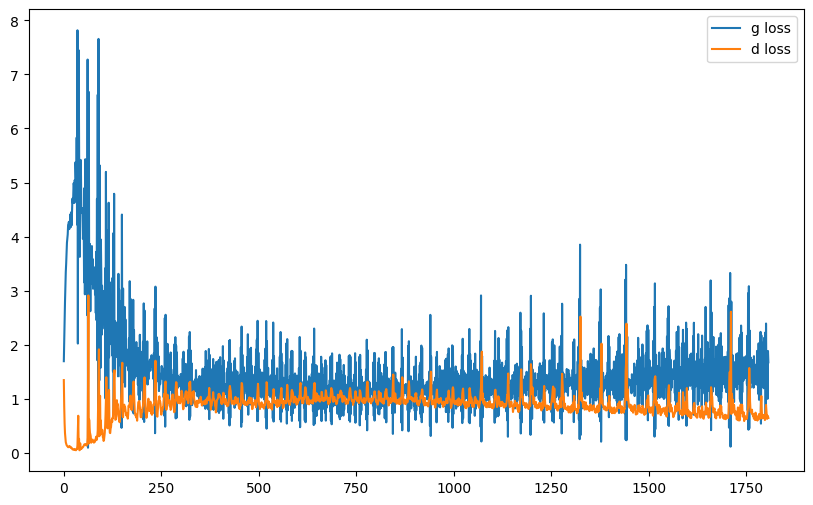

it: 1875; g_loss: 0.49922722578048706; d_loss: 0.8712225556373596; avg_real_score: 0.5070728659629822; avg_fake_score: 0.12073224782943726: : 469it [00:36, 12.72it/s]
it: 1876; g_loss: 2.713569164276123; d_loss: 1.3739032745361328; avg_real_score: 0.9458848237991333; avg_fake_score: 0.703522801399231: : 0it [00:00, ?it/s]

generated images


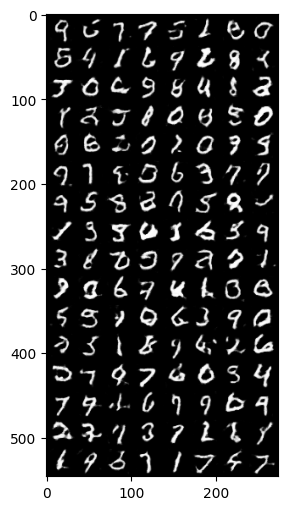

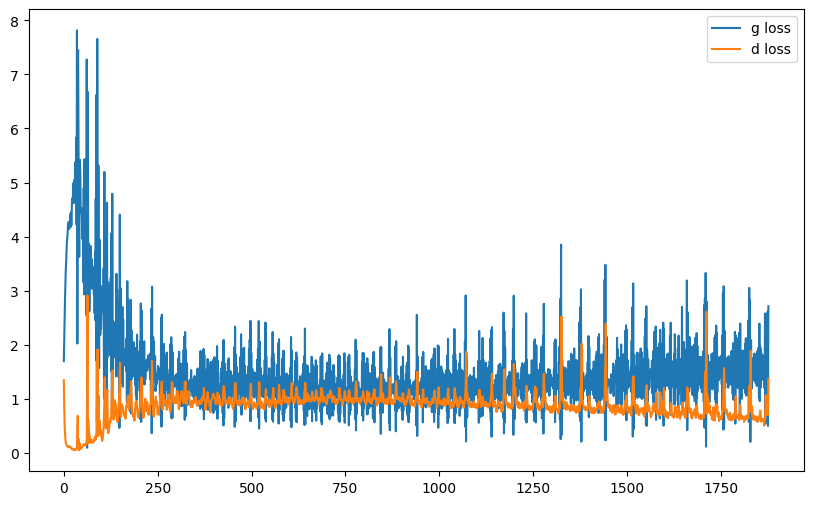

it: 2076; g_loss: 1.8814935684204102; d_loss: 0.501036524772644; avg_real_score: 0.8274984955787659; avg_fake_score: 0.2504176199436188: : 199it [00:14, 13.79it/s]   

generated images


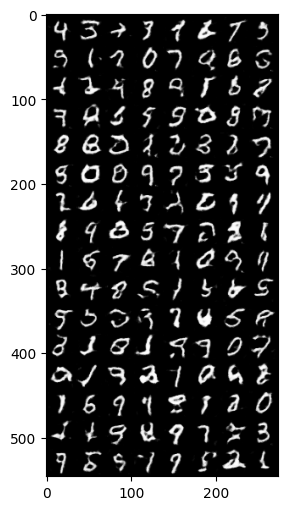

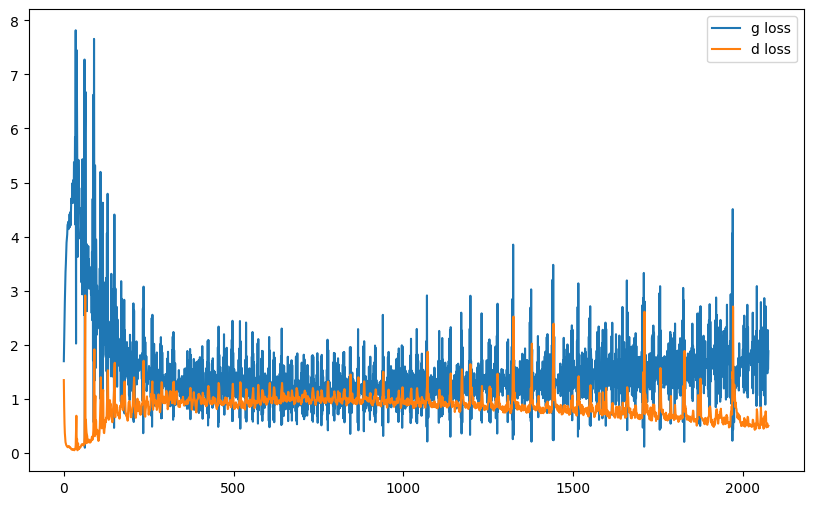

it: 2276; g_loss: 2.208991289138794; d_loss: 0.3705054521560669; avg_real_score: 0.904289960861206; avg_fake_score: 0.22474297881126404: : 399it [00:31, 12.71it/s]   

generated images


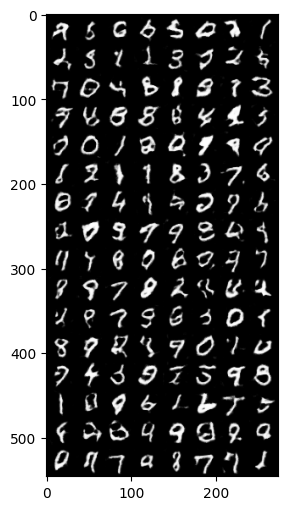

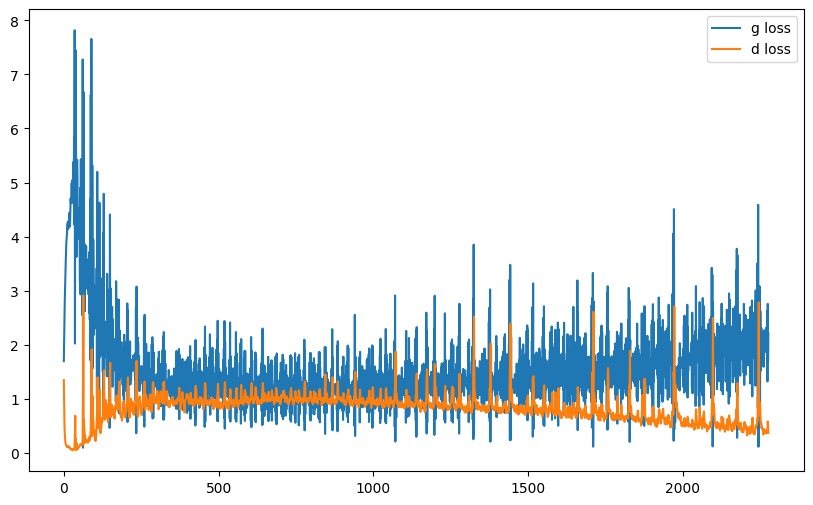

it: 2344; g_loss: 2.1983585357666016; d_loss: 0.3388098478317261; avg_real_score: 0.8139433860778809; avg_fake_score: 0.11318336427211761: : 469it [00:36, 12.75it/s]  


In [119]:
nb_epochs = 5

g_losses = []
d_losses = []


j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]


        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################

        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)
        real_labels = get_labels_one(cur_batch_size)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im.detach())  # detach to avoid gradients affecting the generator
        fake_labels = get_labels_zero(cur_batch_size)


        ###
        ### Discriminator
        ###

        d_loss = criterion(yhat_real, real_labels) + criterion(yhat_fake, fake_labels)#     YOUR CODE HERE
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()


        ###
        ### Generator
        ###


        g_loss = criterion(netD(fake_im), real_labels)#      YOUR CODE HERE
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()



        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            #fake_im = G(z_test)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

## 3.4 Experiments

### More epoches

it: 0; g_loss: 1.6621081829071045; d_loss: 1.420445203781128; avg_real_score: 0.447096049785614; avg_fake_score: 0.4426645040512085: : 0it [00:00, ?it/s]

generated images


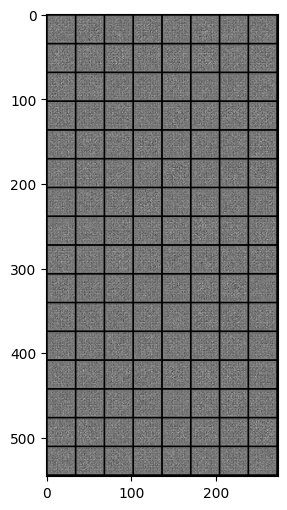

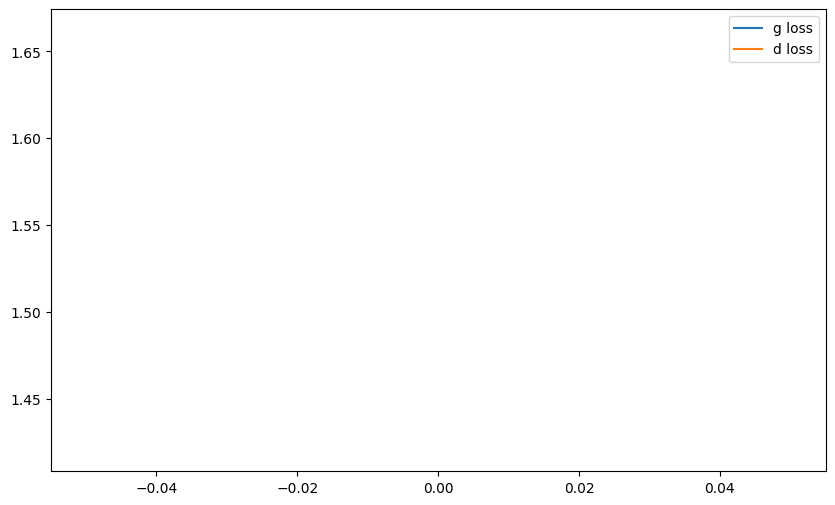

it: 200; g_loss: 1.0644205808639526; d_loss: 1.1763758659362793; avg_real_score: 0.49342820048332214; avg_fake_score: 0.33035868406295776: : 200it [00:12, 19.18it/s] 

generated images


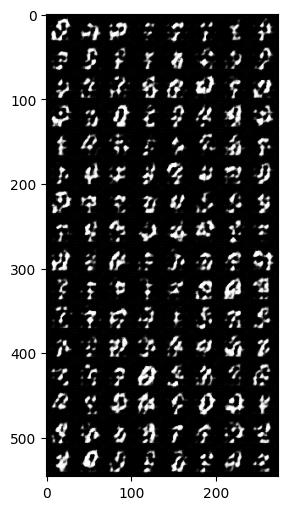

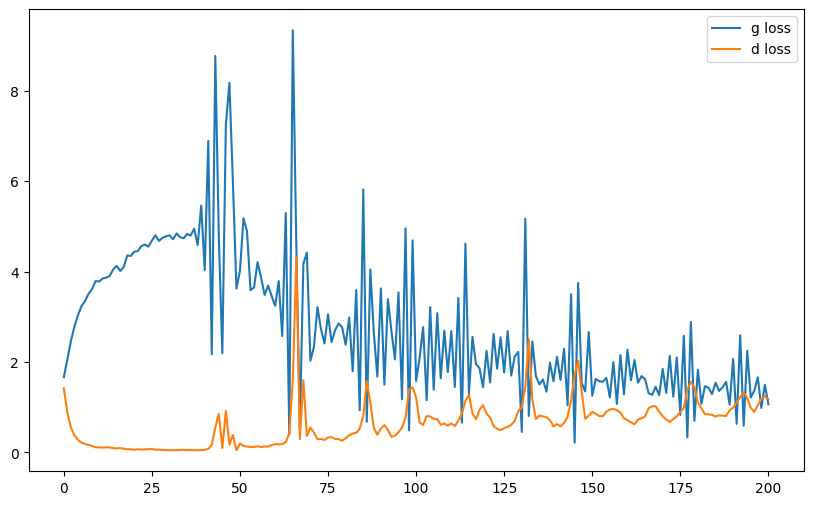

it: 400; g_loss: 0.43622511625289917; d_loss: 1.2586098909378052; avg_real_score: 0.3571975529193878; avg_fake_score: 0.1742381453514099: : 400it [00:23, 18.70it/s] 

generated images


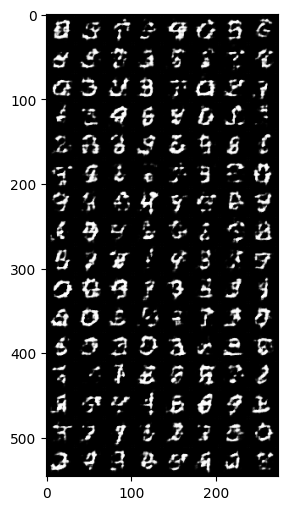

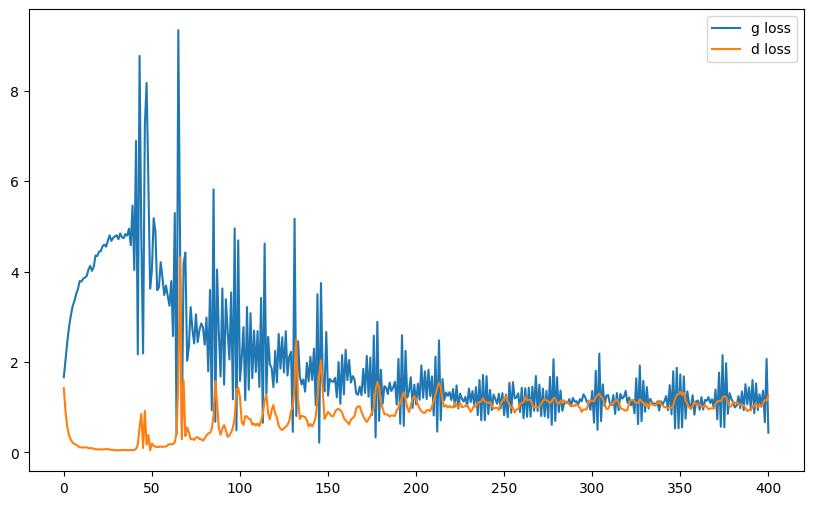

it: 468; g_loss: 1.0089181661605835; d_loss: 0.9674471616744995; avg_real_score: 0.5970886945724487; avg_fake_score: 0.3380618095397949: : 469it [00:27, 16.92it/s]  
it: 469; g_loss: 1.4121733903884888; d_loss: 1.0399014949798584; avg_real_score: 0.6627424955368042; avg_fake_score: 0.44894200563430786: : 0it [00:00, ?it/s]

generated images


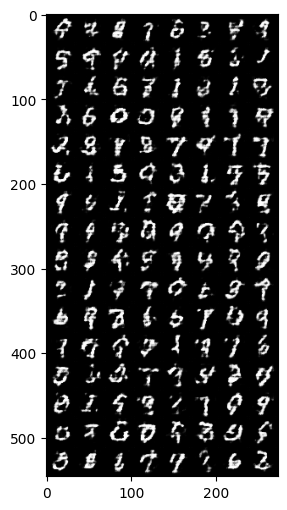

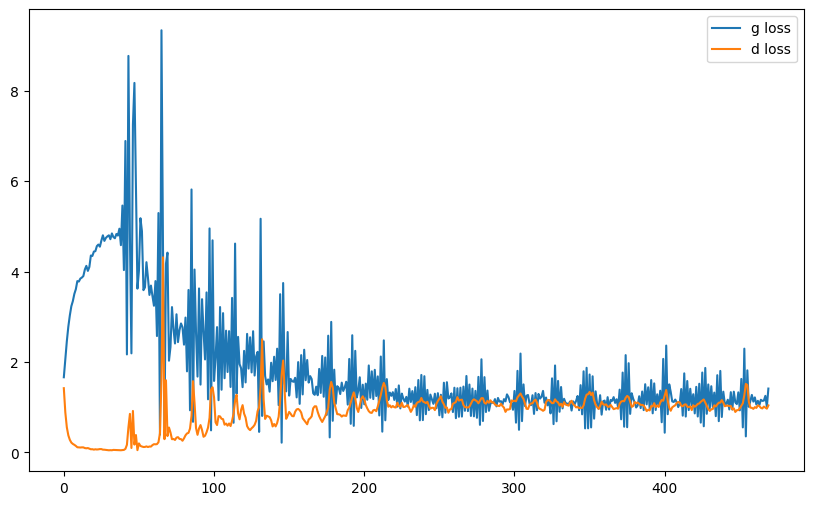

it: 669; g_loss: 1.217572569847107; d_loss: 1.1002365350723267; avg_real_score: 0.6705446243286133; avg_fake_score: 0.4905187487602234: : 200it [00:11, 18.71it/s]    

generated images


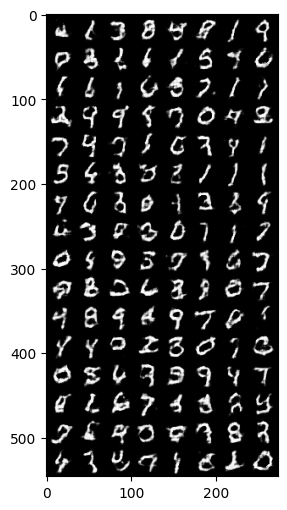

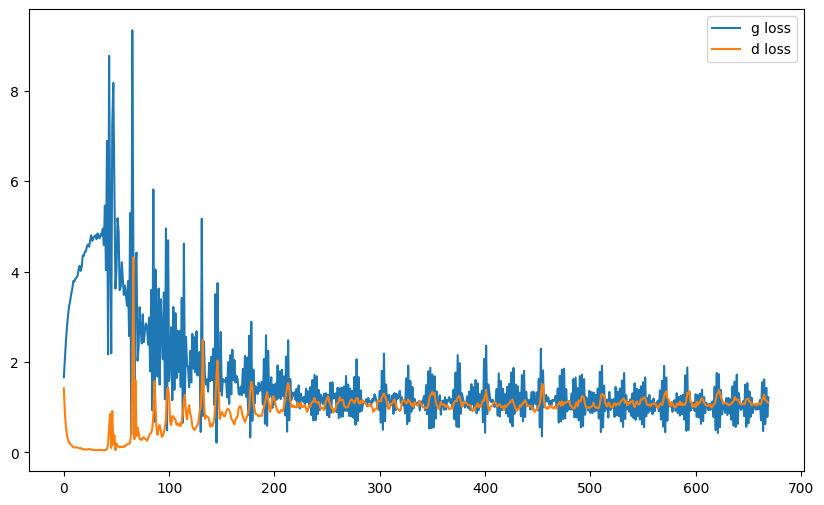

it: 869; g_loss: 1.305511236190796; d_loss: 1.0464004278182983; avg_real_score: 0.6960826516151428; avg_fake_score: 0.48260462284088135: : 400it [00:23, 17.98it/s]   

generated images


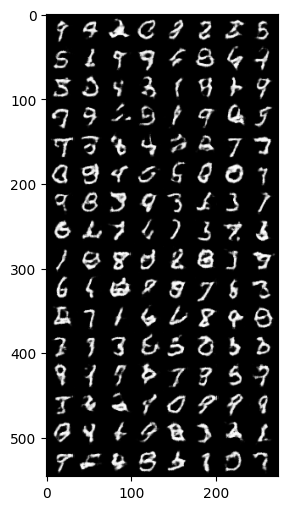

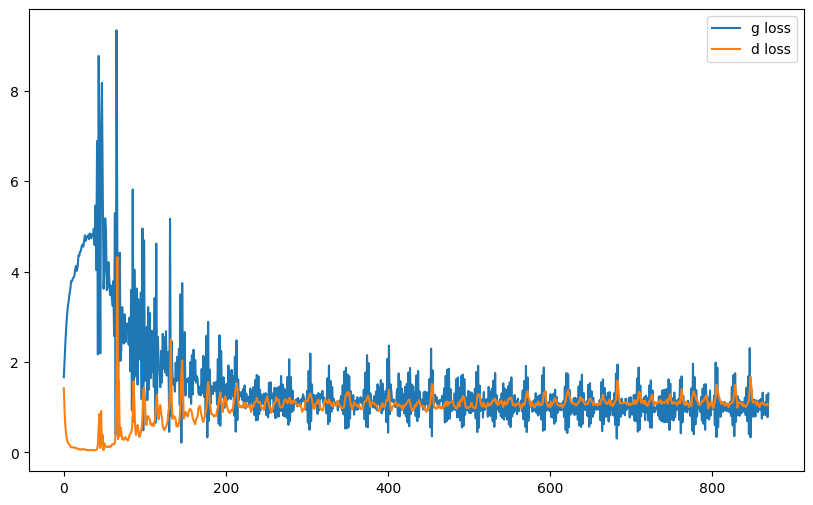

it: 937; g_loss: 2.1591649055480957; d_loss: 1.2357605695724487; avg_real_score: 0.8161420822143555; avg_fake_score: 0.6298571825027466: : 469it [00:28, 16.18it/s]  
it: 938; g_loss: 0.36120033264160156; d_loss: 1.3841114044189453; avg_real_score: 0.31754496693611145; avg_fake_score: 0.16323667764663696: : 0it [00:00, ?it/s]

generated images


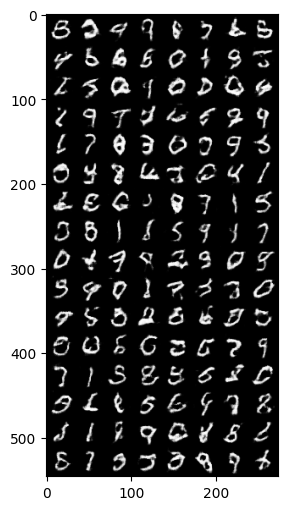

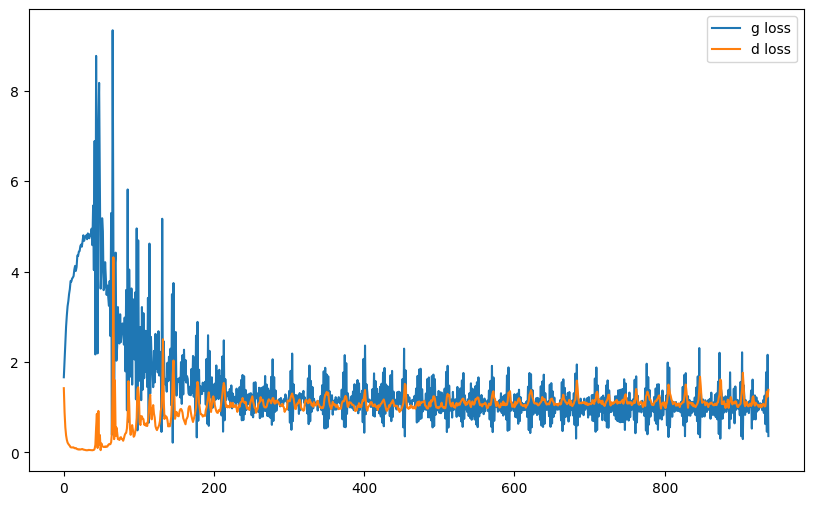

it: 1138; g_loss: 1.2083687782287598; d_loss: 1.1288304328918457; avg_real_score: 0.6691256761550903; avg_fake_score: 0.5016160011291504: : 199it [00:11, 17.39it/s]  

generated images


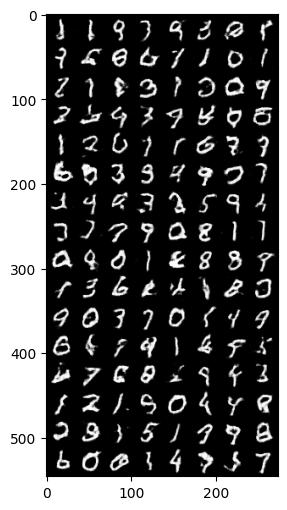

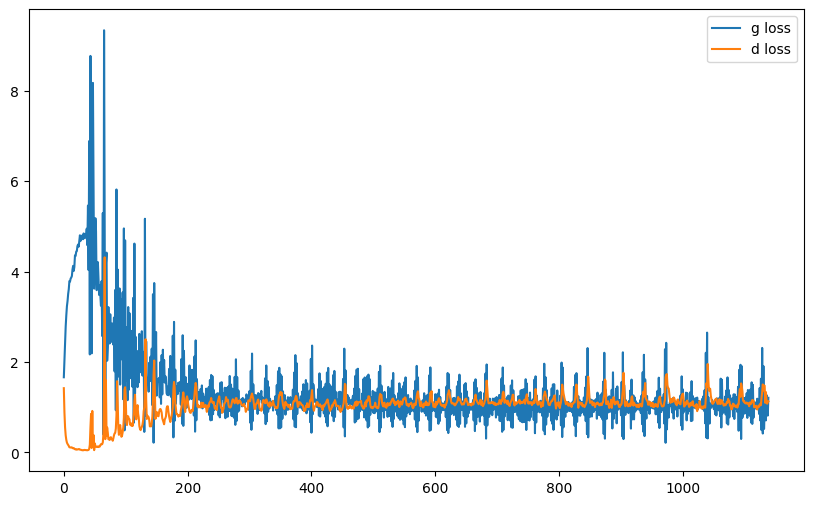

it: 1338; g_loss: 1.4351710081100464; d_loss: 0.9848302006721497; avg_real_score: 0.7273570895195007; avg_fake_score: 0.47239920496940613: : 399it [00:23, 18.94it/s]  

generated images


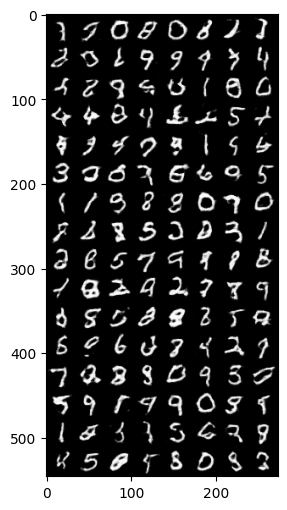

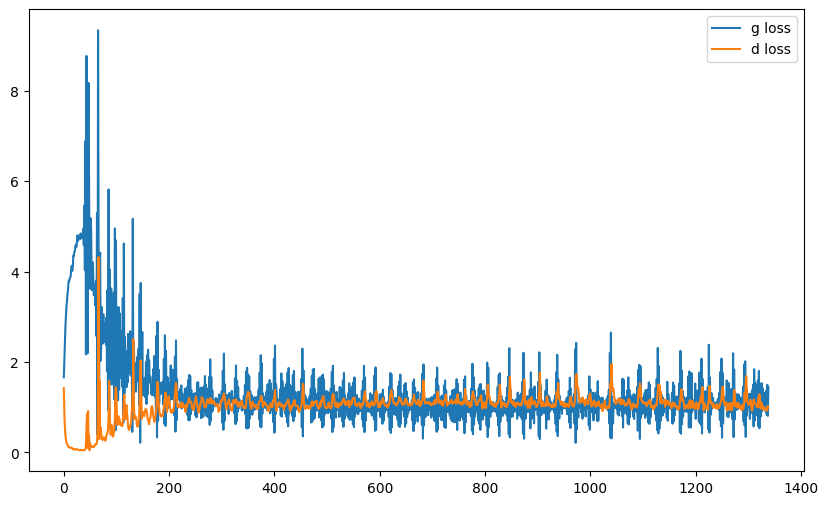

it: 1406; g_loss: 0.6277772188186646; d_loss: 1.2182376384735107; avg_real_score: 0.4233354926109314; avg_fake_score: 0.2724226117134094: : 469it [00:27, 16.96it/s]  
it: 1407; g_loss: 1.4144482612609863; d_loss: 1.0965847969055176; avg_real_score: 0.7663682699203491; avg_fake_score: 0.5492548942565918: : 0it [00:00, ?it/s]

generated images


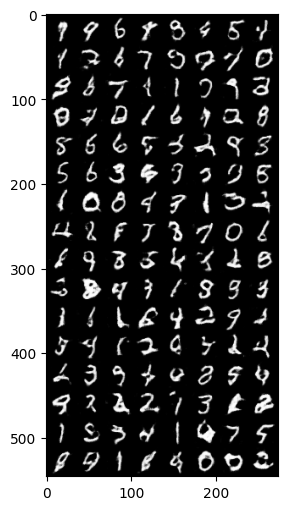

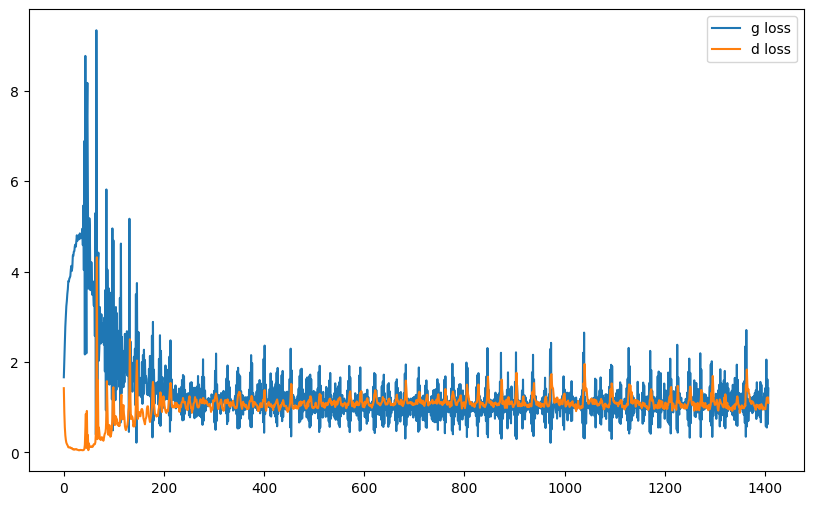

it: 1607; g_loss: 1.6567586660385132; d_loss: 0.8959648013114929; avg_real_score: 0.7559663653373718; avg_fake_score: 0.44656044244766235: : 200it [00:11, 18.11it/s] 

generated images


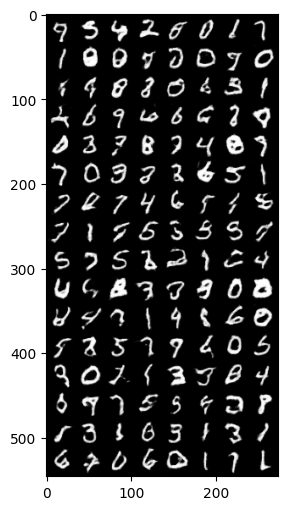

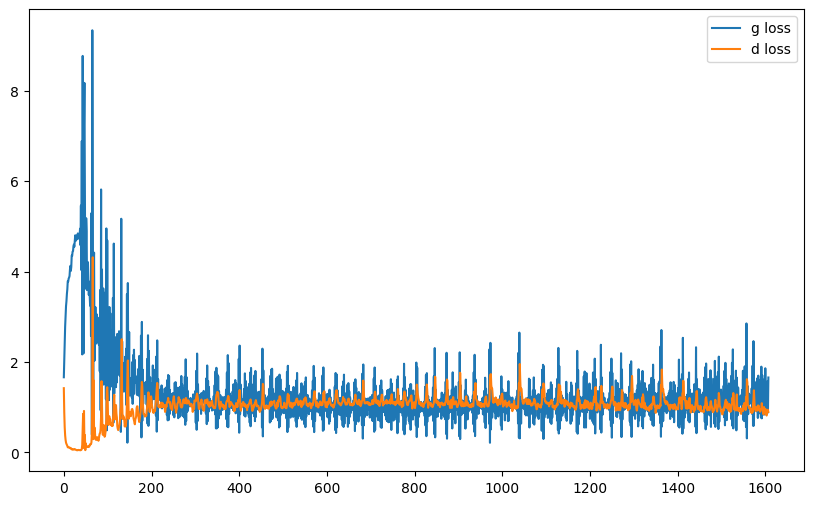

it: 1807; g_loss: 1.069142460823059; d_loss: 1.0133278369903564; avg_real_score: 0.5774281024932861; avg_fake_score: 0.3472994565963745: : 400it [00:22, 19.16it/s]    

generated images


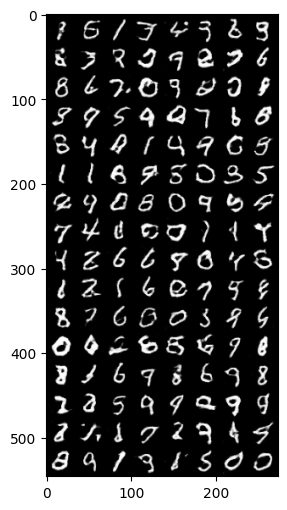

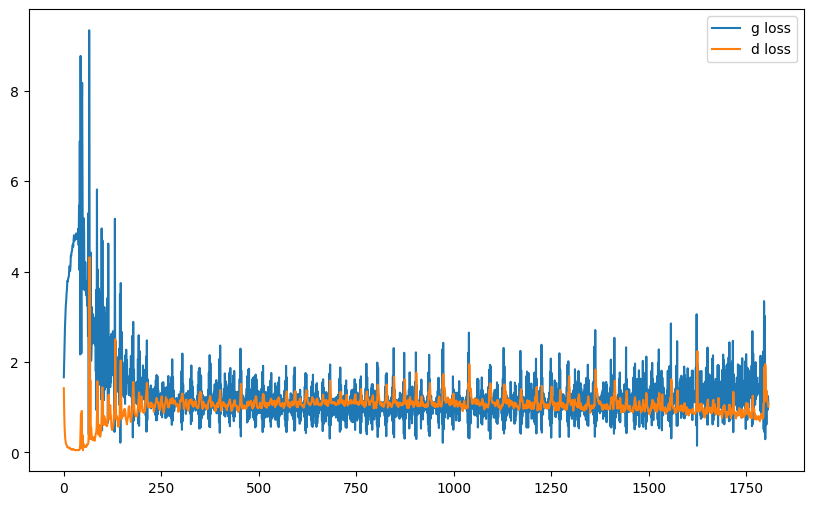

it: 1875; g_loss: 1.4473861455917358; d_loss: 0.7695976495742798; avg_real_score: 0.6445807814598083; avg_fake_score: 0.2641621232032776: : 469it [00:26, 17.42it/s] 
it: 1876; g_loss: 1.3150897026062012; d_loss: 0.7670174837112427; avg_real_score: 0.6766548156738281; avg_fake_score: 0.2933245599269867: : 0it [00:00, ?it/s]

generated images


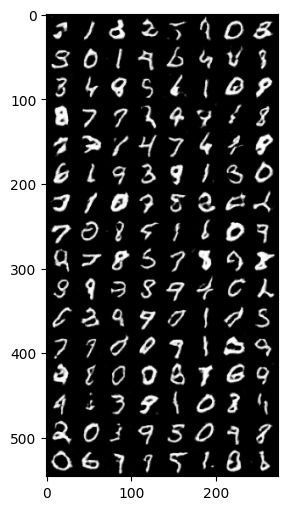

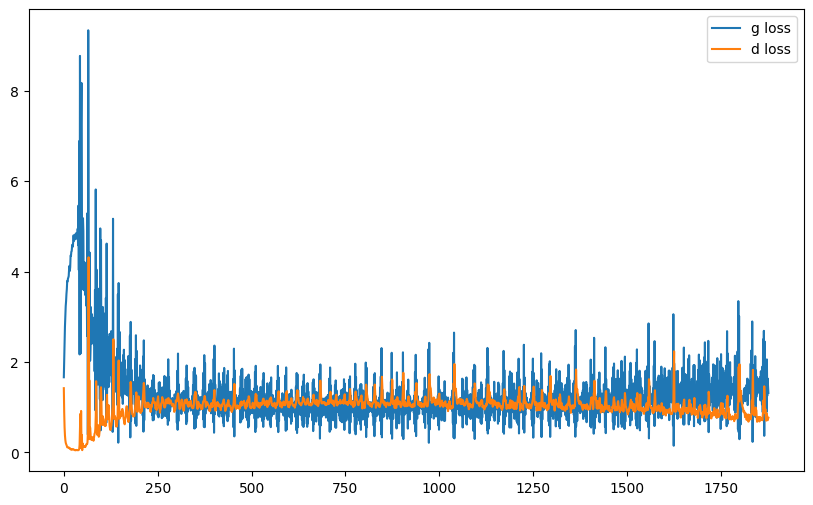

it: 2076; g_loss: 1.0400618314743042; d_loss: 0.7149240374565125; avg_real_score: 0.6022524833679199; avg_fake_score: 0.1656254529953003: : 200it [00:13, 12.44it/s]    

generated images


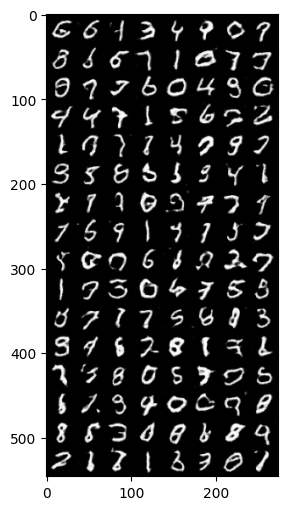

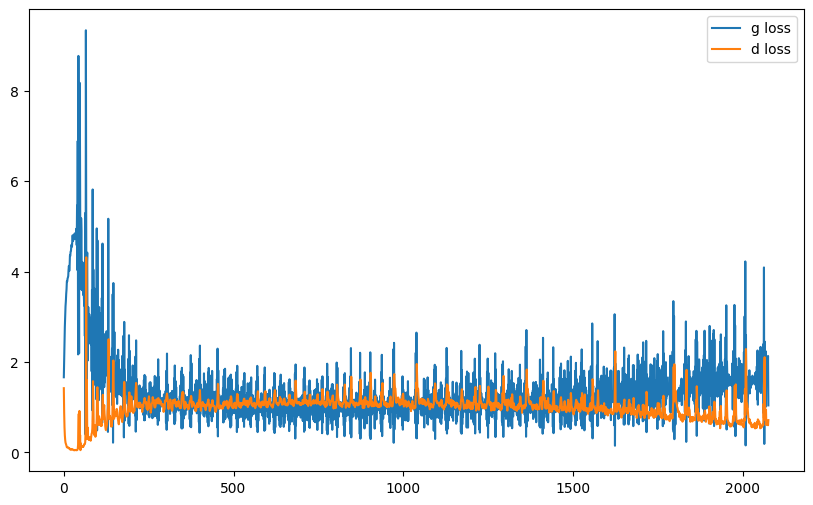

it: 2276; g_loss: 1.8846731185913086; d_loss: 0.42214423418045044; avg_real_score: 0.8232382535934448; avg_fake_score: 0.19243505597114563: : 399it [00:31, 11.46it/s] 

generated images


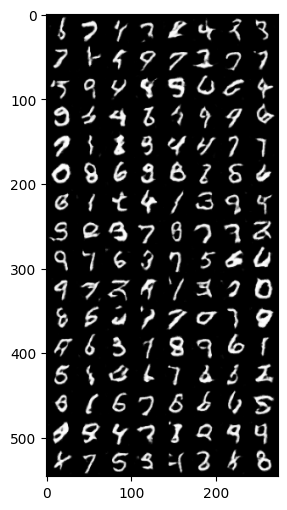

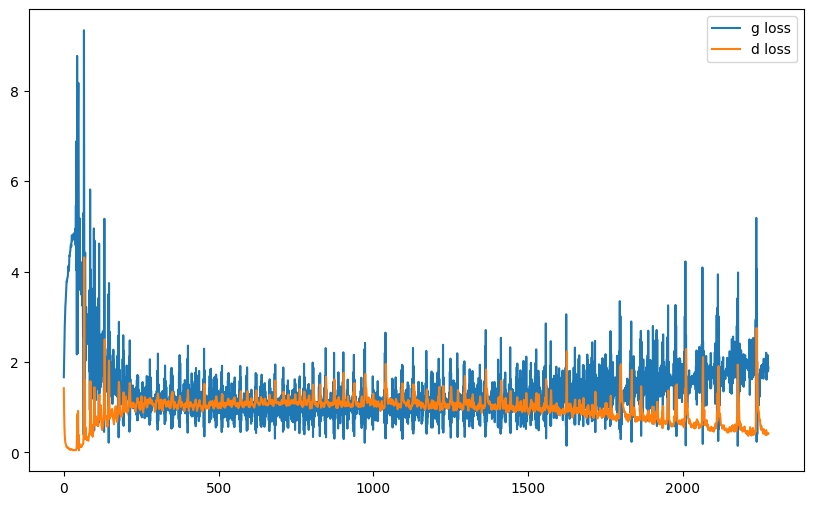

it: 2344; g_loss: 2.4031224250793457; d_loss: 0.46438276767730713; avg_real_score: 0.8994741439819336; avg_fake_score: 0.2903234660625458: : 469it [00:37, 12.49it/s]  
it: 2345; g_loss: 2.1403884887695312; d_loss: 0.39469850063323975; avg_real_score: 0.7862840890884399; avg_fake_score: 0.1313352733850479: : 0it [00:00, ?it/s]

generated images


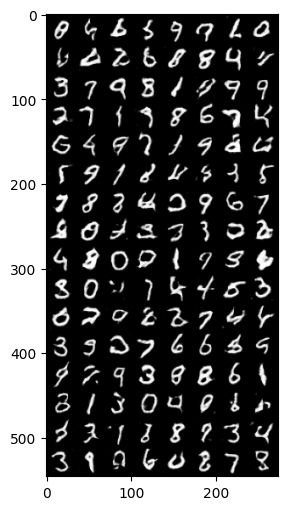

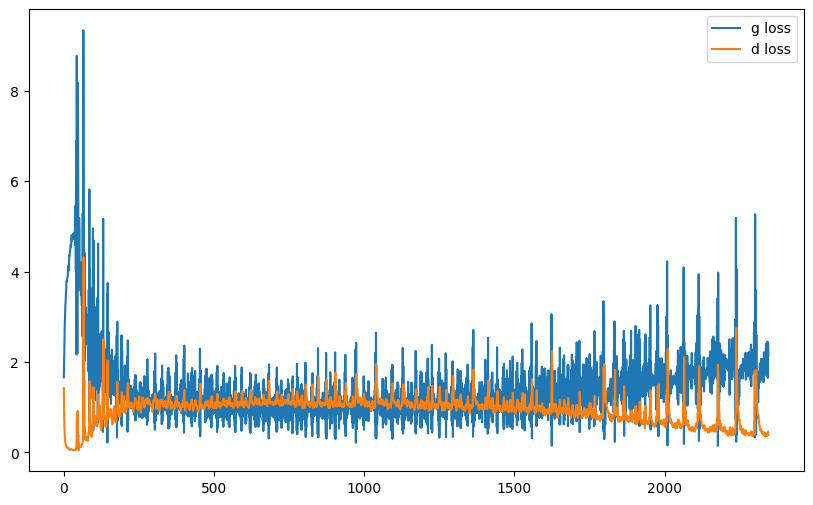

it: 2545; g_loss: 1.4929919242858887; d_loss: 0.3524554669857025; avg_real_score: 0.7856722474098206; avg_fake_score: 0.09591624140739441: : 200it [00:15, 16.76it/s]  

generated images


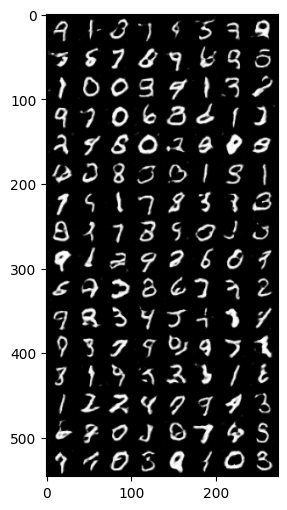

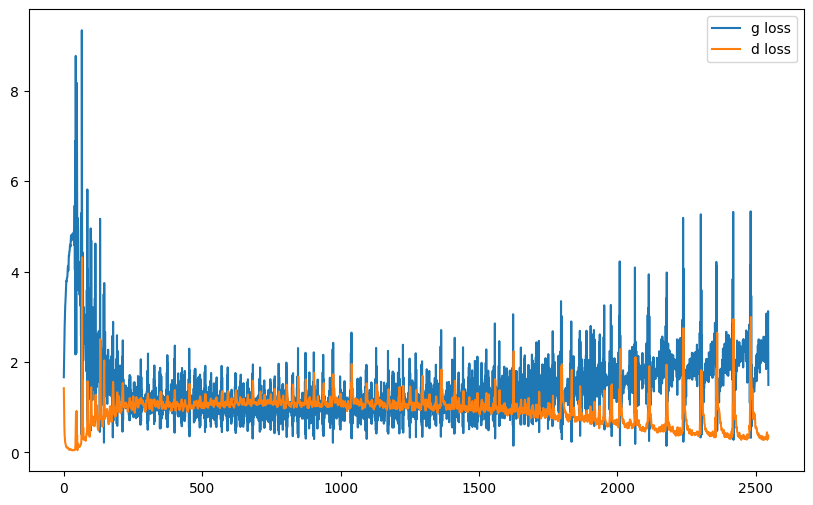

it: 2745; g_loss: 0.5842066407203674; d_loss: 0.9814608097076416; avg_real_score: 0.7437425851821899; avg_fake_score: 0.4346848130226135: : 400it [00:27, 16.33it/s]   

generated images


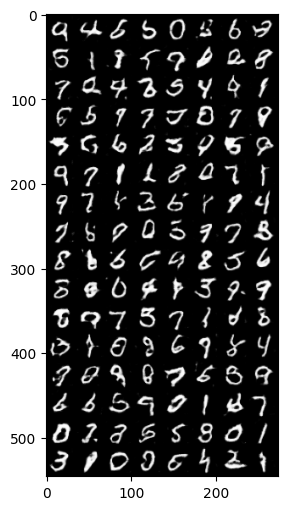

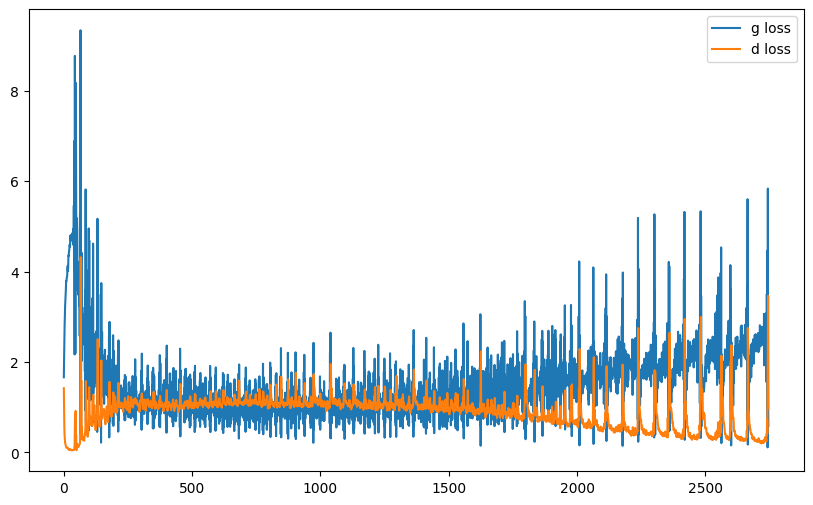

it: 2813; g_loss: 0.10454531013965607; d_loss: 2.979058265686035; avg_real_score: 0.06954589486122131; avg_fake_score: 0.012864063493907452: : 469it [00:32, 14.32it/s]
it: 2814; g_loss: 2.694150924682617; d_loss: 2.79504656791687; avg_real_score: 0.9882206320762634; avg_fake_score: 0.9211832284927368: : 0it [00:00, ?it/s]

generated images


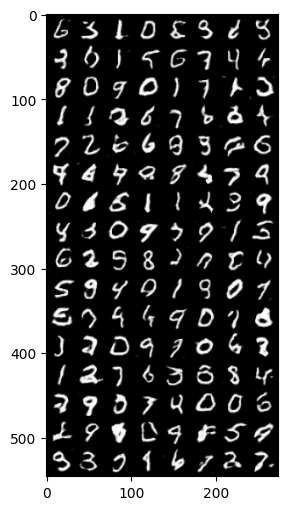

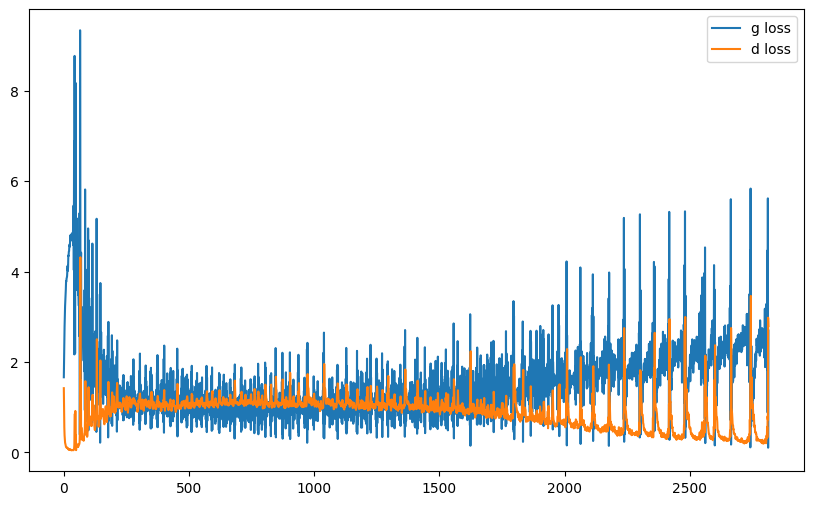

it: 3014; g_loss: 0.8547315001487732; d_loss: 1.3483989238739014; avg_real_score: 0.4514746069908142; avg_fake_score: 0.3621059060096741: : 199it [00:12, 16.52it/s]    

generated images


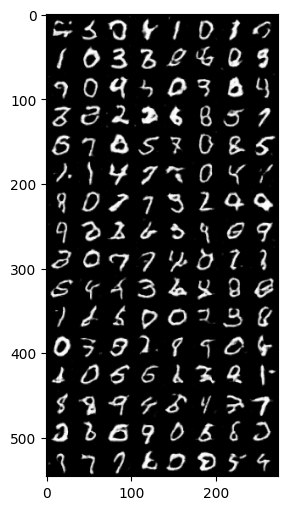

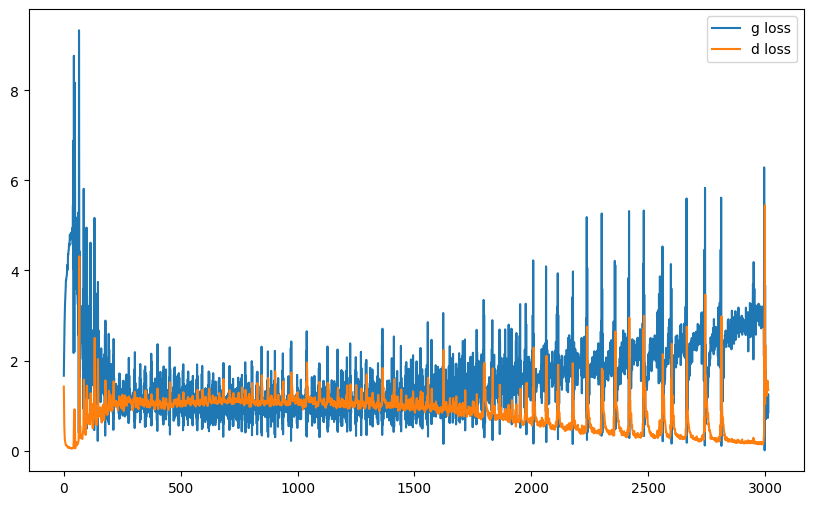

it: 3214; g_loss: 2.7095274925231934; d_loss: 0.21229363977909088; avg_real_score: 0.9020864963531494; avg_fake_score: 0.0981006994843483: : 399it [00:25, 17.01it/s]   

generated images


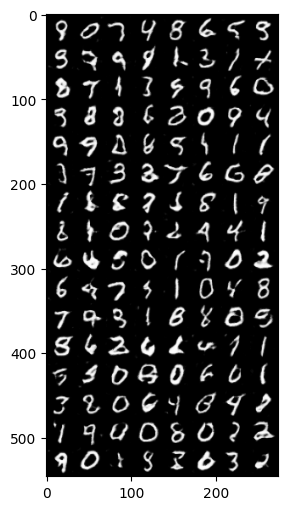

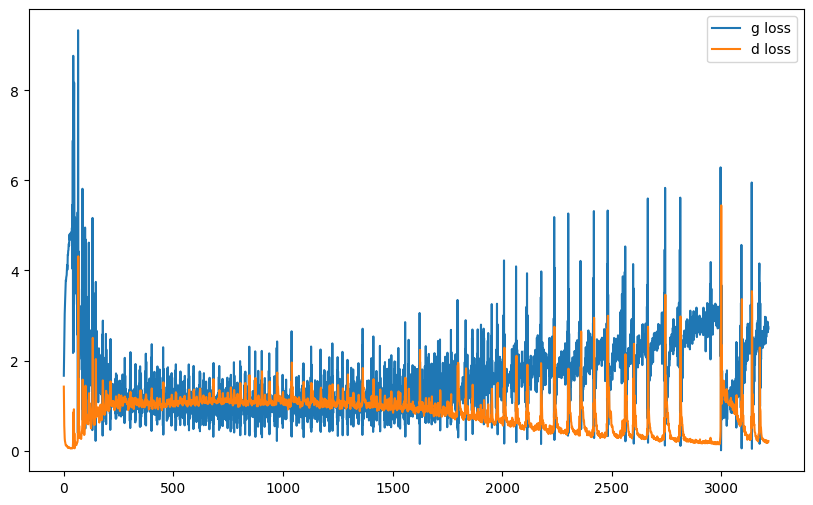

it: 3282; g_loss: 3.1103363037109375; d_loss: 0.16920103132724762; avg_real_score: 0.9307012557983398; avg_fake_score: 0.09027158468961716: : 469it [00:30, 15.56it/s] 
it: 3283; g_loss: 2.8701062202453613; d_loss: 0.14084476232528687; avg_real_score: 0.918671727180481; avg_fake_score: 0.05174438655376434: : 0it [00:00, ?it/s]

generated images


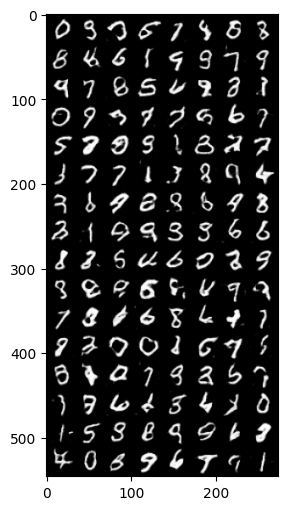

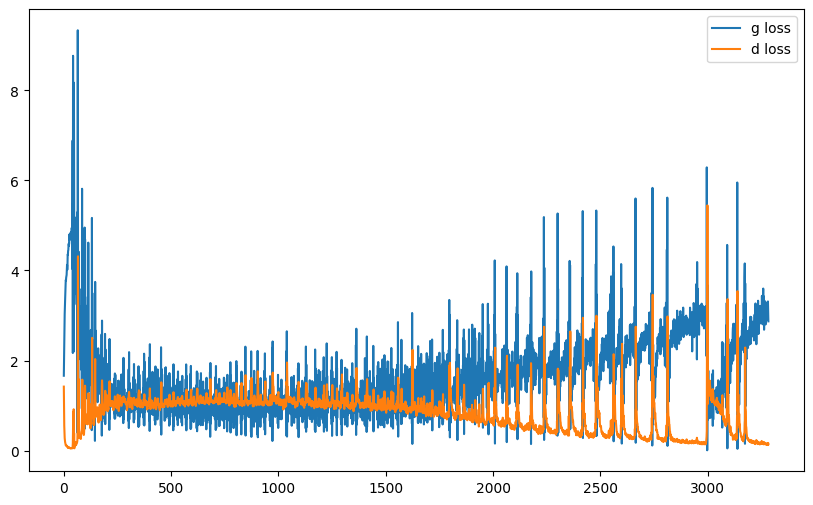

it: 3483; g_loss: 2.5042781829833984; d_loss: 0.23775392770767212; avg_real_score: 0.8692154884338379; avg_fake_score: 0.08476120233535767: : 199it [00:12, 16.36it/s]    

generated images


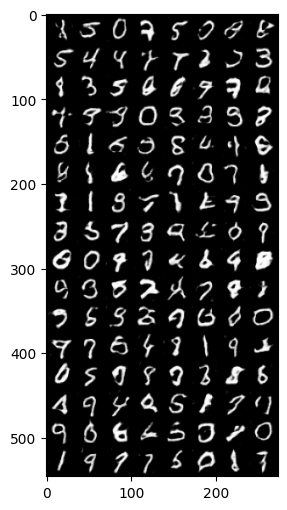

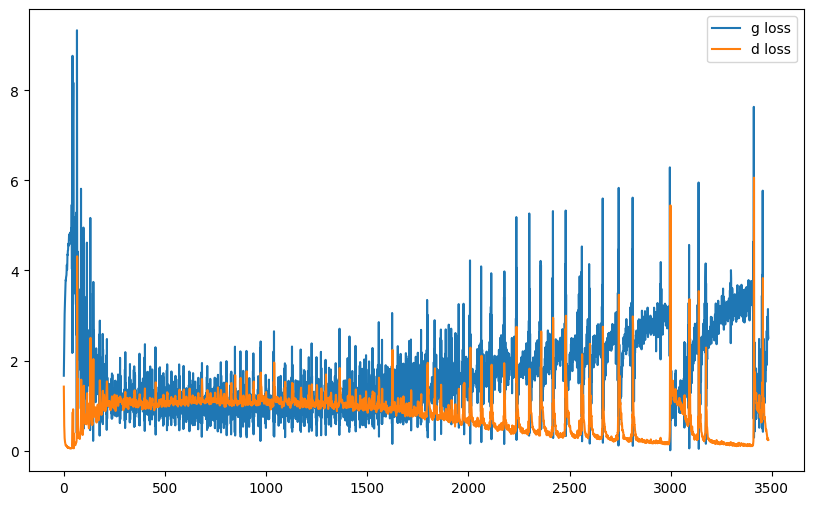

it: 3683; g_loss: 3.2405686378479004; d_loss: 0.11139526963233948; avg_real_score: 0.9431817531585693; avg_fake_score: 0.04973776265978813: : 400it [00:27, 11.69it/s]  

generated images


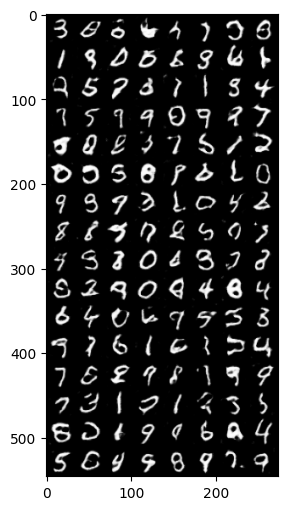

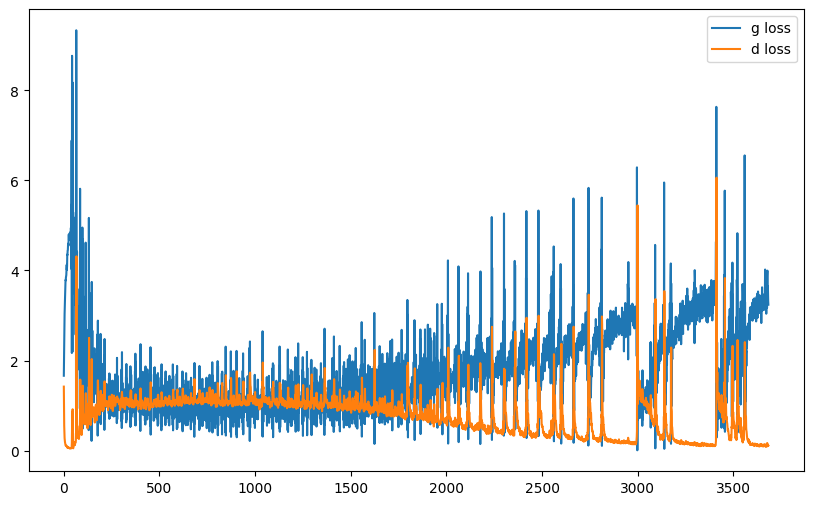

it: 3751; g_loss: 3.6423556804656982; d_loss: 0.08260905742645264; avg_real_score: 0.9533447623252869; avg_fake_score: 0.0330130010843277: : 469it [00:33, 14.06it/s]  
it: 3752; g_loss: 3.409677505493164; d_loss: 0.0862160250544548; avg_real_score: 0.9566879868507385; avg_fake_score: 0.040158867835998535: : 0it [00:00, ?it/s]

generated images


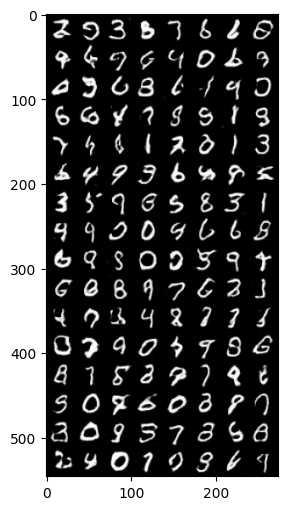

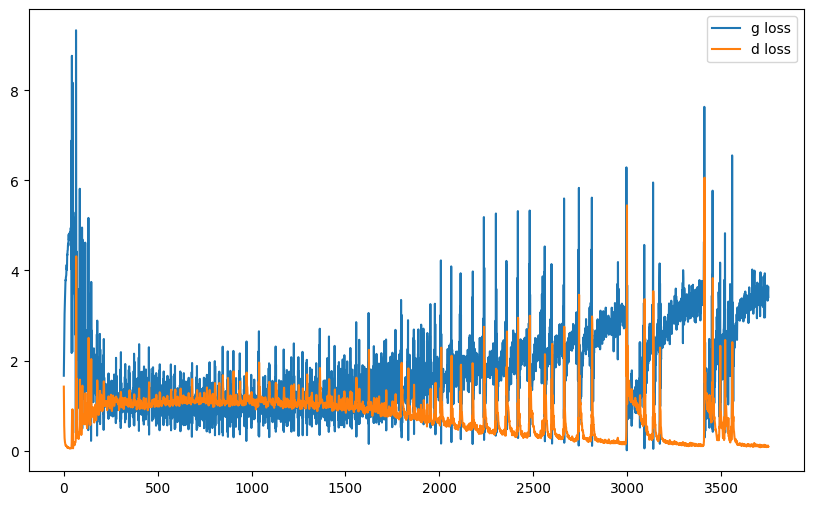

it: 3952; g_loss: 1.8397771120071411; d_loss: 0.8944532871246338; avg_real_score: 0.8951499462127686; avg_fake_score: 0.508590579032898: : 199it [00:11, 17.63it/s]       

generated images


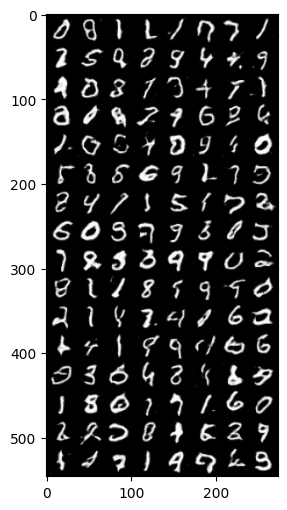

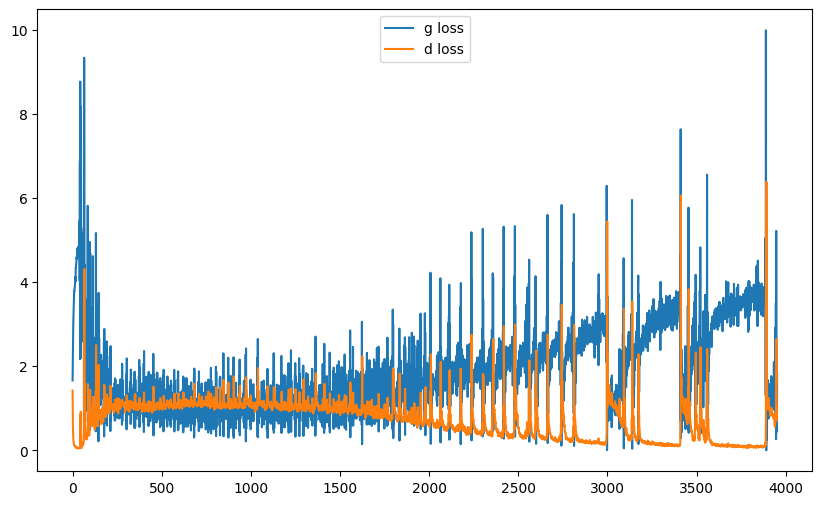

it: 4152; g_loss: 4.168702125549316; d_loss: 0.07380753755569458; avg_real_score: 0.9749159812927246; avg_fake_score: 0.04602677375078201: : 400it [00:21, 20.18it/s]  

generated images


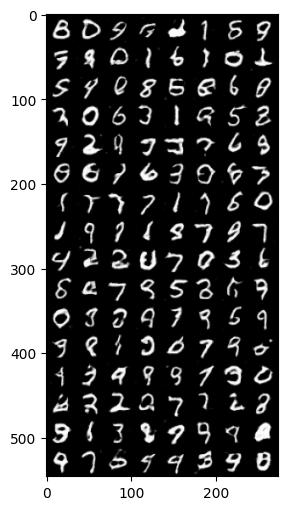

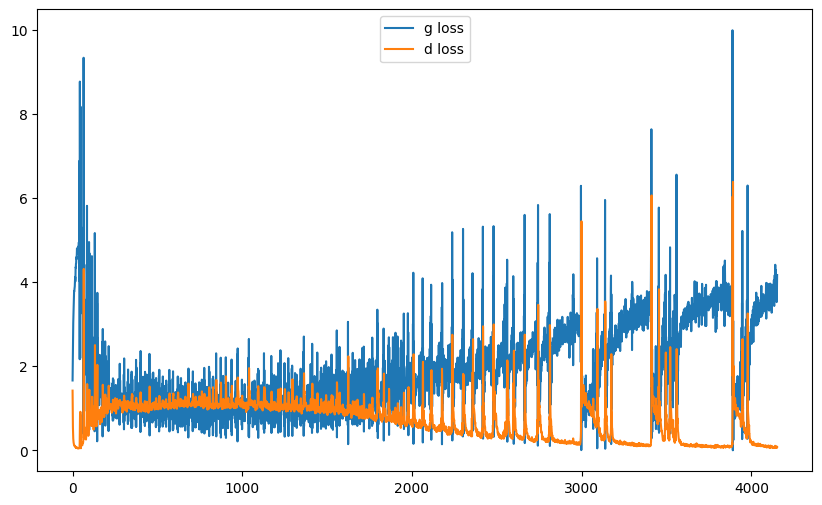

it: 4220; g_loss: 3.9027533531188965; d_loss: 0.0805542916059494; avg_real_score: 0.9732277393341064; avg_fake_score: 0.05080819129943848: : 469it [00:25, 18.10it/s]   
it: 4221; g_loss: 4.038675308227539; d_loss: 0.06471580266952515; avg_real_score: 0.9678360223770142; avg_fake_score: 0.03065040335059166: : 0it [00:00, ?it/s]

generated images


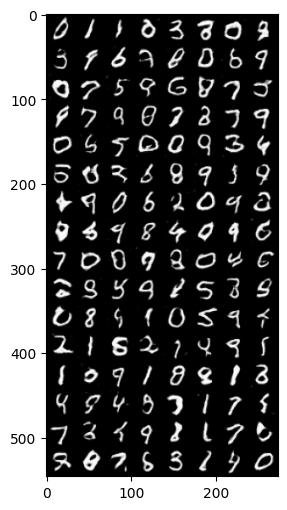

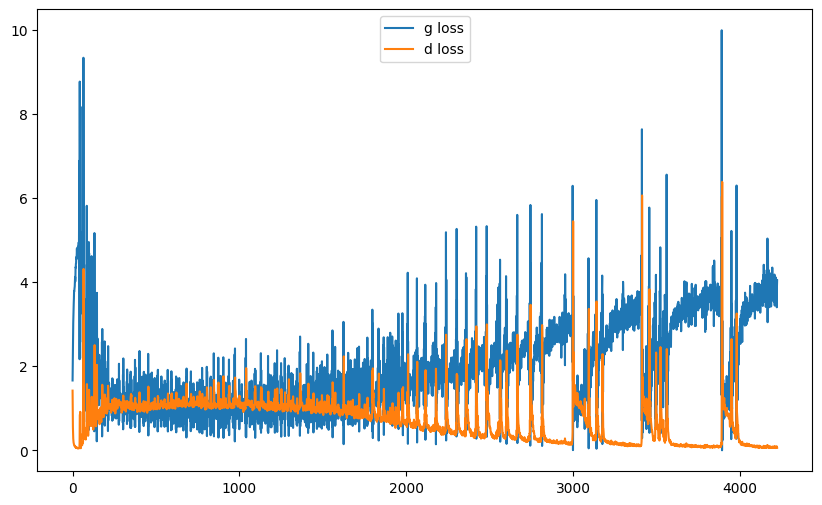

it: 4421; g_loss: 1.4223978519439697; d_loss: 0.7701418399810791; avg_real_score: 0.6243815422058105; avg_fake_score: 0.20620885491371155: : 200it [00:13, 13.89it/s]    

generated images


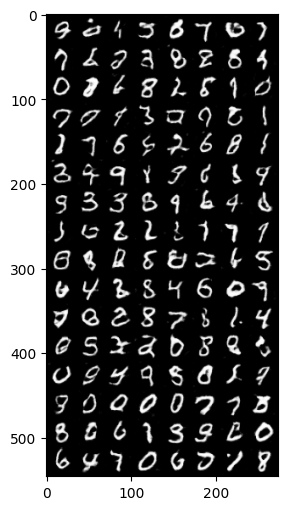

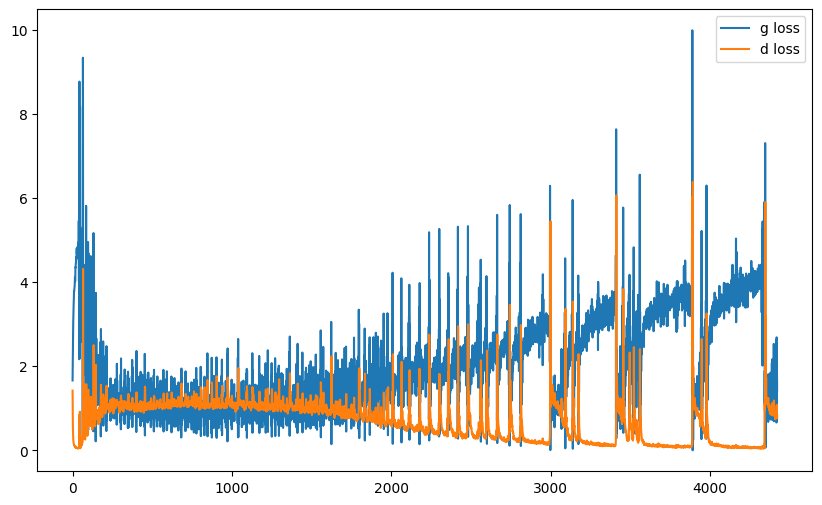

it: 4621; g_loss: 2.01483154296875; d_loss: 0.5712143778800964; avg_real_score: 0.8632359504699707; avg_fake_score: 0.31593629717826843: : 399it [00:27, 16.01it/s]    

generated images


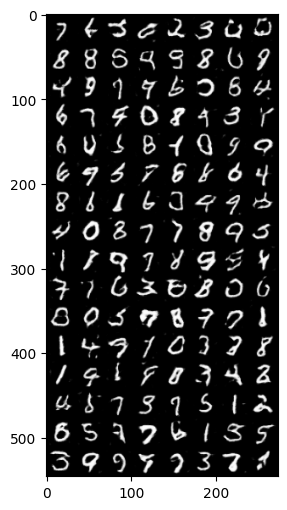

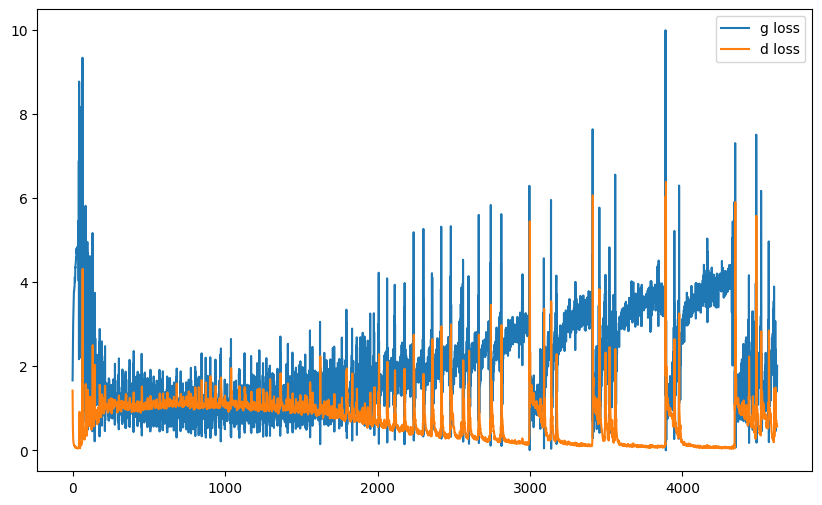

it: 4689; g_loss: 3.7076032161712646; d_loss: 0.09296126663684845; avg_real_score: 0.9625081419944763; avg_fake_score: 0.05141186714172363: : 469it [00:31, 14.68it/s] 
it: 4690; g_loss: 3.4338297843933105; d_loss: 0.09200893342494965; avg_real_score: 0.9444602727890015; avg_fake_score: 0.03182334452867508: : 0it [00:00, ?it/s]

generated images


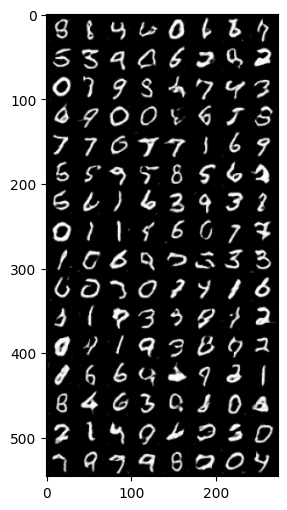

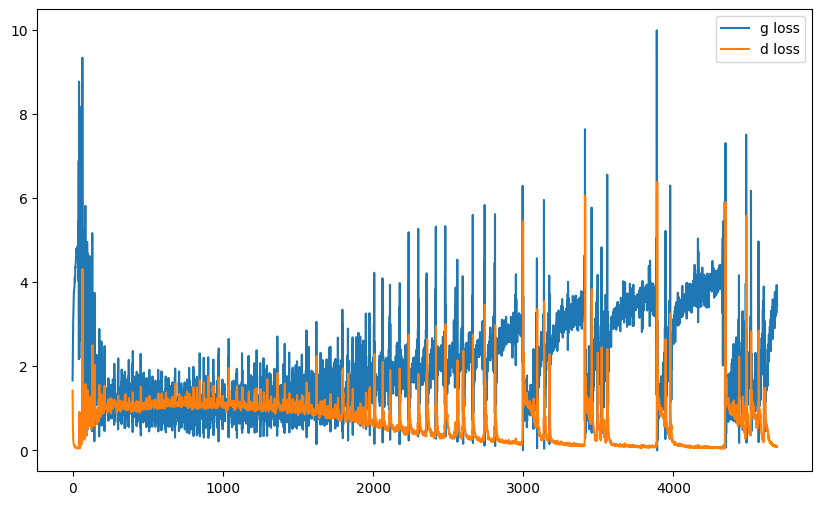

it: 4890; g_loss: 4.669371604919434; d_loss: 0.05330216884613037; avg_real_score: 0.973919153213501; avg_fake_score: 0.025910161435604095: : 199it [00:11, 19.71it/s]   

generated images


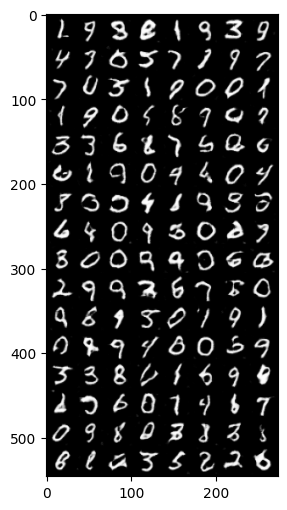

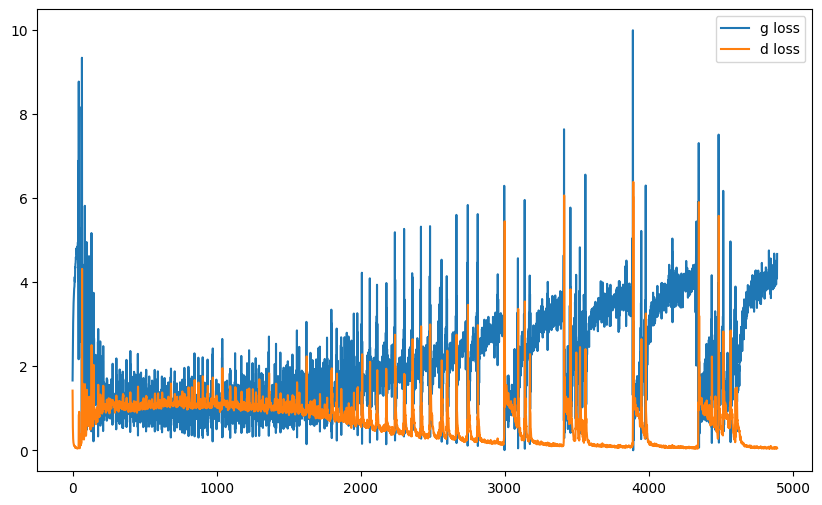

it: 5090; g_loss: 4.896921157836914; d_loss: 0.5629409551620483; avg_real_score: 0.9343202114105225; avg_fake_score: 0.3578903079032898: : 400it [00:22, 19.51it/s]        

generated images


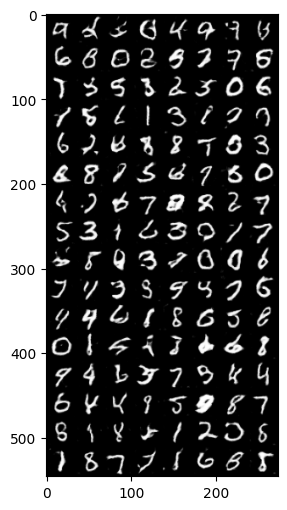

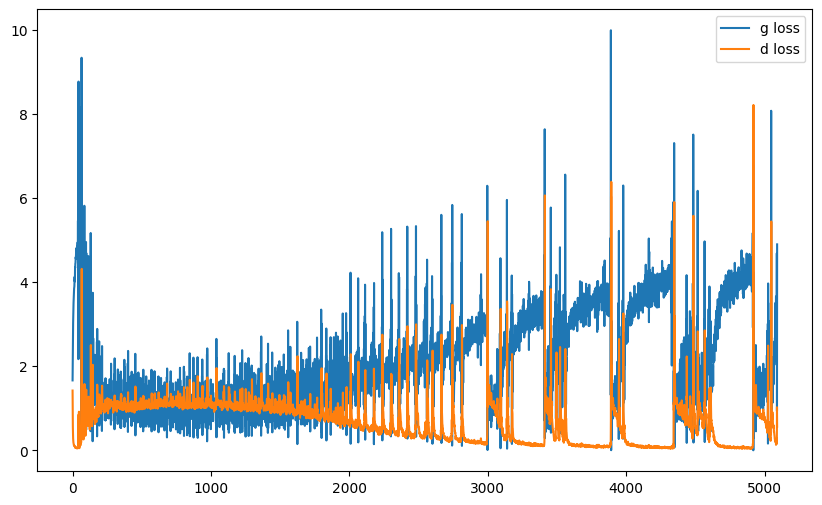

it: 5158; g_loss: 3.34981107711792; d_loss: 0.09852248430252075; avg_real_score: 0.9483940005302429; avg_fake_score: 0.04225769639015198: : 469it [00:27, 17.26it/s]    
it: 5159; g_loss: 3.707042932510376; d_loss: 0.09901301562786102; avg_real_score: 0.974766194820404; avg_fake_score: 0.06913651525974274: : 0it [00:00, ?it/s]

generated images


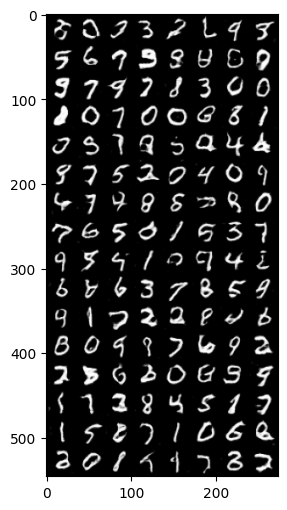

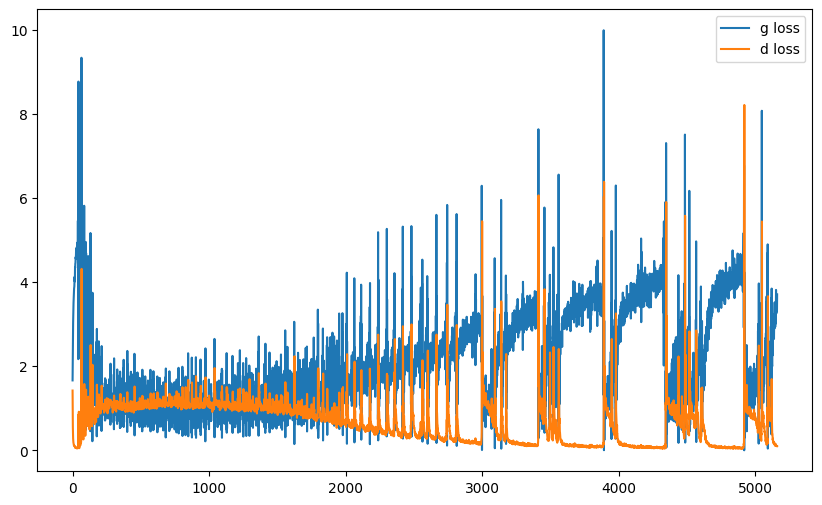

it: 5359; g_loss: 4.588718414306641; d_loss: 0.03414352983236313; avg_real_score: 0.9772757291793823; avg_fake_score: 0.010859386995434761: : 199it [00:12, 16.07it/s]  

generated images


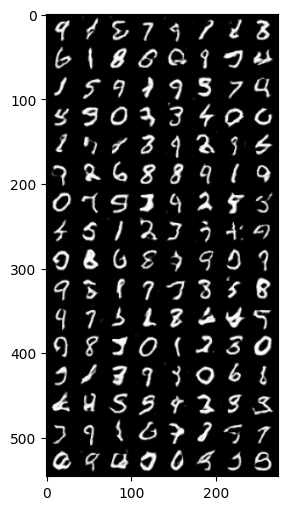

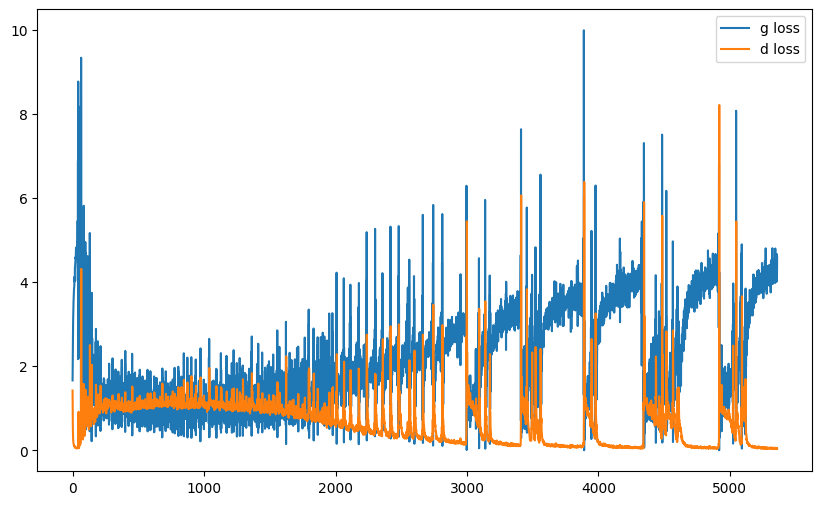

it: 5559; g_loss: 4.452971458435059; d_loss: 0.03259989991784096; avg_real_score: 0.9828939437866211; avg_fake_score: 0.015025338158011436: : 399it [00:28, 10.34it/s]  

generated images


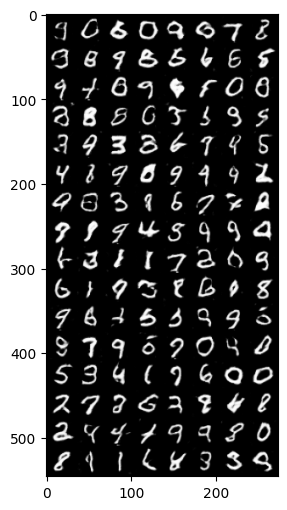

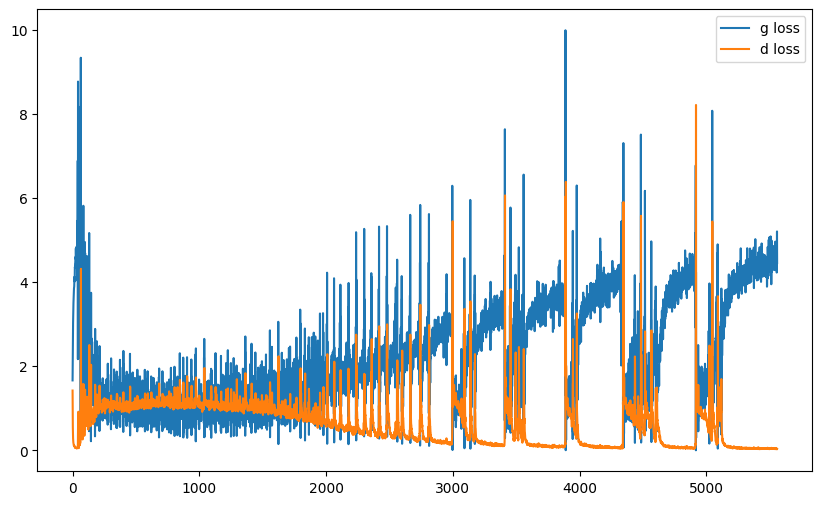

it: 5627; g_loss: 4.674987316131592; d_loss: 0.041436463594436646; avg_real_score: 0.9859662055969238; avg_fake_score: 0.026531701907515526: : 469it [00:34, 13.62it/s] 
it: 5628; g_loss: 4.376954078674316; d_loss: 0.043447453528642654; avg_real_score: 0.9711772203445435; avg_fake_score: 0.013632064685225487: : 0it [00:00, ?it/s]

generated images


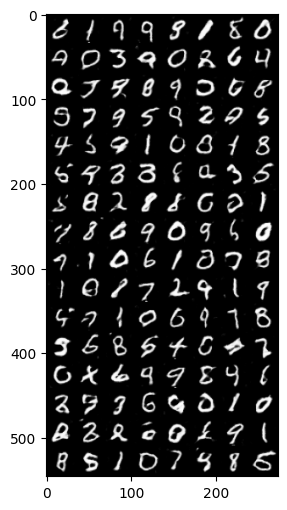

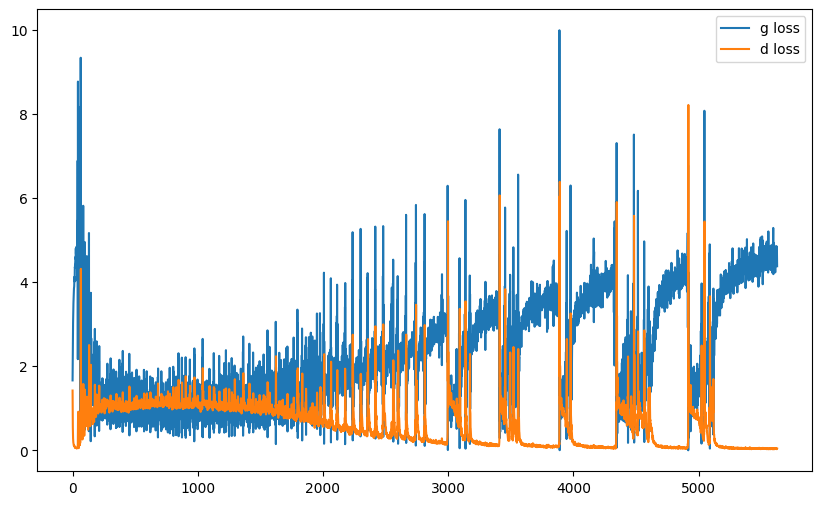

it: 5828; g_loss: 4.864018440246582; d_loss: 0.02932998538017273; avg_real_score: 0.9894037246704102; avg_fake_score: 0.018312569707632065: : 200it [00:12, 16.15it/s]   

generated images


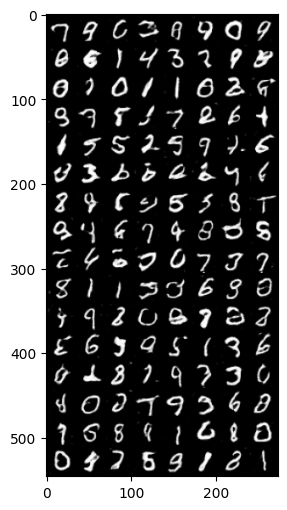

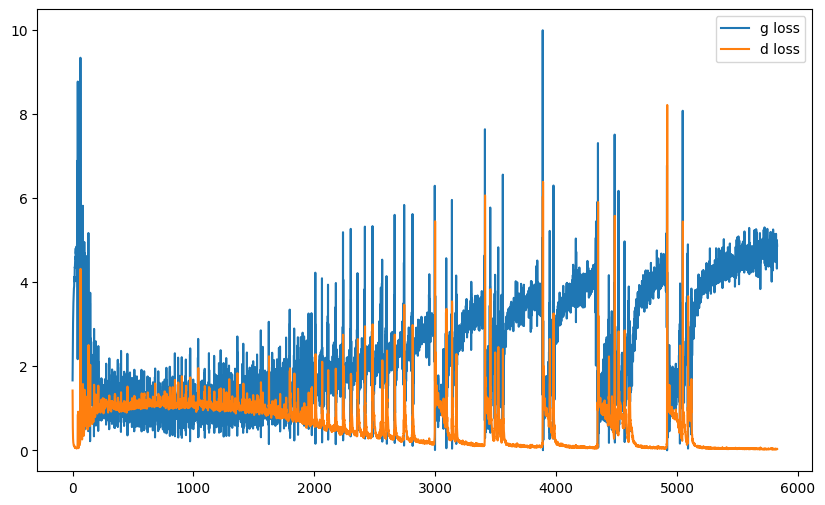

it: 6028; g_loss: 1.0082221031188965; d_loss: 0.8592202663421631; avg_real_score: 0.6019394397735596; avg_fake_score: 0.23560650646686554: : 398it [00:23, 20.06it/s]   

generated images


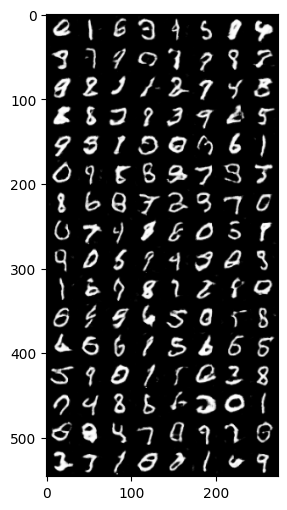

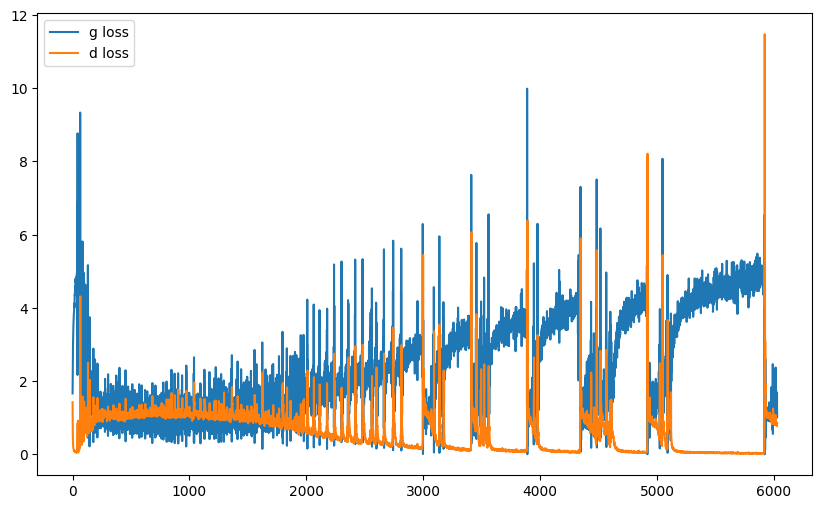

it: 6096; g_loss: 2.232304334640503; d_loss: 0.8350977301597595; avg_real_score: 0.8464258909225464; avg_fake_score: 0.44359052181243896: : 469it [00:29, 16.04it/s]  
it: 6097; g_loss: 1.2480332851409912; d_loss: 0.7912802696228027; avg_real_score: 0.5986009836196899; avg_fake_score: 0.18169672787189484: : 0it [00:00, ?it/s]

generated images


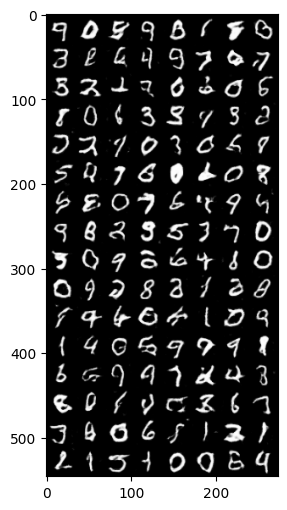

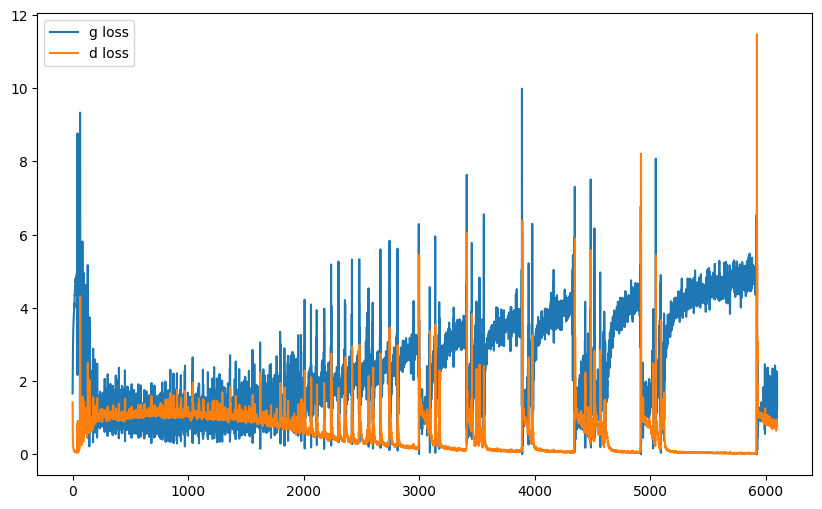

it: 6297; g_loss: 2.3648176193237305; d_loss: 0.39196425676345825; avg_real_score: 0.8331198692321777; avg_fake_score: 0.17076312005519867: : 200it [00:16, 16.35it/s]  

generated images


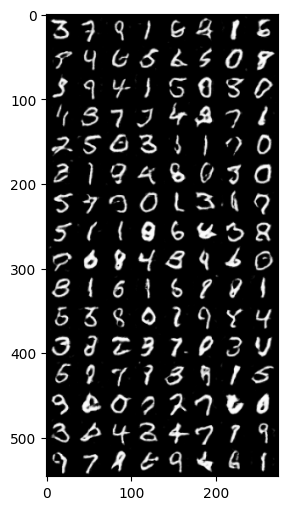

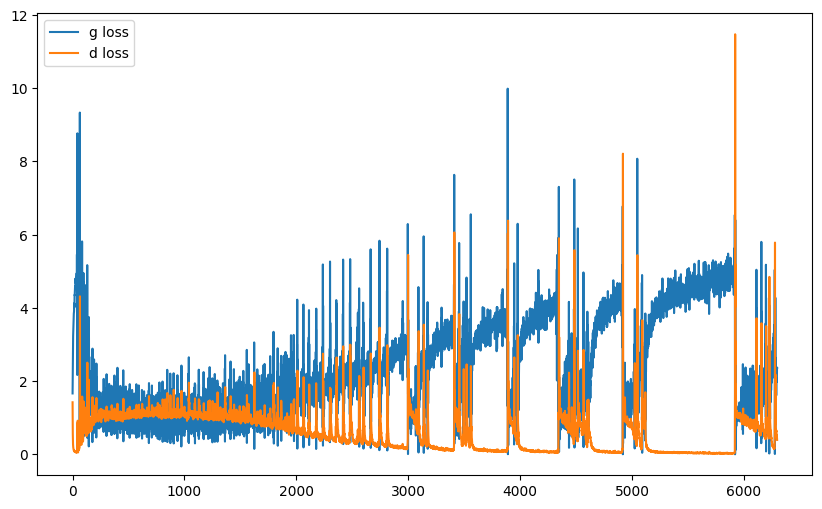

it: 6497; g_loss: 2.084031105041504; d_loss: 0.9190556406974792; avg_real_score: 0.785517692565918; avg_fake_score: 0.45442768931388855: : 400it [00:28, 18.24it/s]       

generated images


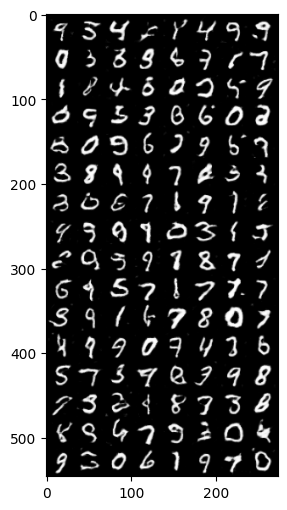

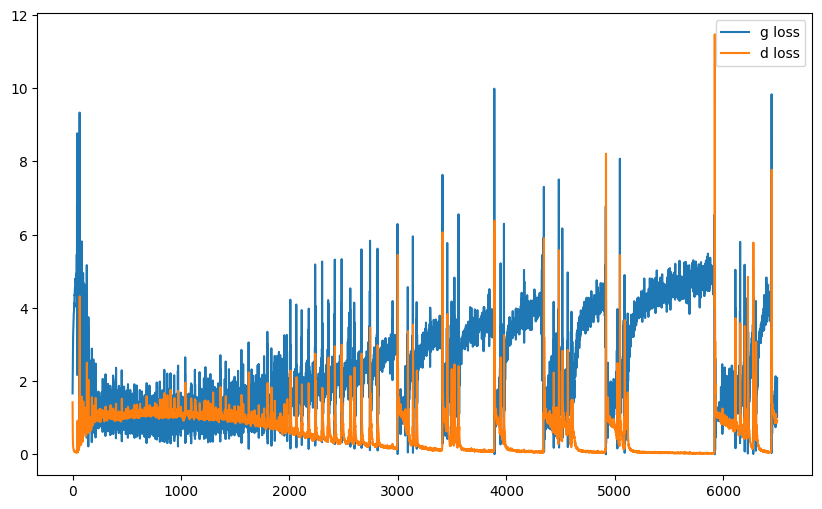

it: 6565; g_loss: 1.5737876892089844; d_loss: 0.7389519214630127; avg_real_score: 0.6915531158447266; avg_fake_score: 0.26893800497055054: : 469it [00:32, 14.33it/s] 
it: 6566; g_loss: 1.558108925819397; d_loss: 0.8184832334518433; avg_real_score: 0.7077656984329224; avg_fake_score: 0.32813695073127747: : 0it [00:00, ?it/s]

generated images


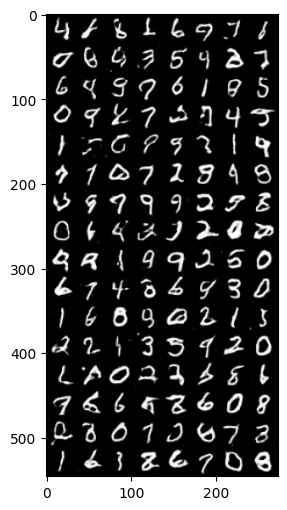

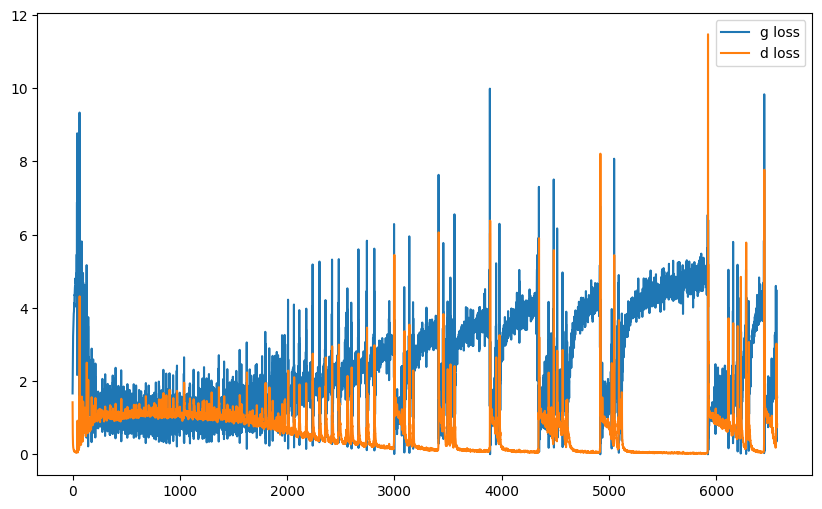

it: 6766; g_loss: 4.525636196136475; d_loss: 0.045013971626758575; avg_real_score: 0.9785594940185547; avg_fake_score: 0.022678624838590622: : 200it [00:11, 12.44it/s] 

generated images


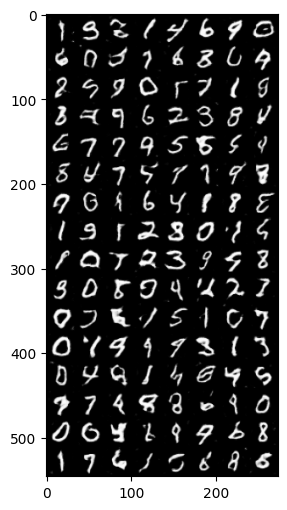

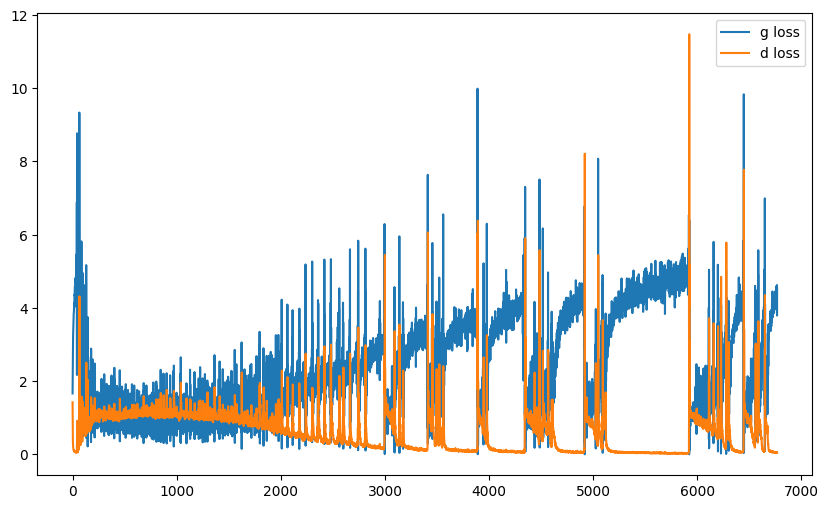

it: 6966; g_loss: 4.517096519470215; d_loss: 0.03432673215866089; avg_real_score: 0.9862170219421387; avg_fake_score: 0.02001272886991501: : 399it [00:27,  9.94it/s]   

generated images


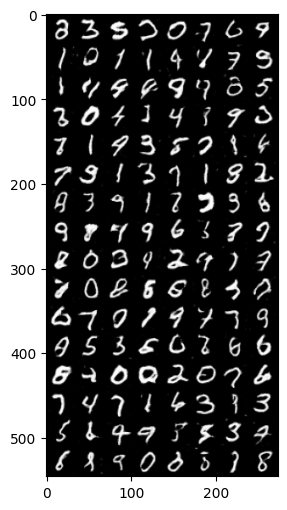

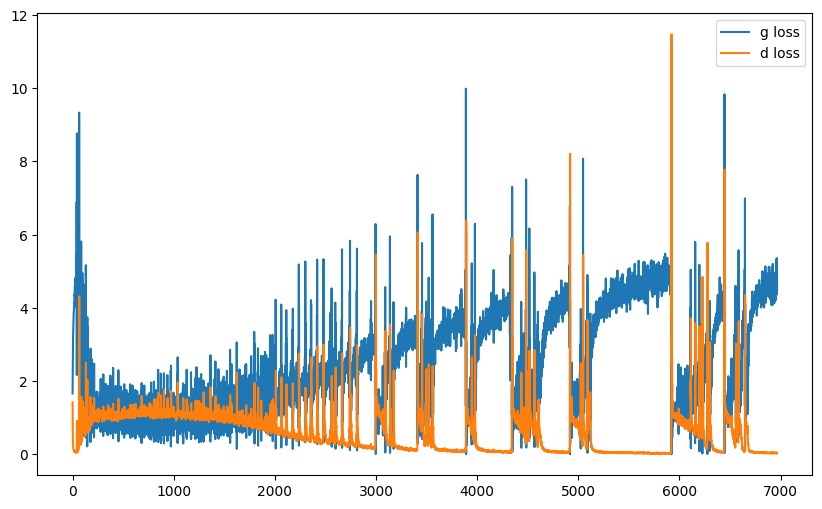

it: 7034; g_loss: 4.544040203094482; d_loss: 0.033566202968358994; avg_real_score: 0.9844764471054077; avg_fake_score: 0.017126254737377167: : 469it [00:32, 14.24it/s] 
it: 7035; g_loss: 4.726061820983887; d_loss: 0.03316088765859604; avg_real_score: 0.9898330569267273; avg_fake_score: 0.0223851315677166: : 0it [00:00, ?it/s]

generated images


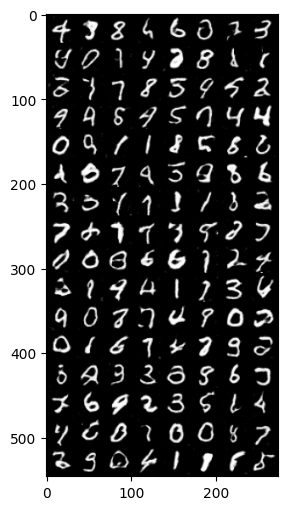

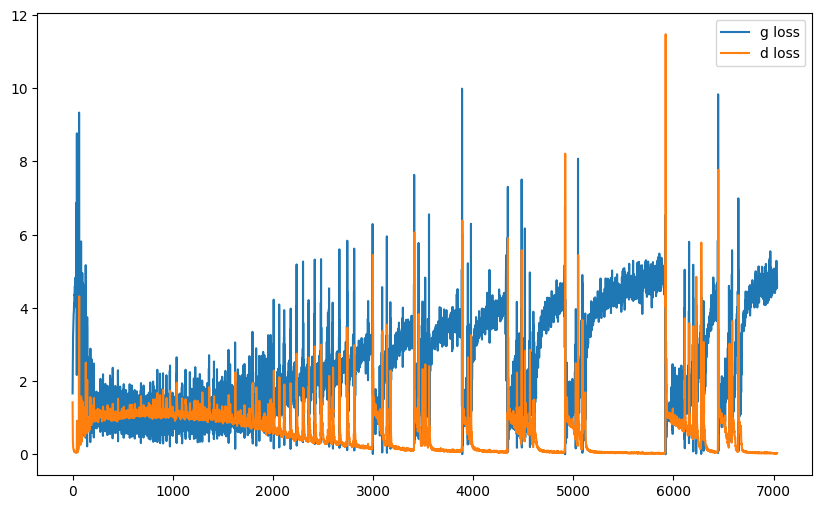

it: 7235; g_loss: 5.412741661071777; d_loss: 0.02300683595240116; avg_real_score: 0.9865727424621582; avg_fake_score: 0.009173971600830555: : 199it [00:11, 18.33it/s]  

generated images


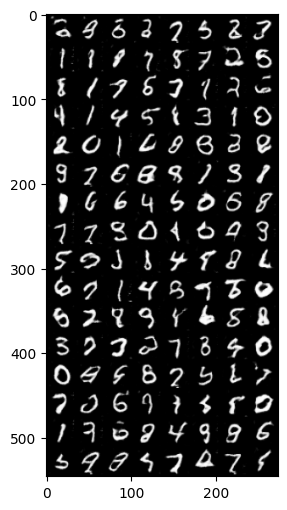

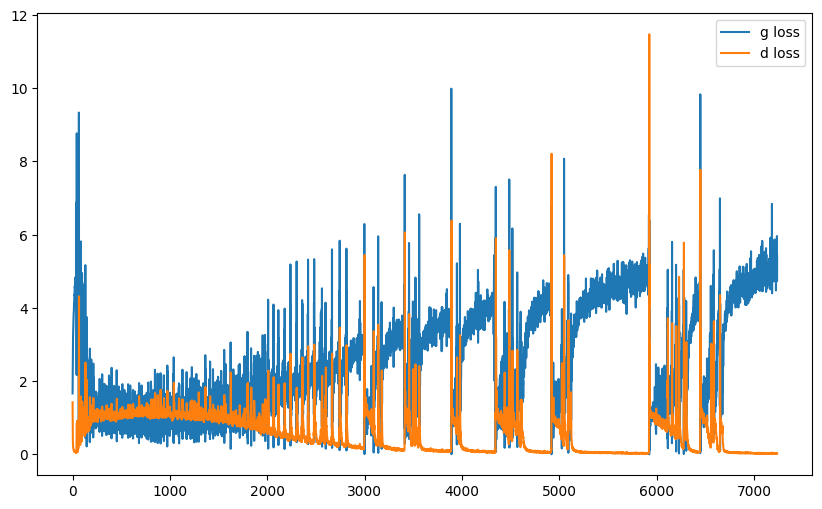

it: 7435; g_loss: 4.967474937438965; d_loss: 0.021169599145650864; avg_real_score: 0.9934225082397461; avg_fake_score: 0.014317074790596962: : 400it [00:23, 11.24it/s] 

generated images


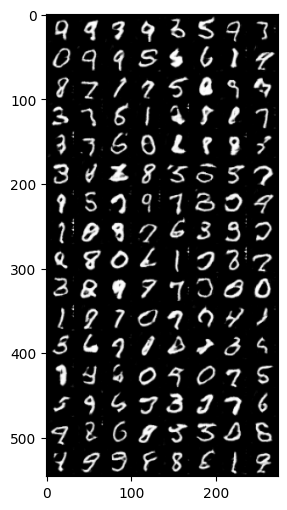

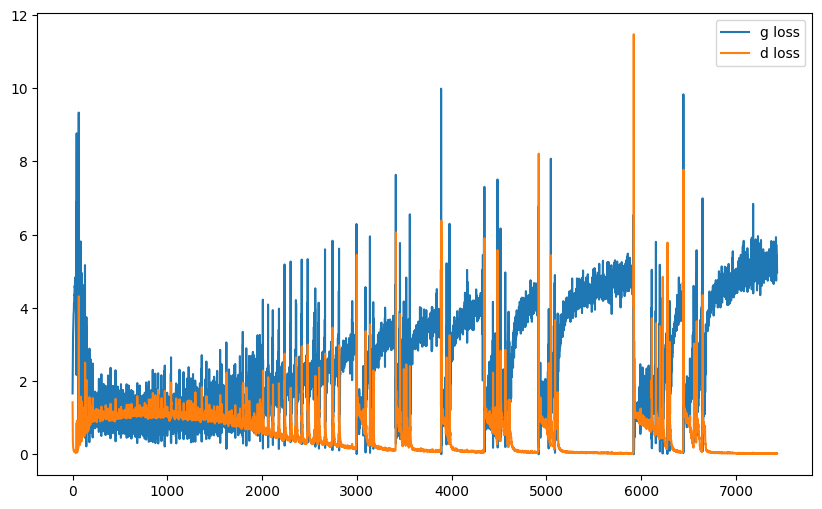

it: 7503; g_loss: 5.130191802978516; d_loss: 0.03198476880788803; avg_real_score: 0.9933933019638062; avg_fake_score: 0.02451062761247158: : 469it [00:28, 16.53it/s]   
it: 7504; g_loss: 6.90384578704834; d_loss: 0.0369599349796772; avg_real_score: 0.9703709483146667; avg_fake_score: 0.006248140707612038: : 0it [00:00, ?it/s]

generated images


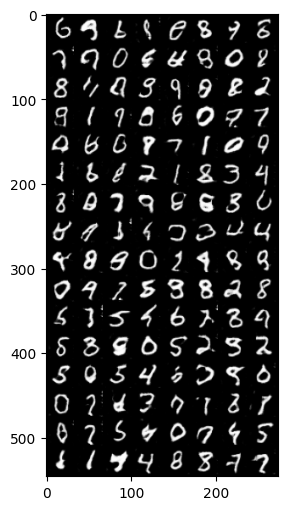

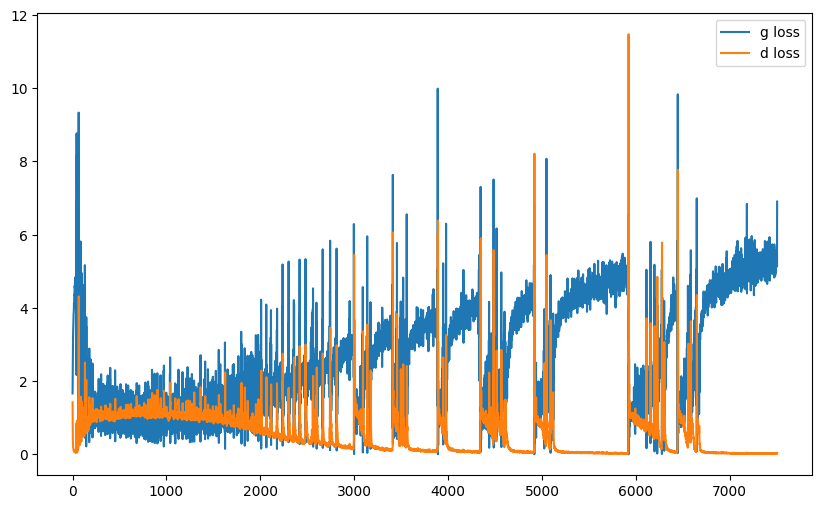

it: 7704; g_loss: 0.541586697101593; d_loss: 0.8285768032073975; avg_real_score: 0.7354535460472107; avg_fake_score: 0.34170088171958923: : 200it [00:14, 15.92it/s]    

generated images


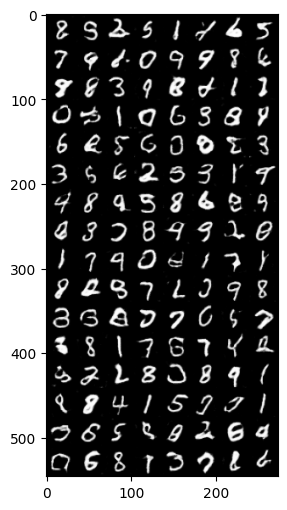

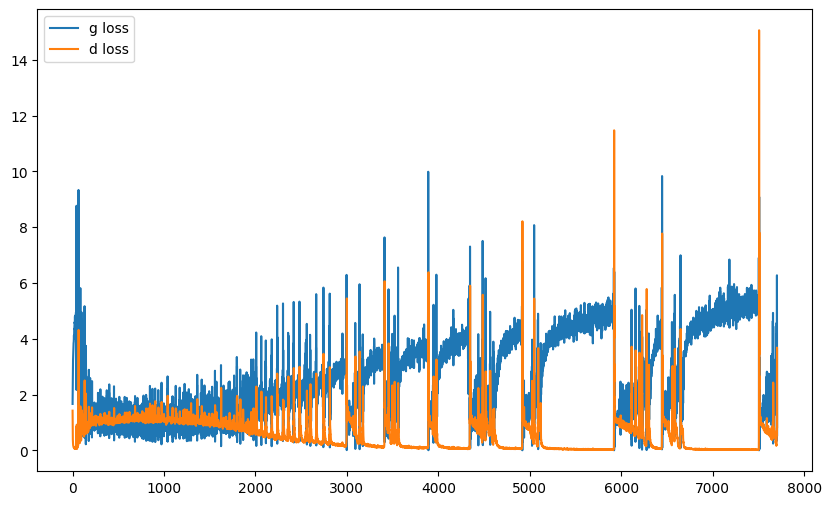

it: 7904; g_loss: 2.331411123275757; d_loss: 0.4634416699409485; avg_real_score: 0.8182315230369568; avg_fake_score: 0.19967854022979736: : 399it [00:28, 12.92it/s]   

generated images


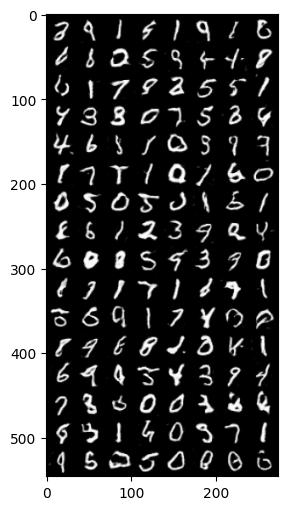

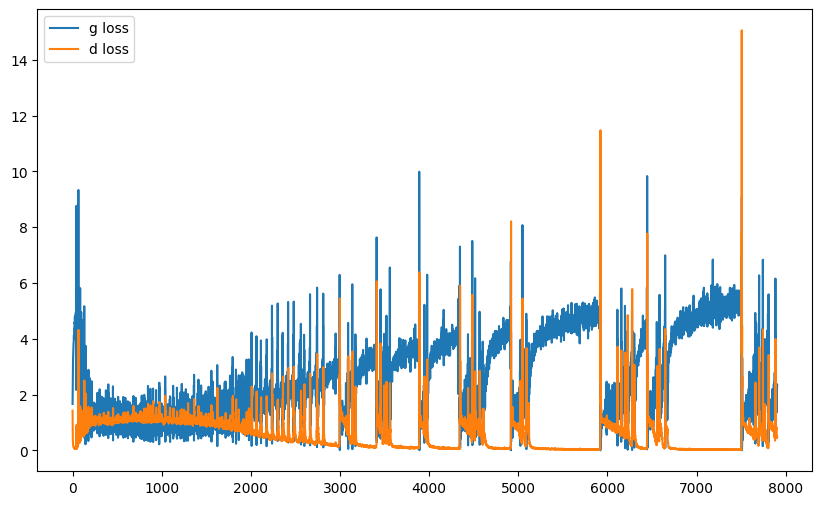

it: 7972; g_loss: 0.9630023837089539; d_loss: 0.7555768489837646; avg_real_score: 0.6189885139465332; avg_fake_score: 0.19773244857788086: : 469it [00:33, 13.91it/s]   
it: 7973; g_loss: 2.4984936714172363; d_loss: 0.7991348505020142; avg_real_score: 0.8871554136276245; avg_fake_score: 0.4637444019317627: : 0it [00:00, ?it/s]

generated images


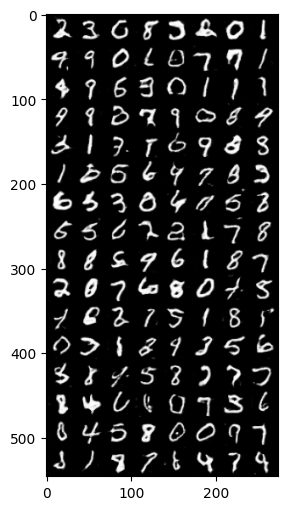

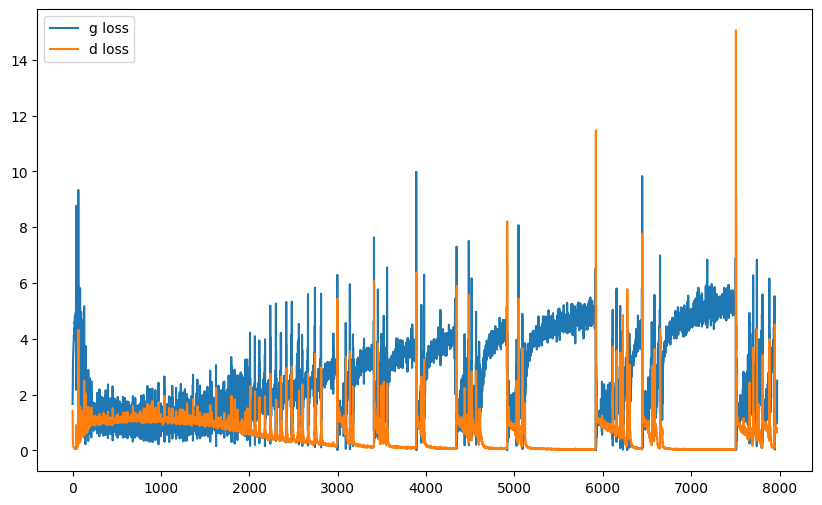

it: 8173; g_loss: 4.355435371398926; d_loss: 0.03885861113667488; avg_real_score: 0.9778745770454407; avg_fake_score: 0.015932172536849976: : 200it [00:12, 16.25it/s] 

generated images


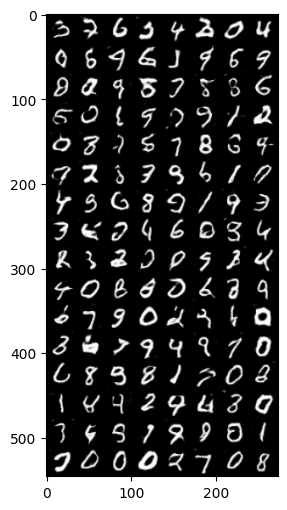

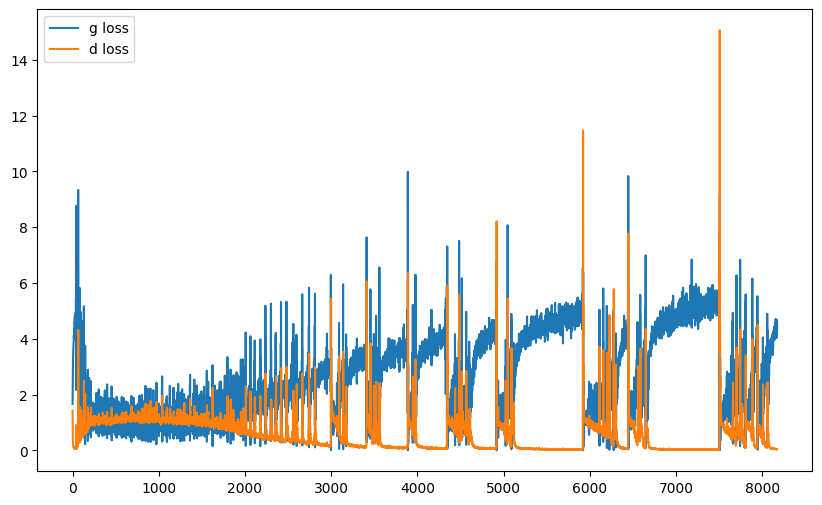

it: 8373; g_loss: 5.268582344055176; d_loss: 0.014542762190103531; avg_real_score: 0.9916592240333557; avg_fake_score: 0.006089829374104738: : 400it [00:25, 16.90it/s] 

generated images


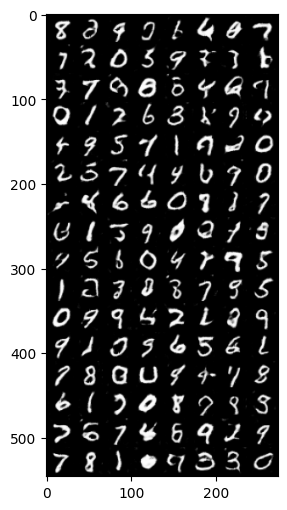

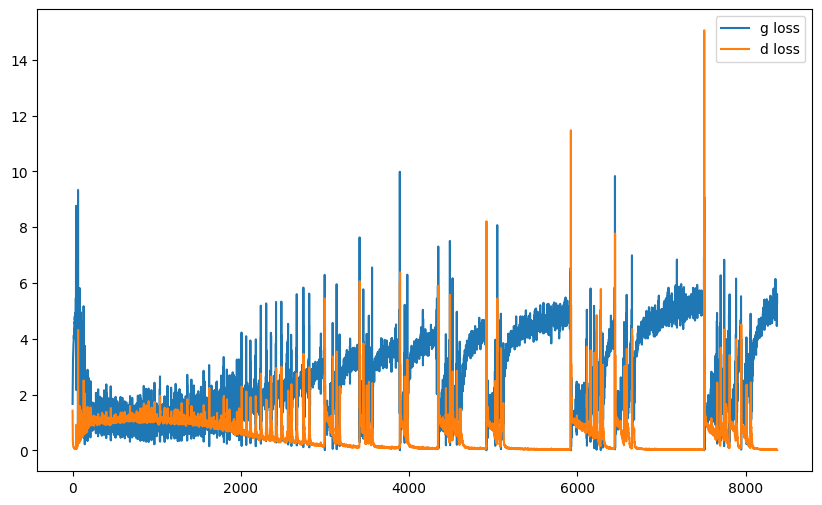

it: 8441; g_loss: 5.040585994720459; d_loss: 0.019221162423491478; avg_real_score: 0.9962441325187683; avg_fake_score: 0.015249419026076794: : 469it [00:29, 15.70it/s] 
it: 8442; g_loss: 5.485681533813477; d_loss: 0.019770808517932892; avg_real_score: 0.9870240092277527; avg_fake_score: 0.006573103368282318: : 0it [00:00, ?it/s]

generated images


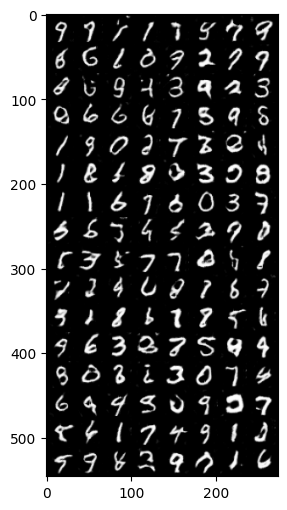

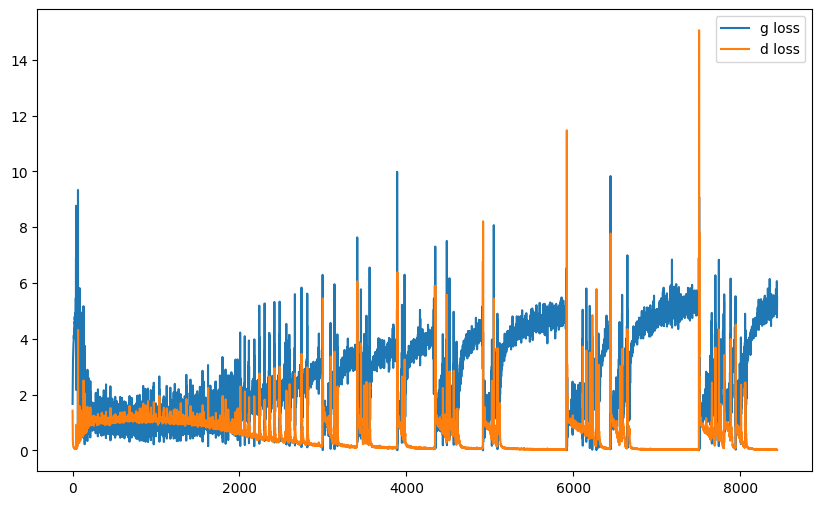

it: 8642; g_loss: 5.545825958251953; d_loss: 0.013130567967891693; avg_real_score: 0.9928230047225952; avg_fake_score: 0.005860280245542526: : 200it [00:13, 11.07it/s] 

generated images


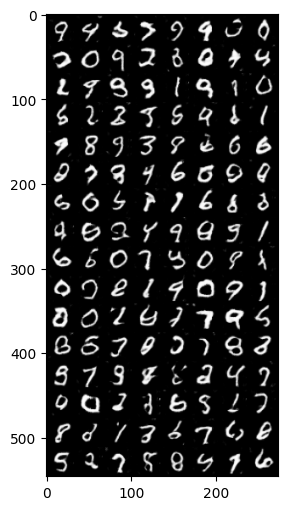

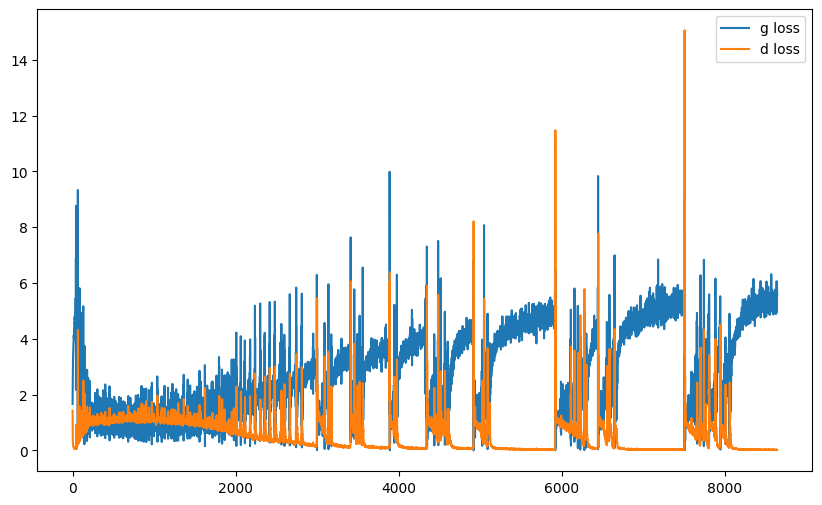

it: 8842; g_loss: 5.307692050933838; d_loss: 0.019087567925453186; avg_real_score: 0.9955604076385498; avg_fake_score: 0.014362337999045849: : 399it [00:28, 12.97it/s]  

generated images


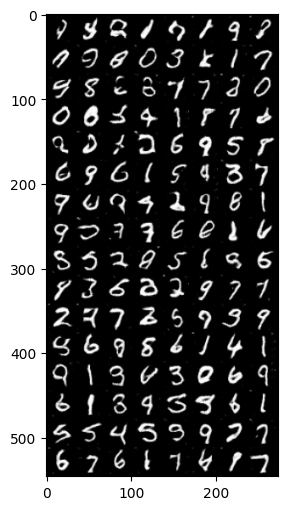

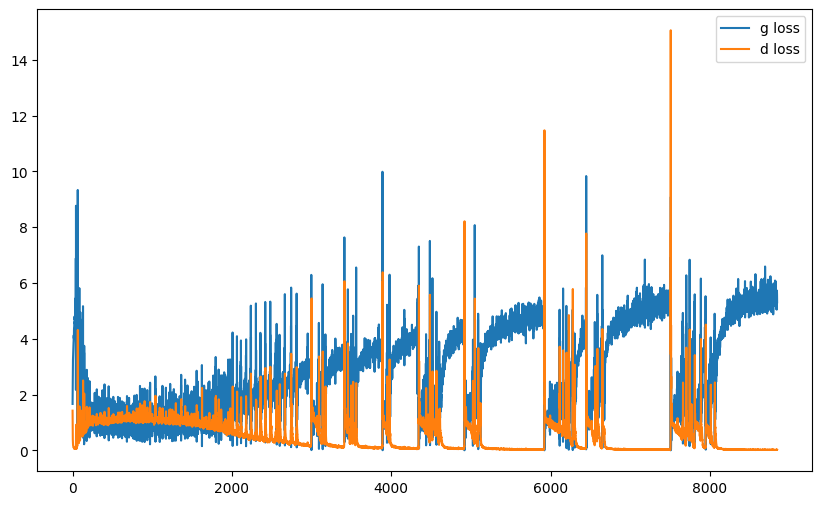

it: 8910; g_loss: 5.459836959838867; d_loss: 0.017808815464377403; avg_real_score: 0.9948307275772095; avg_fake_score: 0.012457309290766716: : 469it [00:33, 13.93it/s] 
it: 8911; g_loss: 6.501707077026367; d_loss: 0.009455271065235138; avg_real_score: 0.9928746223449707; avg_fake_score: 0.0022697222884744406: : 0it [00:00, ?it/s]

generated images


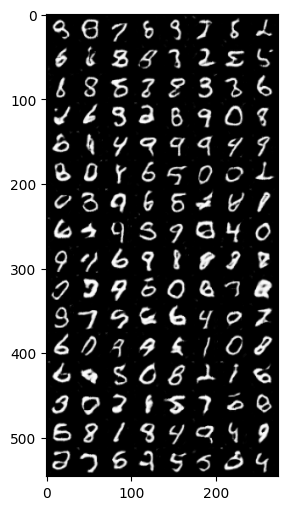

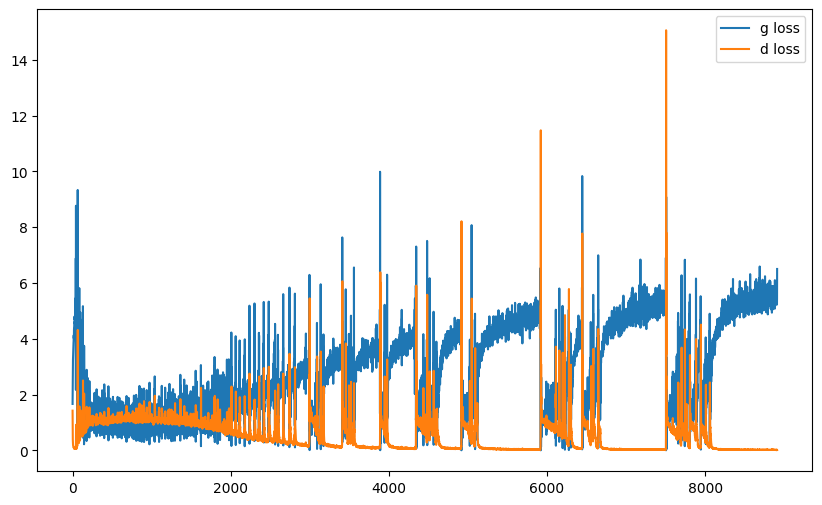

it: 9111; g_loss: 5.81754207611084; d_loss: 0.011695919558405876; avg_real_score: 0.9933011531829834; avg_fake_score: 0.004921470768749714: : 199it [00:11, 19.09it/s]  

generated images


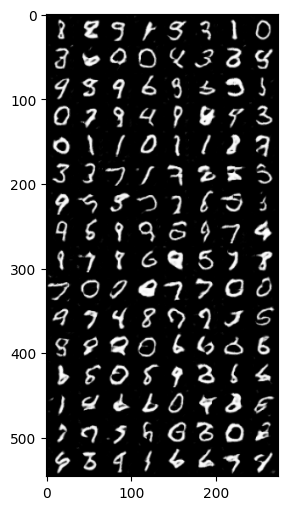

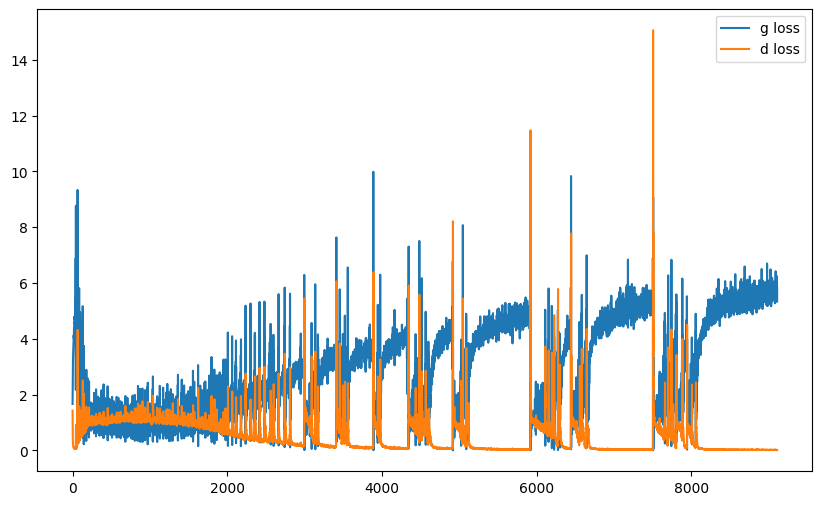

it: 9311; g_loss: 5.6712117195129395; d_loss: 0.012122059240937233; avg_real_score: 0.9954291582107544; avg_fake_score: 0.007455997634679079: : 398it [00:22, 19.88it/s] 

generated images


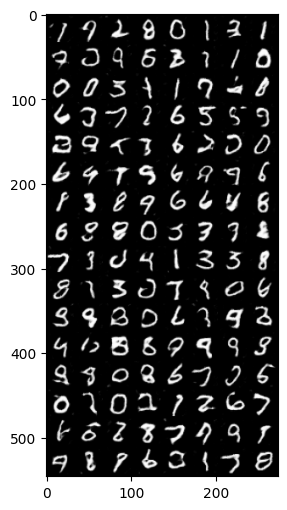

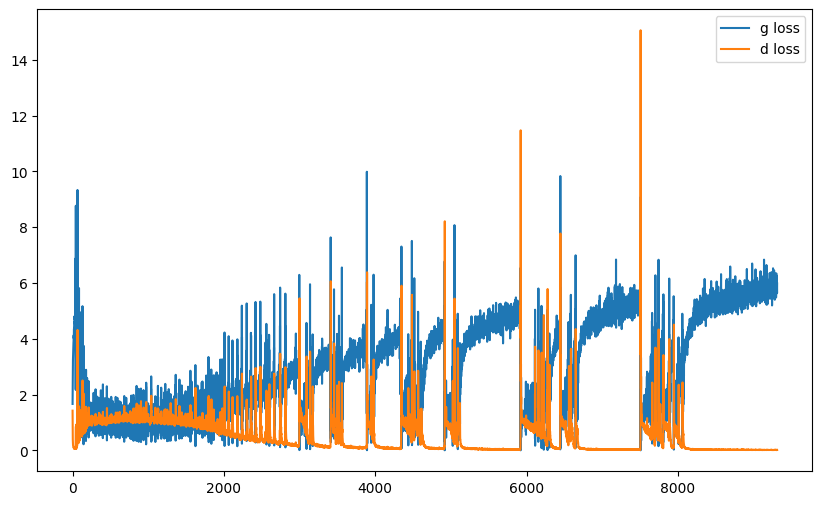

it: 9379; g_loss: 1.449249029159546; d_loss: 0.6140239238739014; avg_real_score: 0.7212132215499878; avg_fake_score: 0.20637749135494232: : 469it [00:26, 17.85it/s]        
it: 9380; g_loss: 2.0358922481536865; d_loss: 0.6906007528305054; avg_real_score: 0.8148609399795532; avg_fake_score: 0.32009357213974: : 0it [00:00, ?it/s]

generated images


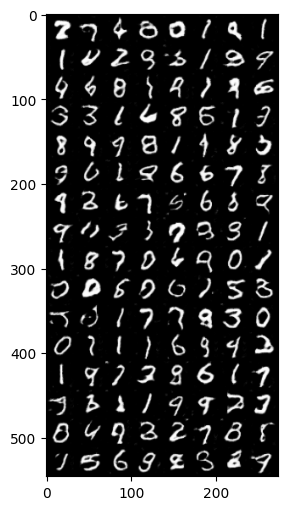

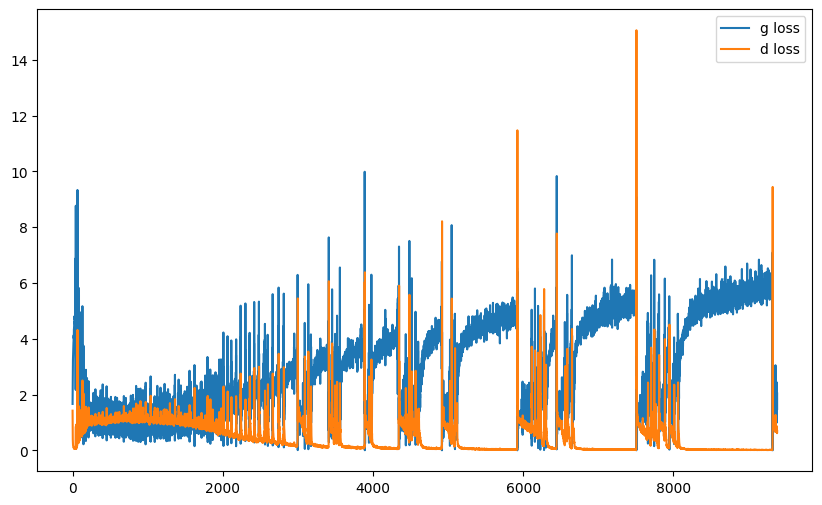

it: 9580; g_loss: 1.9585338830947876; d_loss: 0.5420520305633545; avg_real_score: 0.7480419874191284; avg_fake_score: 0.18226543068885803: : 199it [00:11, 19.58it/s]

generated images


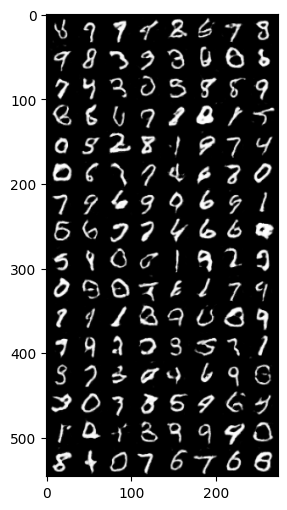

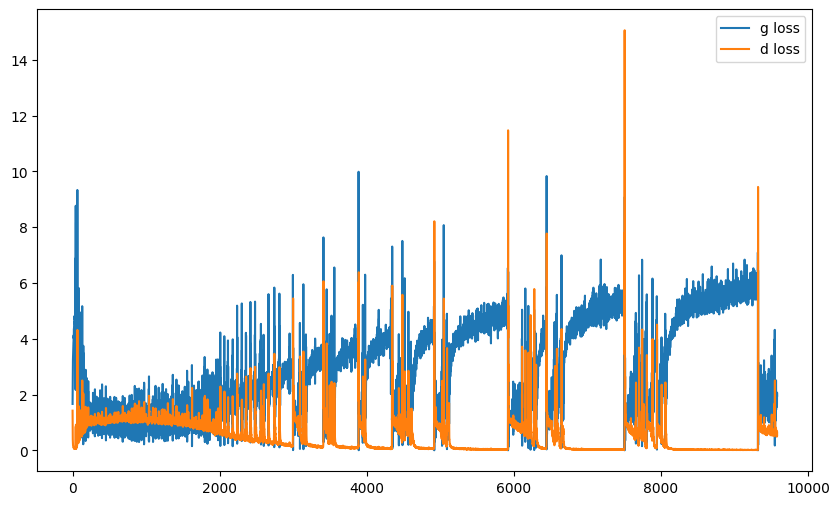

it: 9780; g_loss: 2.4003753662109375; d_loss: 0.2567303776741028; avg_real_score: 0.857691764831543; avg_fake_score: 0.0794583335518837: : 400it [00:22, 20.18it/s]       

generated images


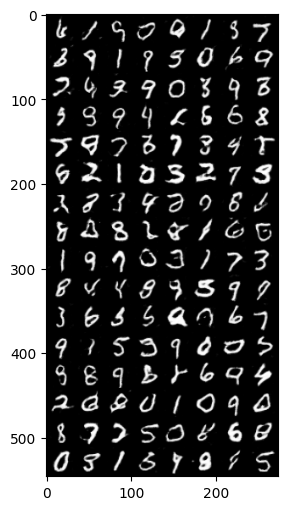

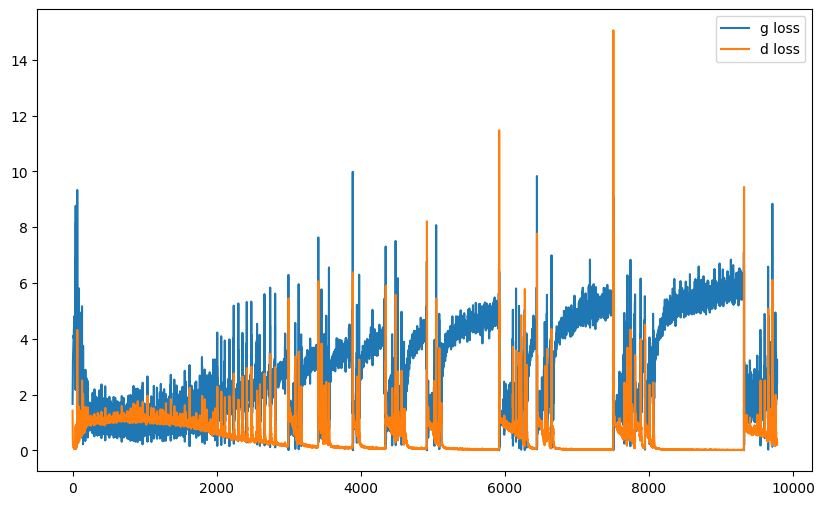

it: 9848; g_loss: 1.6340917348861694; d_loss: 0.886551022529602; avg_real_score: 0.7291494607925415; avg_fake_score: 0.3718532919883728: : 469it [00:26, 17.65it/s]     
it: 9849; g_loss: 1.7392783164978027; d_loss: 0.7152321934700012; avg_real_score: 0.7183434367179871; avg_fake_score: 0.2765030860900879: : 0it [00:00, ?it/s]

generated images


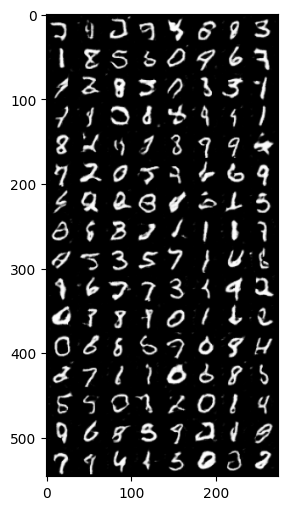

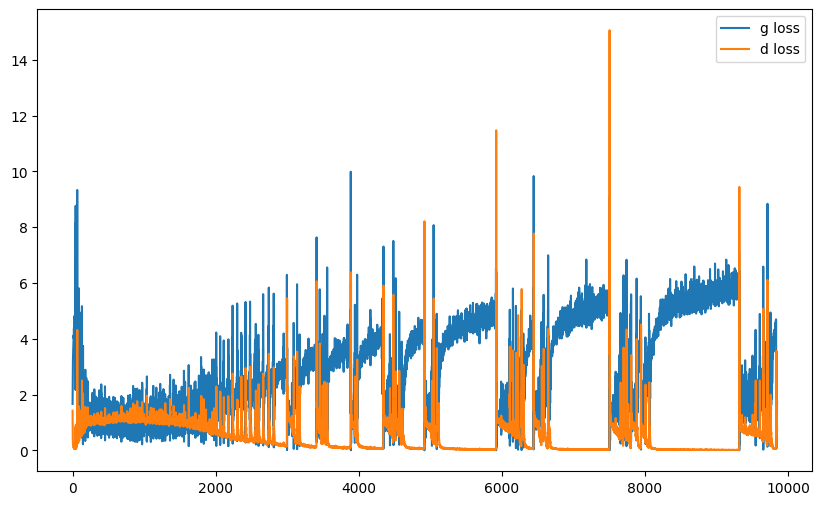

it: 10049; g_loss: 4.321447372436523; d_loss: 0.039434924721717834; avg_real_score: 0.9840313196182251; avg_fake_score: 0.022684035822749138: : 198it [00:10, 19.39it/s]

generated images


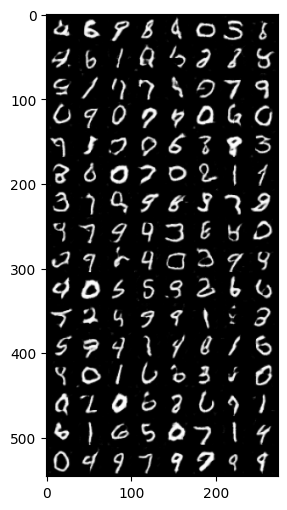

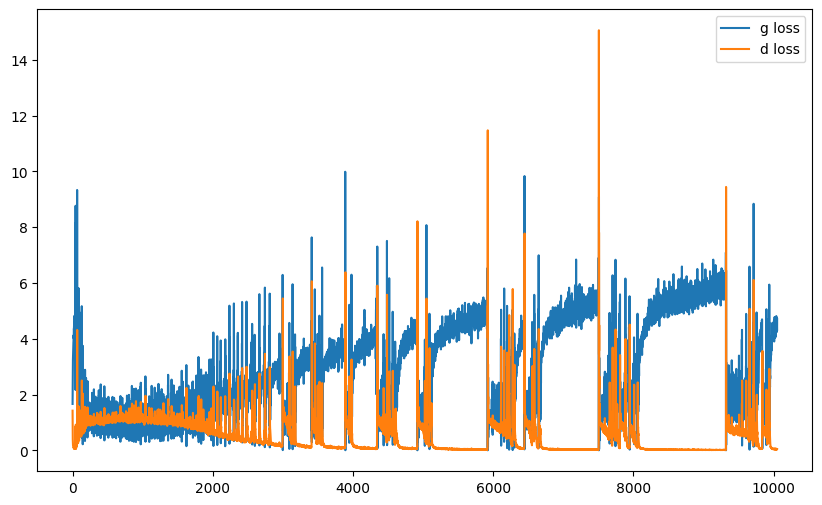

it: 10249; g_loss: 1.9671556949615479; d_loss: 0.5399308204650879; avg_real_score: 0.818771481513977; avg_fake_score: 0.2511919438838959: : 400it [00:21, 20.80it/s]     

generated images


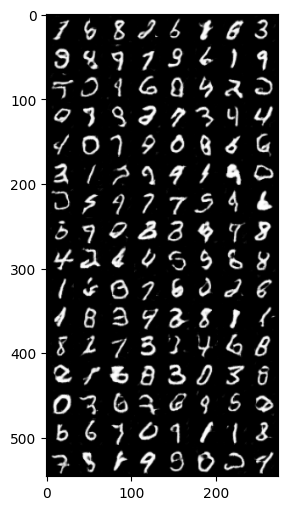

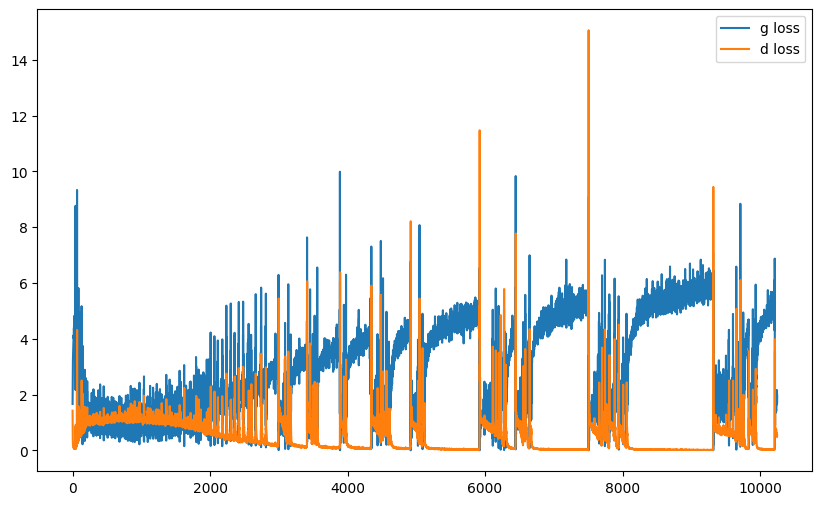

it: 10317; g_loss: 3.3581528663635254; d_loss: 0.13179941475391388; avg_real_score: 0.9268215894699097; avg_fake_score: 0.048716165125370026: : 469it [00:25, 18.17it/s]
it: 10318; g_loss: 4.008674621582031; d_loss: 0.1380535513162613; avg_real_score: 0.9684181213378906; avg_fake_score: 0.09425867348909378: : 0it [00:00, ?it/s]

generated images


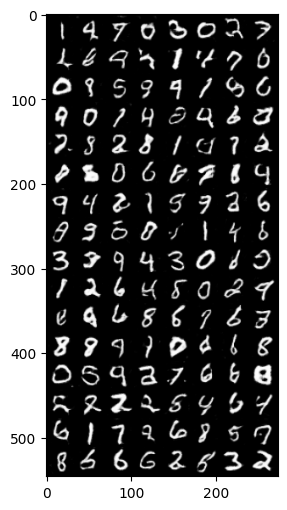

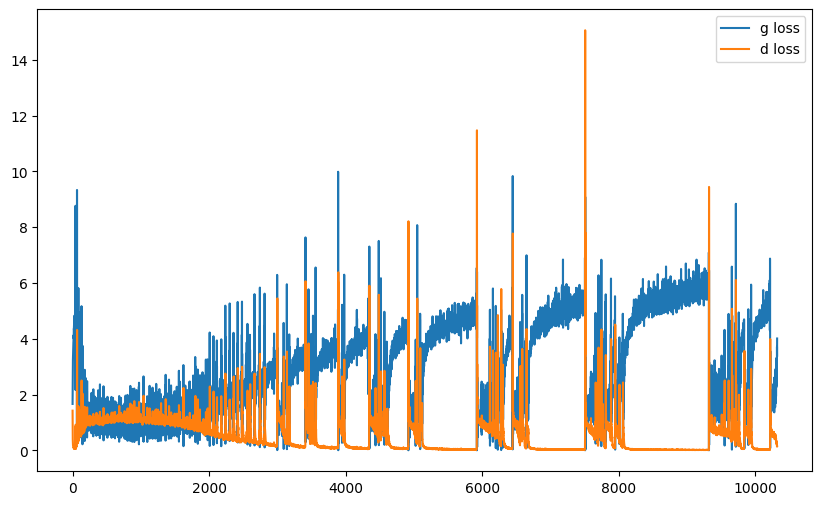

it: 10518; g_loss: 4.735913276672363; d_loss: 0.027382712811231613; avg_real_score: 0.9870413541793823; avg_fake_score: 0.01386056374758482: : 199it [00:11, 19.76it/s]  

generated images


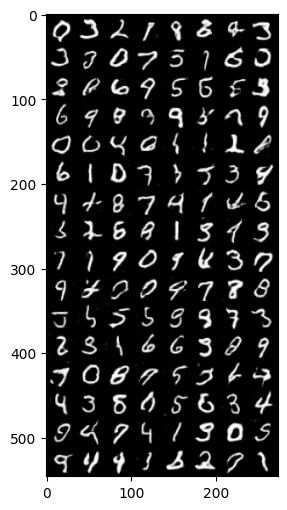

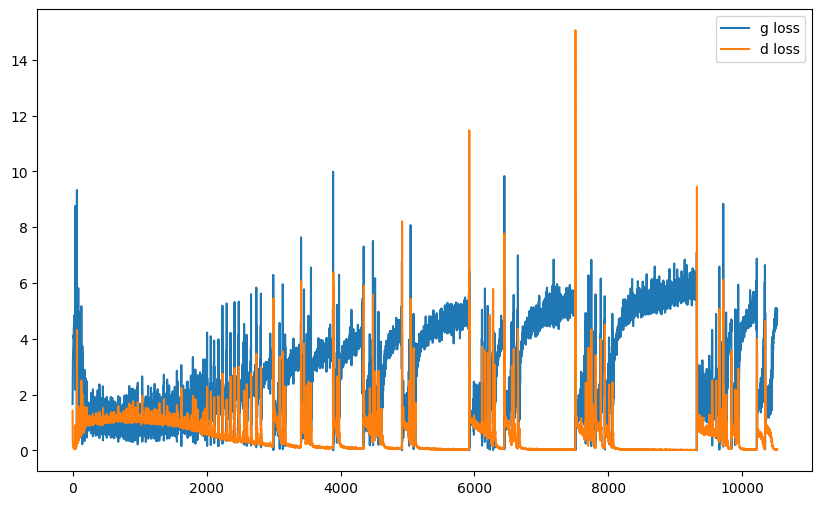

it: 10718; g_loss: 5.466269016265869; d_loss: 0.01729898527264595; avg_real_score: 0.9907792806625366; avg_fake_score: 0.007875578477978706: : 399it [00:22, 17.70it/s]  

generated images


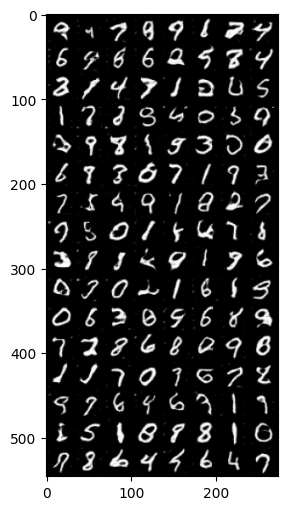

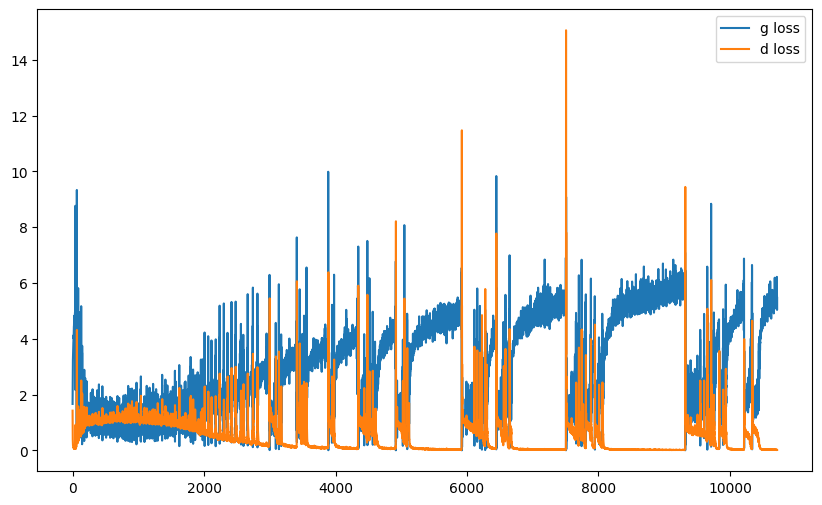

it: 10786; g_loss: 5.060507774353027; d_loss: 0.01943022757768631; avg_real_score: 0.9885773658752441; avg_fake_score: 0.007783856242895126: : 469it [00:27, 17.16it/s]   
it: 10787; g_loss: 5.594058990478516; d_loss: 0.013719247654080391; avg_real_score: 0.9935370683670044; avg_fake_score: 0.007122556678950787: : 0it [00:00, ?it/s]

generated images


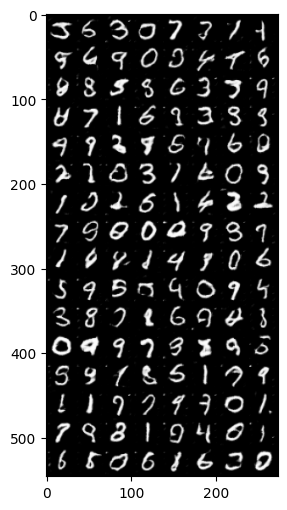

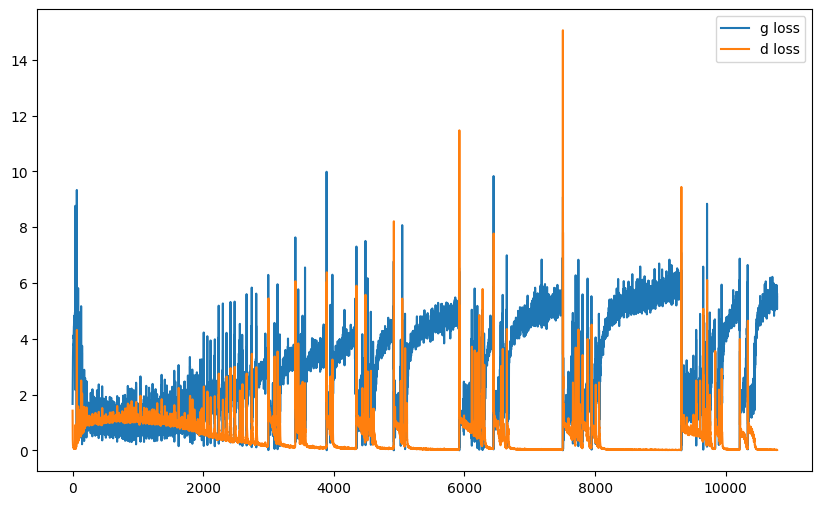

it: 10987; g_loss: 5.167228698730469; d_loss: 0.016038035973906517; avg_real_score: 0.9928831458091736; avg_fake_score: 0.008786726742982864: : 199it [00:12, 18.56it/s] 

generated images


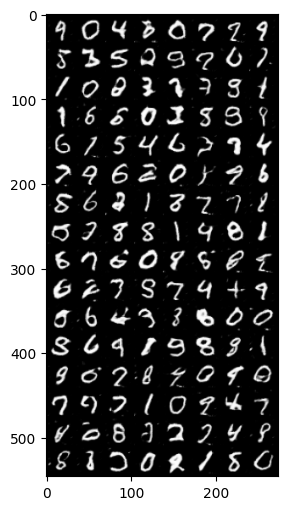

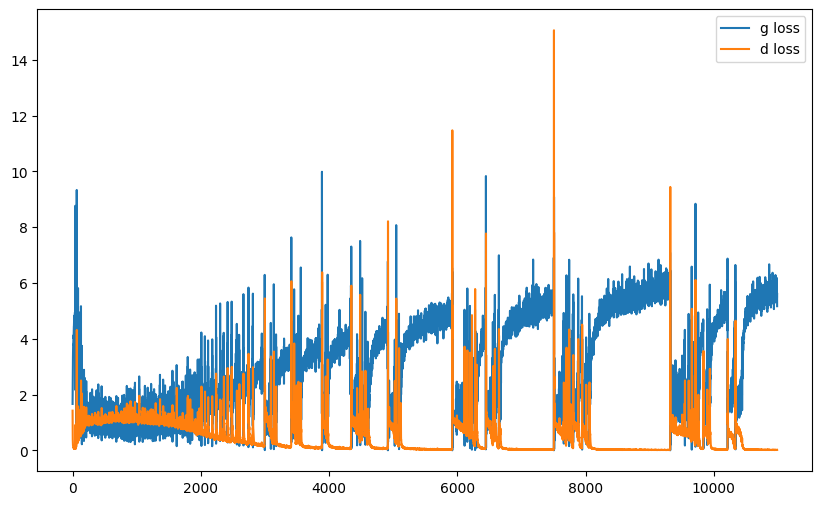

it: 11187; g_loss: 5.994469165802002; d_loss: 0.006896963808685541; avg_real_score: 0.9975425004959106; avg_fake_score: 0.004406302236020565: : 400it [00:26, 14.33it/s]  

generated images


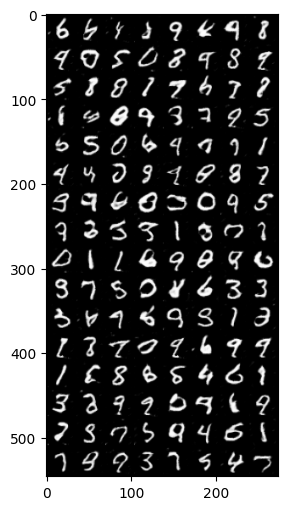

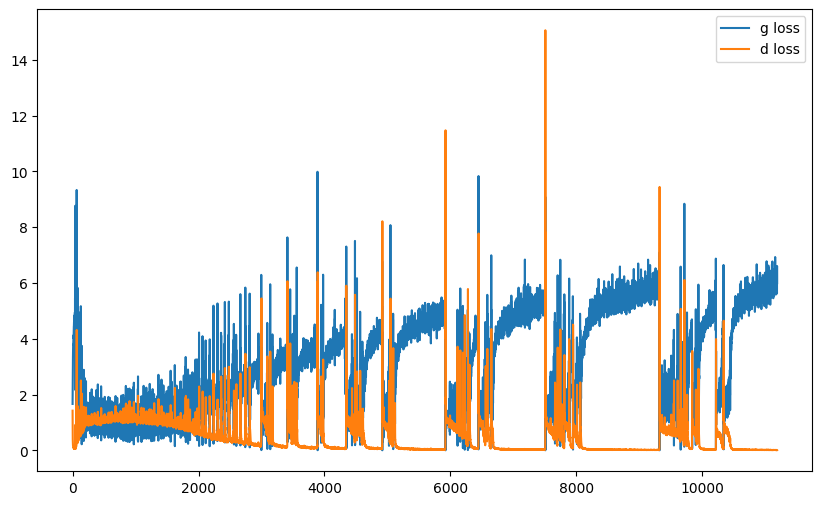

it: 11255; g_loss: 5.503364086151123; d_loss: 0.014160795137286186; avg_real_score: 0.9918429851531982; avg_fake_score: 0.005876913666725159: : 469it [00:30, 15.21it/s] 
it: 11256; g_loss: 5.999042510986328; d_loss: 0.007502229884266853; avg_real_score: 0.9973610639572144; avg_fake_score: 0.004823044873774052: : 0it [00:00, ?it/s]

generated images


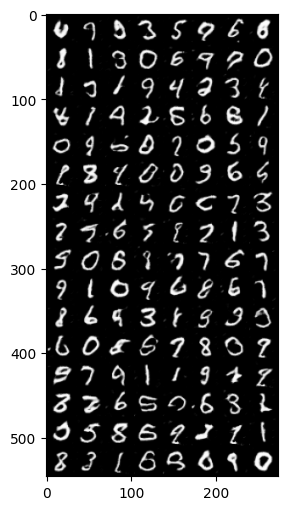

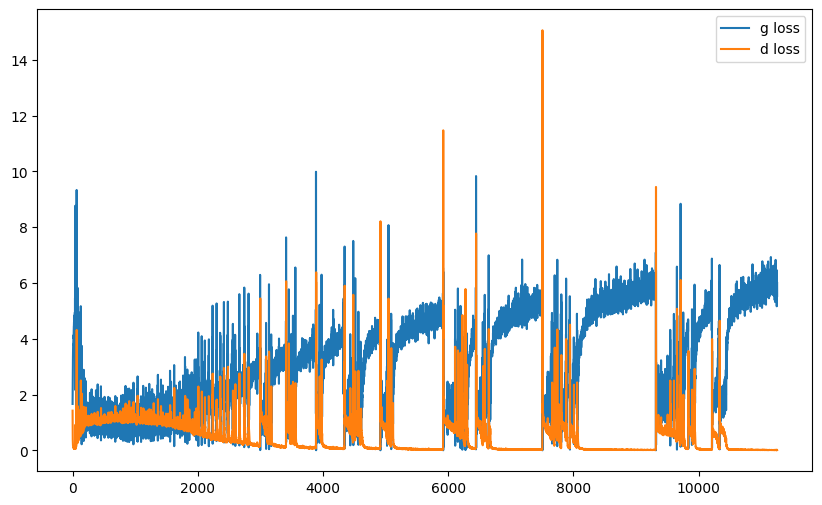

it: 11456; g_loss: 5.720600605010986; d_loss: 0.012112397700548172; avg_real_score: 0.9938106536865234; avg_fake_score: 0.005823948420584202: : 200it [00:11, 19.96it/s]  

generated images


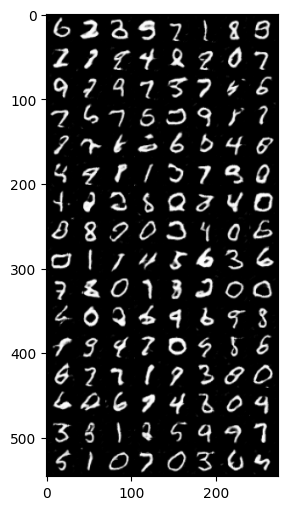

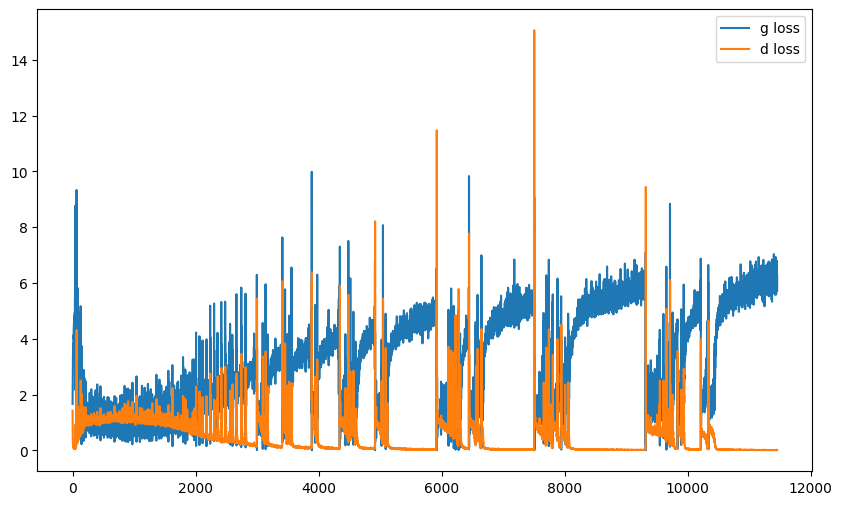

it: 11656; g_loss: 6.486403942108154; d_loss: 0.005561518017202616; avg_real_score: 0.9970533847808838; avg_fake_score: 0.0025976926553994417: : 400it [00:23, 14.72it/s]  

generated images


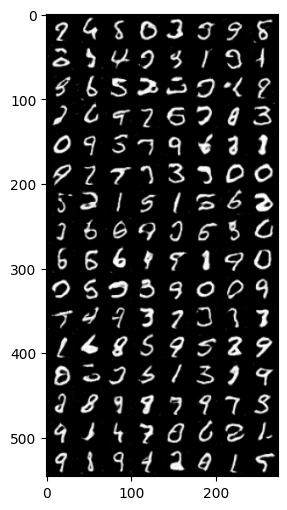

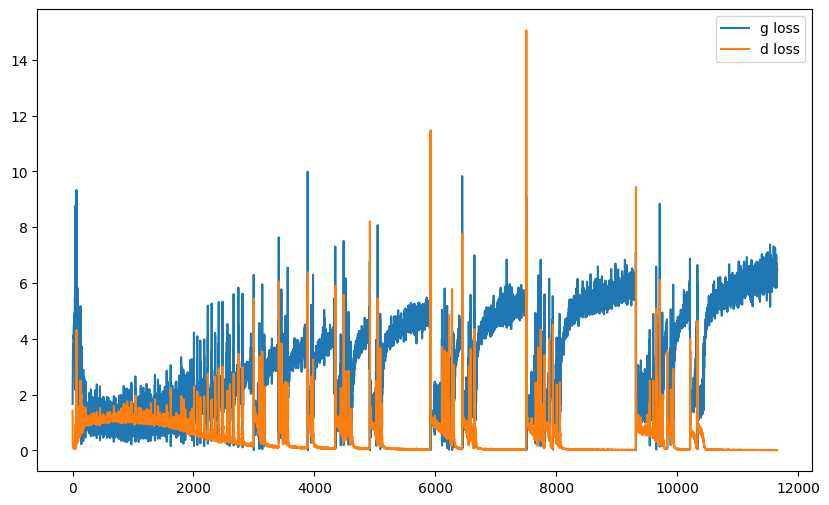

it: 11724; g_loss: 1.0948734283447266; d_loss: 1.0389193296432495; avg_real_score: 0.6128721833229065; avg_fake_score: 0.36978650093078613: : 469it [00:28, 16.38it/s]      
it: 11725; g_loss: 1.2962473630905151; d_loss: 0.919956624507904; avg_real_score: 0.684181809425354; avg_fake_score: 0.3707682192325592: : 0it [00:00, ?it/s]

generated images


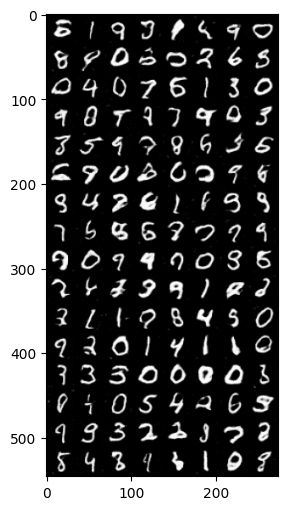

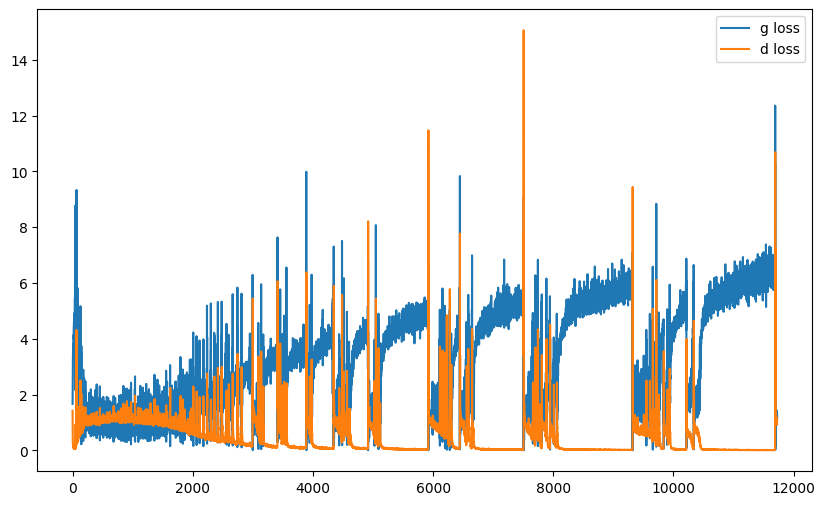

it: 11925; g_loss: 1.7930707931518555; d_loss: 0.5730075240135193; avg_real_score: 0.7665218114852905; avg_fake_score: 0.21687960624694824: : 200it [00:15, 11.51it/s] 

generated images


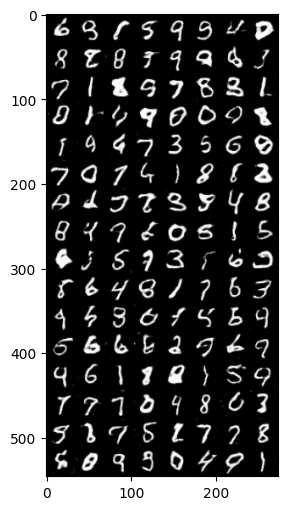

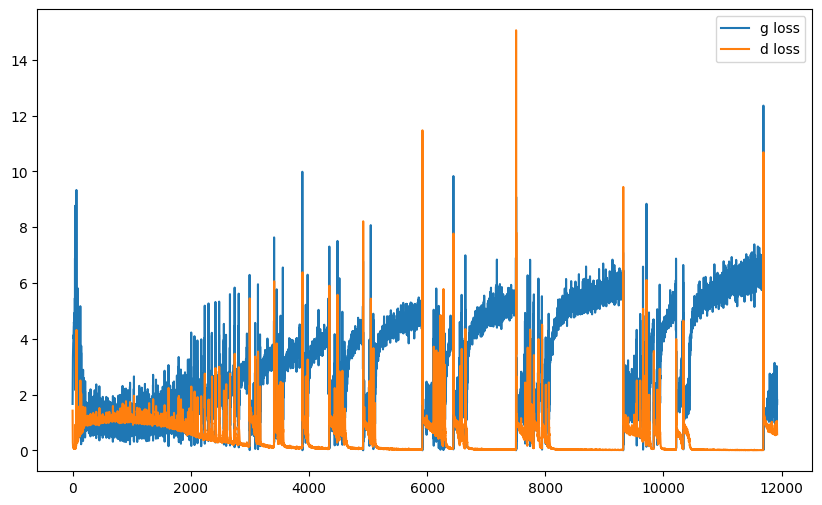

it: 12125; g_loss: 1.30543851852417; d_loss: 0.7306108474731445; avg_real_score: 0.692230224609375; avg_fake_score: 0.24231211841106415: : 400it [00:30, 10.40it/s]     

generated images


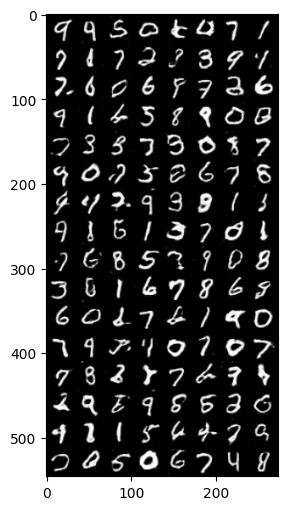

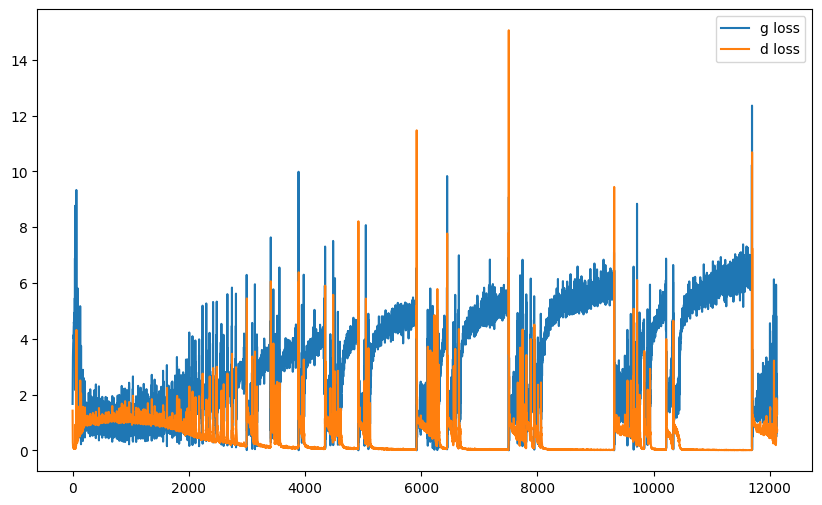

it: 12193; g_loss: 4.283871650695801; d_loss: 0.6298149824142456; avg_real_score: 0.9533635377883911; avg_fake_score: 0.39443787932395935: : 469it [00:37, 12.45it/s]  
it: 12194; g_loss: 0.8191341757774353; d_loss: 1.0706621408462524; avg_real_score: 0.4157949686050415; avg_fake_score: 0.03283214569091797: : 0it [00:00, ?it/s]

generated images


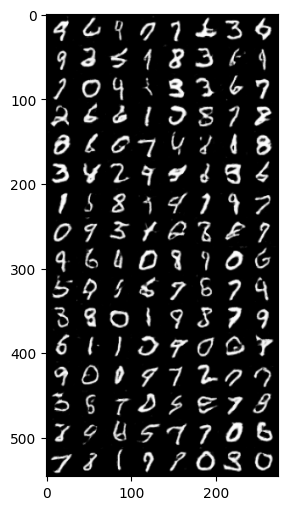

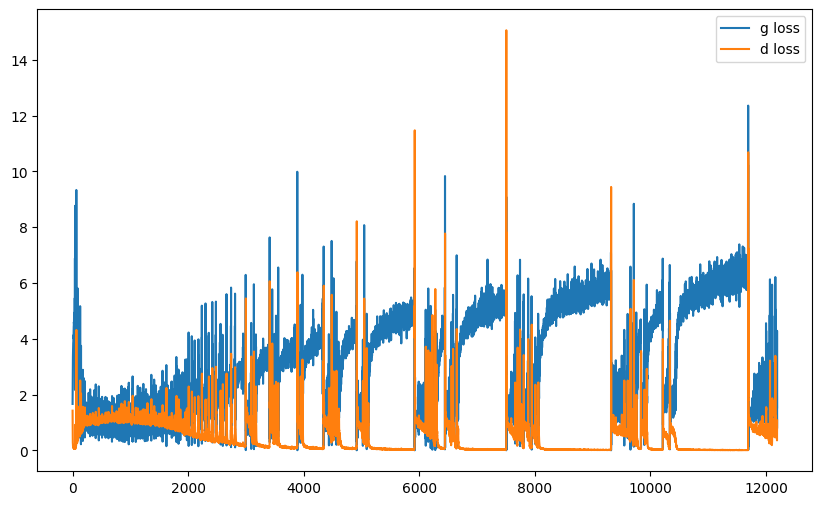

it: 12394; g_loss: 2.6679885387420654; d_loss: 1.074493408203125; avg_real_score: 0.8948162794113159; avg_fake_score: 0.5567626953125: : 200it [00:12, 16.05it/s]      

generated images


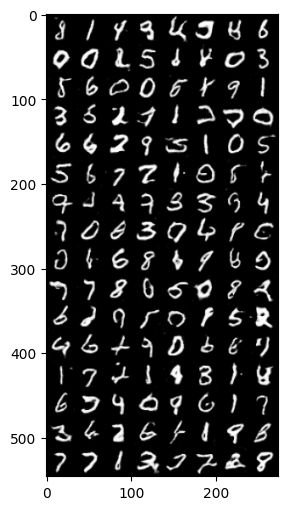

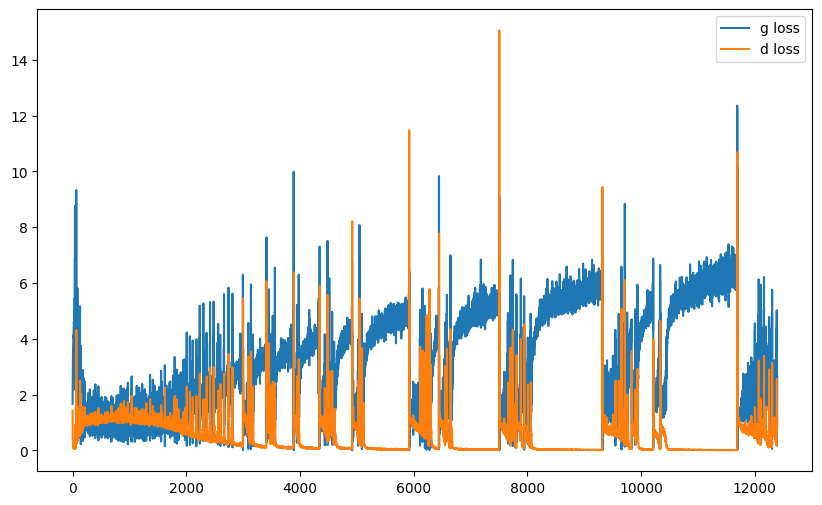

it: 12594; g_loss: 5.267165184020996; d_loss: 0.023411493748426437; avg_real_score: 0.9885362386703491; avg_fake_score: 0.011664479970932007: : 399it [00:29, 11.16it/s] 

generated images


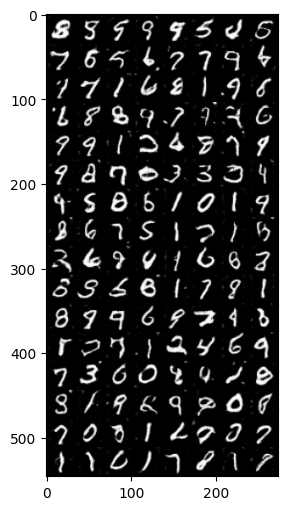

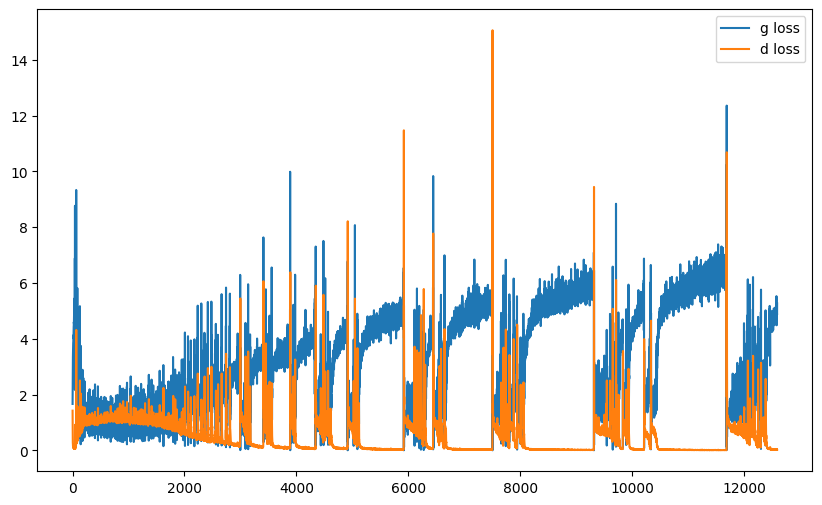

it: 12662; g_loss: 4.540046691894531; d_loss: 0.03989477828145027; avg_real_score: 0.9781450629234314; avg_fake_score: 0.016415901482105255: : 469it [00:34, 13.62it/s]  
it: 12663; g_loss: 4.865013599395752; d_loss: 0.0246646199375391; avg_real_score: 0.9889003038406372; avg_fake_score: 0.013199012726545334: : 0it [00:00, ?it/s]

generated images


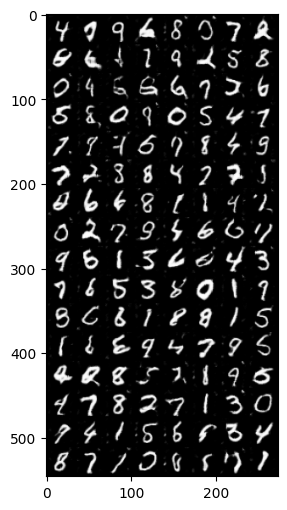

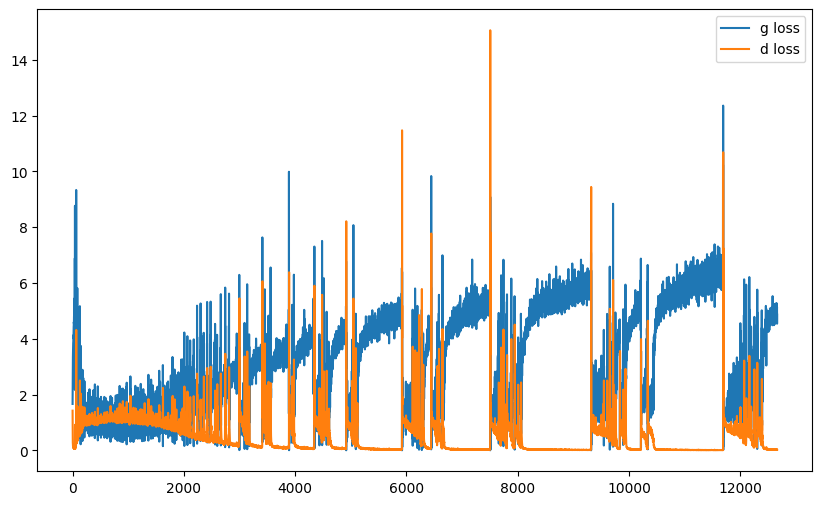

it: 12863; g_loss: 5.731043815612793; d_loss: 0.010687090456485748; avg_real_score: 0.993897020816803; avg_fake_score: 0.004521309398114681: : 200it [00:15, 15.85it/s]  

generated images


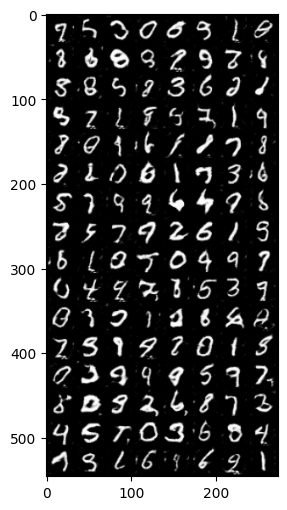

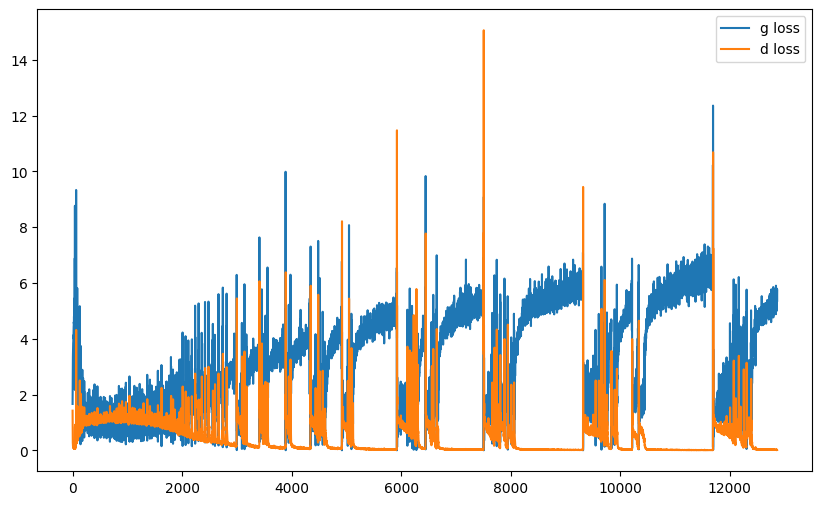

it: 13063; g_loss: 5.659875869750977; d_loss: 0.010820427909493446; avg_real_score: 0.9962286353111267; avg_fake_score: 0.006966039538383484: : 400it [00:29, 14.01it/s]  

generated images


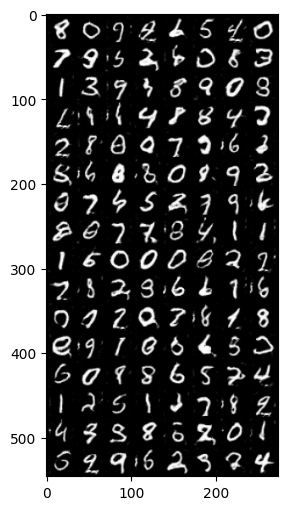

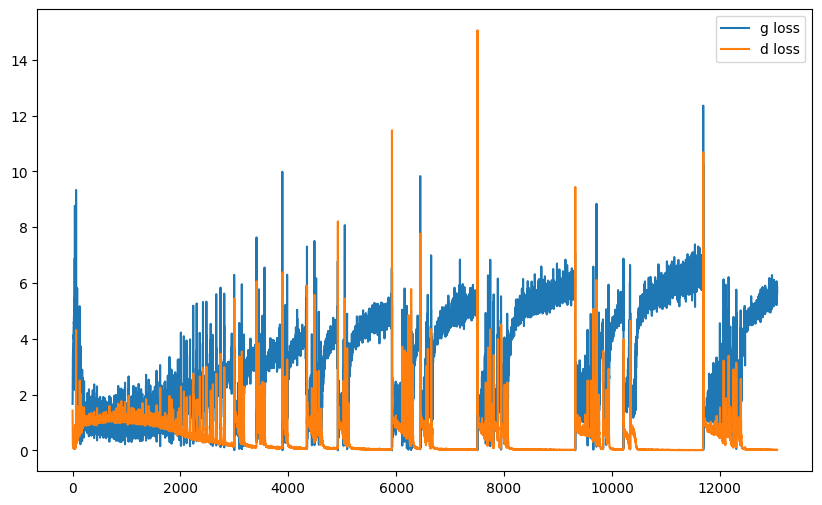

it: 13131; g_loss: 5.3418684005737305; d_loss: 0.013125471770763397; avg_real_score: 0.9939989447593689; avg_fake_score: 0.007033939473330975: : 469it [00:34, 13.45it/s]
it: 13132; g_loss: 5.339269638061523; d_loss: 0.015812495723366737; avg_real_score: 0.9951461553573608; avg_fake_score: 0.010791439563035965: : 0it [00:00, ?it/s]

generated images


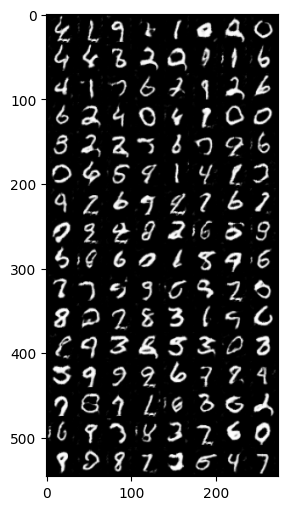

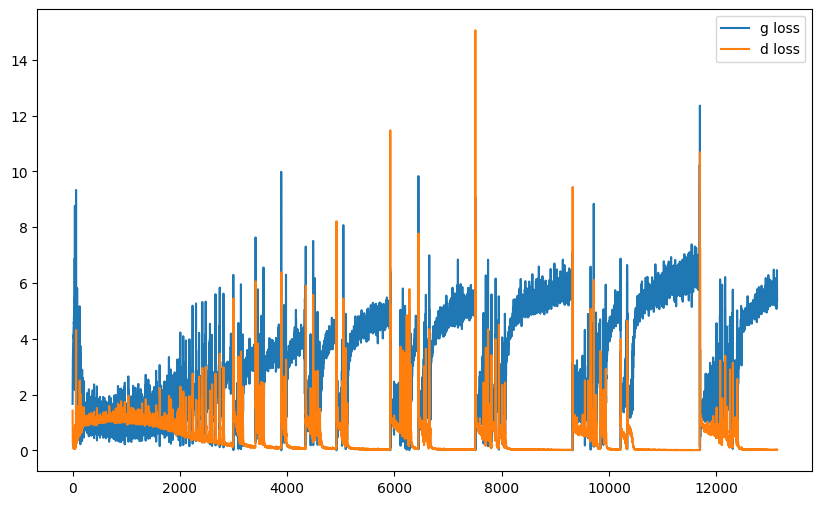

it: 13332; g_loss: 5.981339454650879; d_loss: 0.01055610179901123; avg_real_score: 0.9953221678733826; avg_fake_score: 0.005779067054390907: : 199it [00:17, 10.06it/s]   

generated images


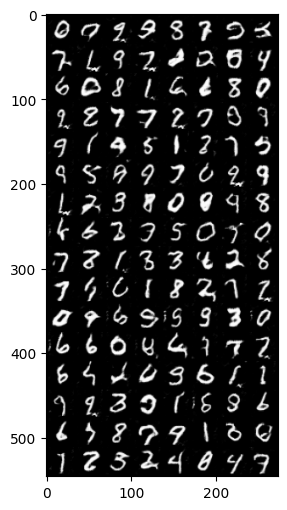

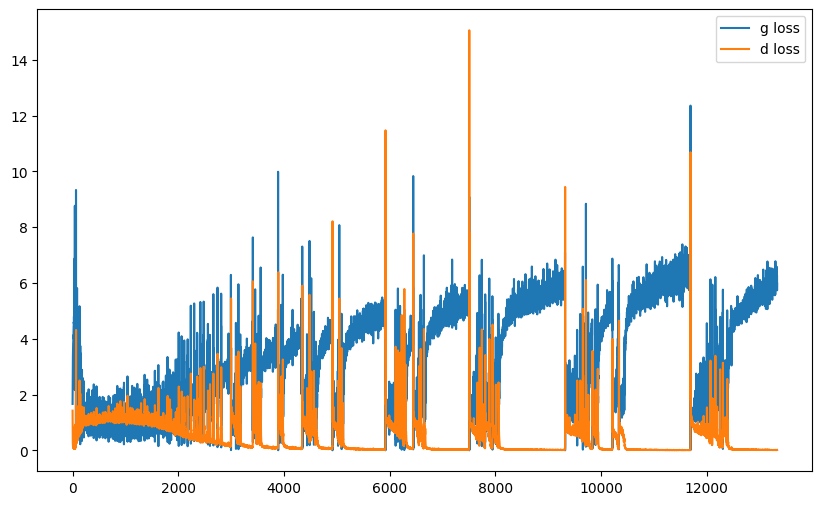

it: 13532; g_loss: 6.20638370513916; d_loss: 0.007711992133408785; avg_real_score: 0.995406985282898; avg_fake_score: 0.0030751810409128666: : 400it [00:30, 17.39it/s]    

generated images


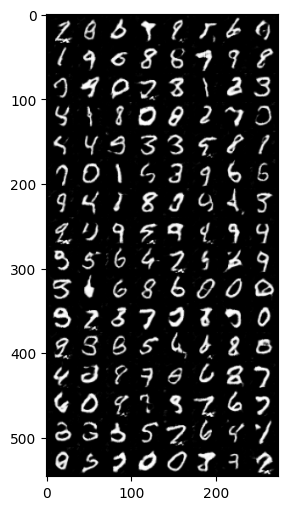

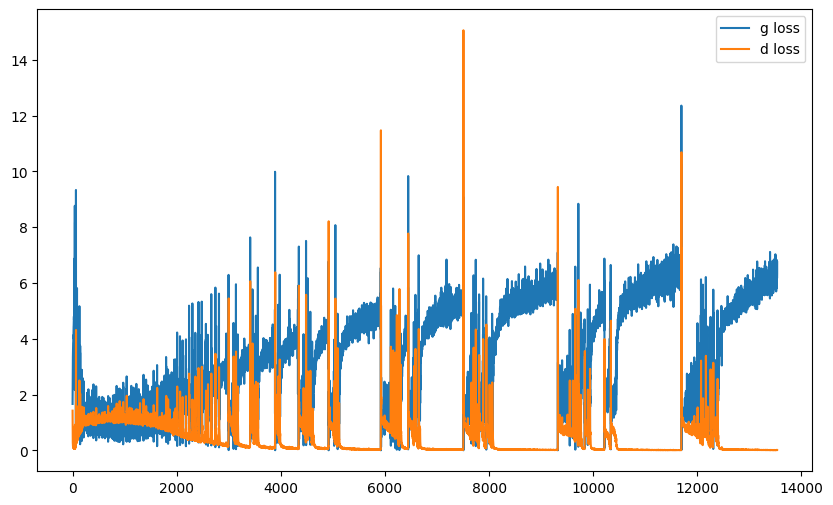

it: 13600; g_loss: 6.176856517791748; d_loss: 0.006804675795137882; avg_real_score: 0.997327983379364; avg_fake_score: 0.004093266557902098: : 469it [00:35, 13.34it/s]    
it: 13601; g_loss: 6.120192527770996; d_loss: 0.0069603812880814075; avg_real_score: 0.9970728158950806; avg_fake_score: 0.004007828887552023: : 0it [00:00, ?it/s]

generated images


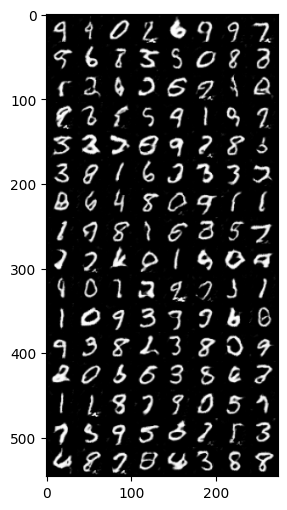

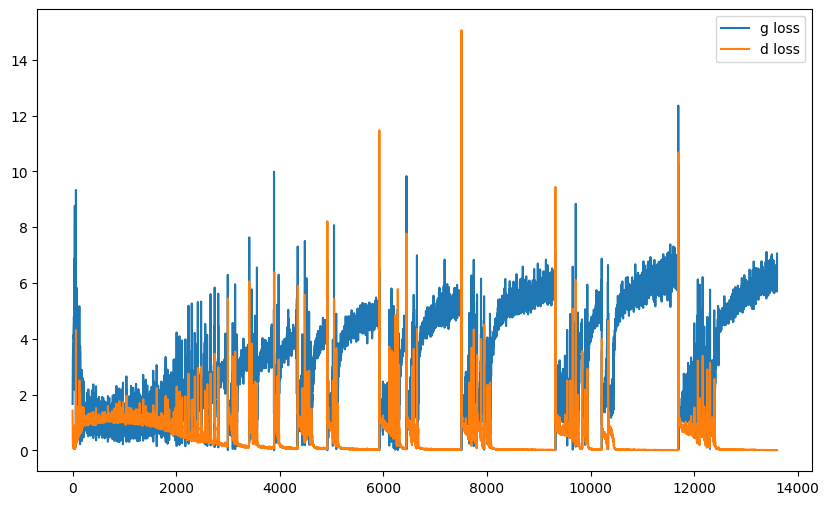

it: 13801; g_loss: 5.8898491859436035; d_loss: 0.00787558313459158; avg_real_score: 0.9976669549942017; avg_fake_score: 0.005502587184309959: : 200it [00:11, 18.25it/s]  

generated images


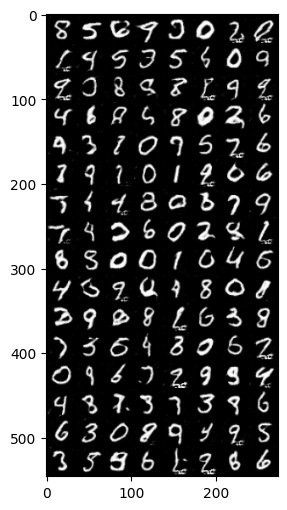

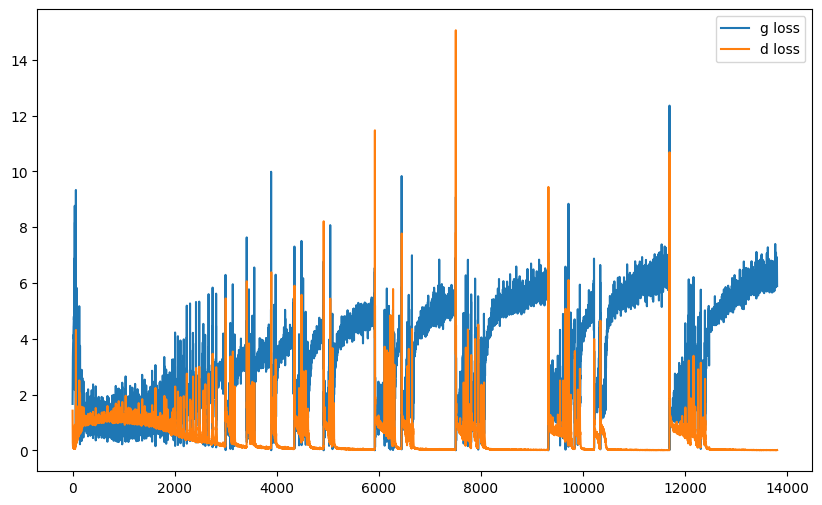

it: 14001; g_loss: 6.549775123596191; d_loss: 0.004599733278155327; avg_real_score: 0.9978384375572205; avg_fake_score: 0.002424909733235836: : 399it [00:23, 11.33it/s]  

generated images


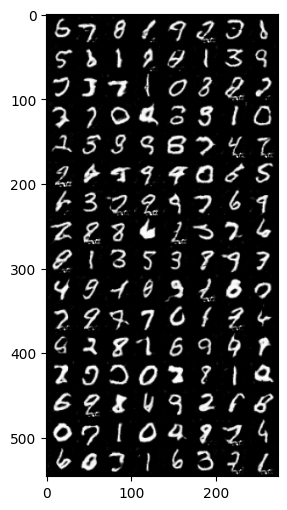

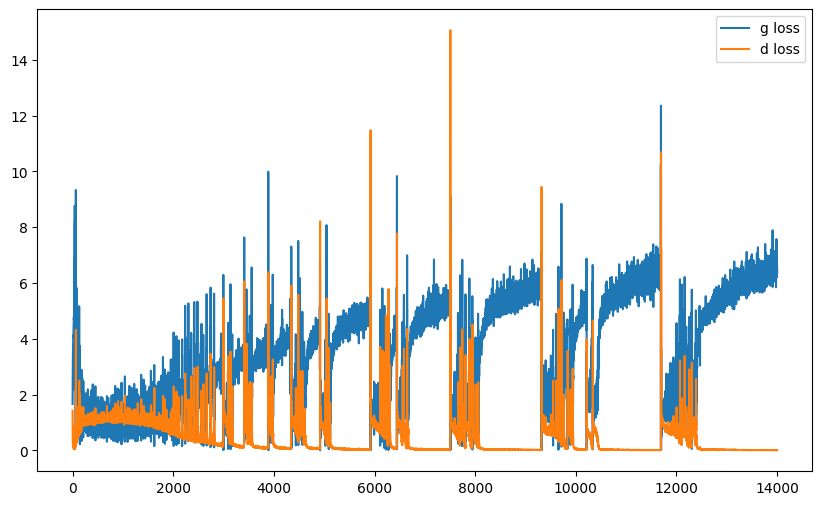

it: 14069; g_loss: 6.658191204071045; d_loss: 0.0044316016137599945; avg_real_score: 0.9979791641235352; avg_fake_score: 0.0023981179110705853: : 469it [00:28, 16.68it/s] 


In [86]:
nb_epochs = 30

g_losses = []
d_losses = []


j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):

    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)

        cur_batch_size = im.shape[0]


        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################

        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)

        # 2. Generate a fake image
        fake_im = netG(z)

        # 3. Classify real image with D
        yhat_real = netD(im)
        real_labels = get_labels_one(cur_batch_size)

        # 4. Classify fake image with D
        yhat_fake = netD(fake_im.detach())  # detach to avoid gradients affecting the generator
        fake_labels = get_labels_zero(cur_batch_size)


        ###
        ### Discriminator
        ###

        d_loss = criterion(yhat_real, real_labels) + criterion(yhat_fake, fake_labels)#     YOUR CODE HERE
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()


        ###
        ### Generator
        ###


        g_loss = criterion(netD(fake_im), real_labels)#      YOUR CODE HERE
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()



        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            #fake_im = G(z_test)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)

            print("generated images")
            plt.imshow(pil_grid)
            plt.show()

            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1

# 4. Conditional GANs [BONUS]

A simple way to improve training performance and obtain control of the generation is to provide extra information into the Generator and the Discriminator, known as **Conditional GANs**. In this case, we will provide the class label (digit number of MNIST) into both the generator and the discriminator. This will help both of the networks.

## 4.1 Conditional Generator and Discriminator

Complete the ConditionalDiscriminator and ConditionalGenerator classes using your GAN building blocks (`get_upsampling_block` and `get_downsampling_block` functions).


### 4.1.1 Generator

In [60]:
# GENERATOR

'''
The conditional generator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the generator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized

'''

class ConditionalGenerator(nn.Module):
    def __init__(self, nz, nc, ngf, nchannels=1):
        super().__init__()

        self.upscaling_z = get_upscaling_block(nz, ngf*8, 4, 1, 0)
        self.upscaling_c = get_upscaling_block(nc, ngf*8, 4, 1, 0)
        
        self.rest_model = nn.Sequential(
            get_upscaling_block(ngf * 16, ngf * 8, 4, 2, 1),  # ngf*8 + ngf*8 channel
            get_upscaling_block(ngf * 8, ngf * 4, 4, 2, 1),
            get_upscaling_block(ngf * 4, nchannels, 4, 2, 1, last_layer=True),
        )

    def forward(self, x, y):
        x = x.unsqueeze(2).unsqueeze(2)
        x = self.upscaling_z(x)

        y = y.unsqueeze(2).unsqueeze(2)
        y = self.upscaling_c(y)

        x = torch.cat((x, y), dim=1)
        return self.rest_model(x)

### 4.1.2 Discriminator

In [61]:
# Discriminator

'''
The conditional discriminator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the discriminator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized

'''

class ConditionalDiscriminator(nn.Module):
    def __init__(self, ndf, nc, nchannels=1):
        super().__init__()
        self.ndf = ndf
        self.downscale_x = get_downscaling_block(
            nchannels, ndf * 2, 4, 2, 1, use_batch_norm=False
        )
        self.downscale_y = get_downscaling_block(
            nc, ndf * 2, 4, 2, 1, use_batch_norm=False
        )
        self.rest = nn.Sequential(
            get_downscaling_block(
                ndf * 4, ndf * 8, 4, 2, 1
            ),  # input = ndf*2 + ndf*2 concatenation of downscale_x / y
            get_downscaling_block(ndf * 8, ndf * 16, 4, 2, 1),
            get_downscaling_block(ndf * 16, 1, 4, 1, 0, is_last=True),
        )

    def forward(self, x, y):
        y = y.unsqueeze(2).unsqueeze(2).expand(-1, -1, self.ndf, self.ndf)
        y = self.downscale_y(y)
        x = self.downscale_x(x)

        x = torch.cat((x, y), dim=1)
        return self.rest(x).squeeze(1).squeeze(1)  # remove spatial dimensions

### 4.1.3 Sanity Checks

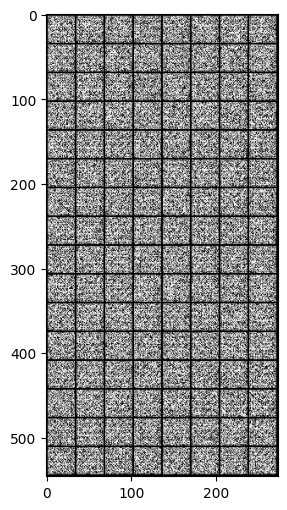

In [65]:
# CONDITIONAL GENERATOR SANITY CHECKING
real_batch, real_labels = next(iter(dataloader))
z = torch.randn(batch_size, nz)
y = F.one_hot(real_labels).float()

cG = ConditionalGenerator(nz=nz, ngf=16, nc=10)
x_fake = cG(z, y)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

In [66]:
# Conditional Discriminator Sanity Checking

cD = ConditionalDiscriminator(ndf=32, nc=10, nchannels=1)
assert cD(real_batch, F.one_hot(real_labels).float()).shape == (real_batch.shape[0], 1)

## 4.2 Training

In [67]:
nz = 100
ndf = 32
ngf = 32
nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

nc= 10

netD = ConditionalDiscriminator(ndf, nc, nchannels=1).to(device)
netG = ConditionalGenerator(nz, nc, ngf).to(device)

netG.apply(weights_init)
netD.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))



0it [00:00, ?it/s]

it: 0; g_loss: 4.371207237243652; d_loss: 1.6770859956741333; avg_real_score: 0.5682897567749023; avg_fake_score: 0.5988373160362244: : 0it [00:00, ?it/s]

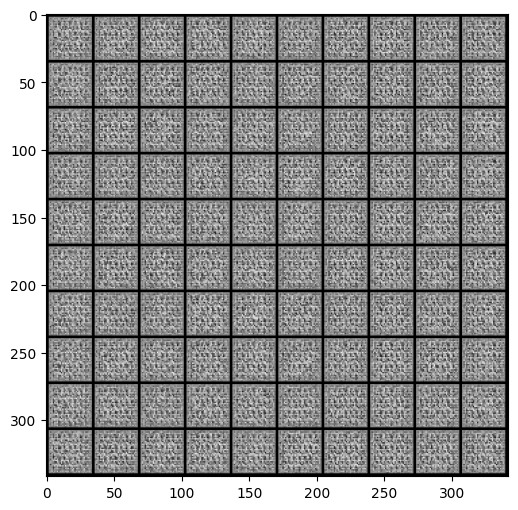

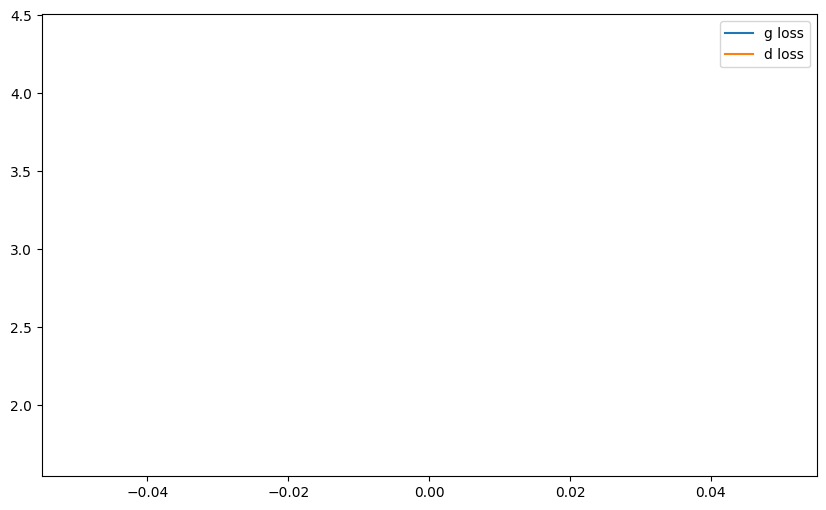

it: 200; g_loss: 2.1353073120117188; d_loss: 0.8886750936508179; avg_real_score: 0.7010758519172668; avg_fake_score: 0.3587307929992676: : 200it [00:23,  7.80it/s]  

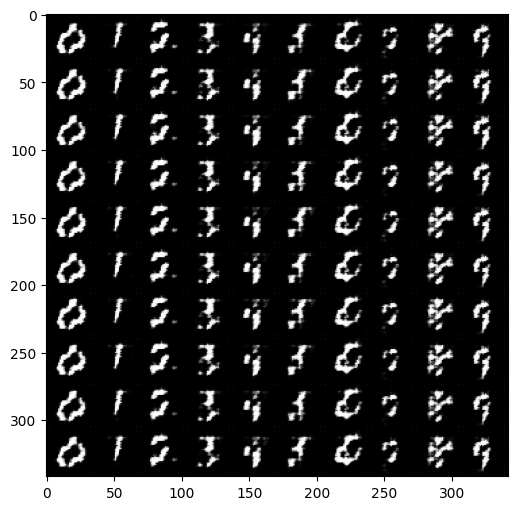

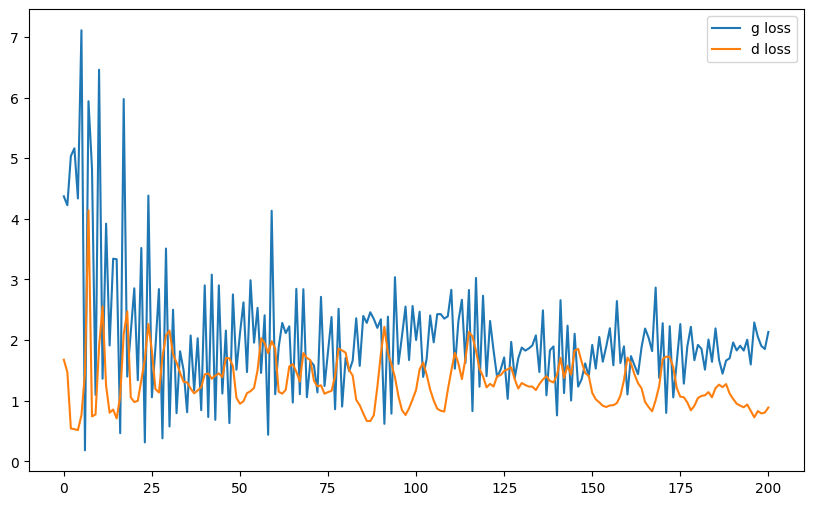

it: 400; g_loss: 1.682492971420288; d_loss: 1.0040150880813599; avg_real_score: 0.5669110417366028; avg_fake_score: 0.23727594316005707: : 400it [00:52,  6.39it/s]  

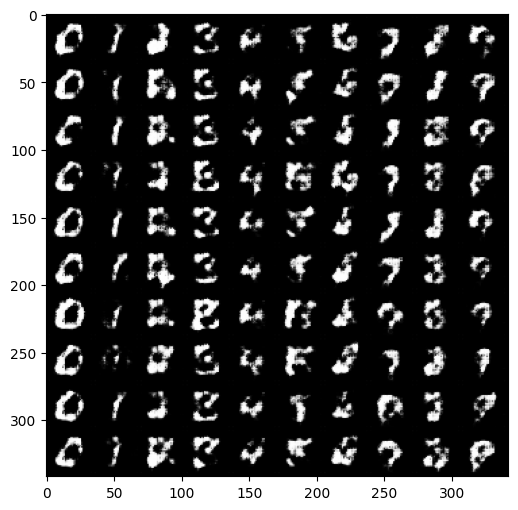

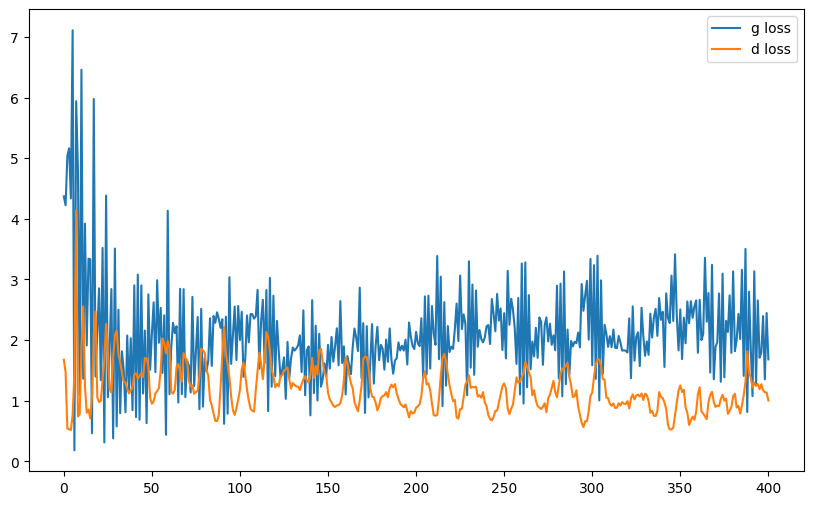

it: 468; g_loss: 1.8254855871200562; d_loss: 1.1548078060150146; avg_real_score: 0.6510207653045654; avg_fake_score: 0.4244973659515381: : 469it [01:00,  7.74it/s] 
it: 469; g_loss: 1.5533597469329834; d_loss: 1.2280277013778687; avg_real_score: 0.5545616149902344; avg_fake_score: 0.3787243068218231: : 0it [00:00, ?it/s]

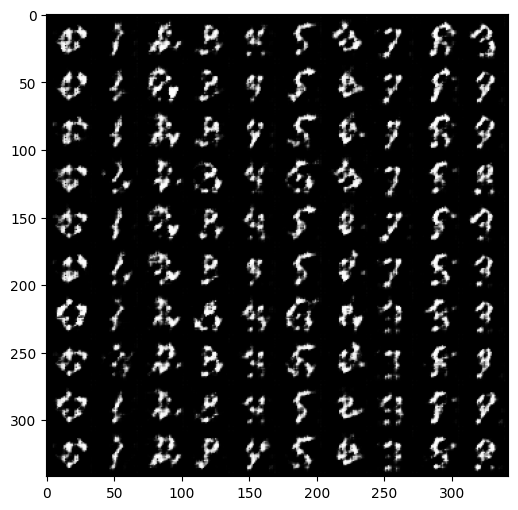

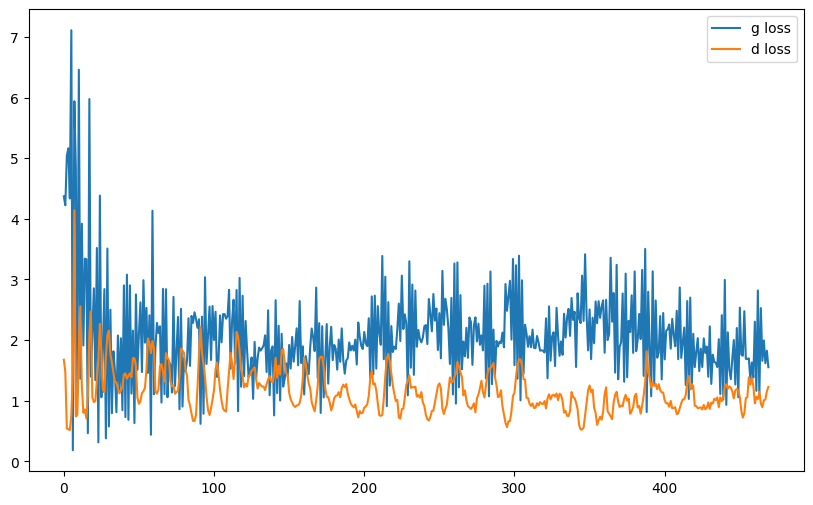

it: 669; g_loss: 1.8619481325149536; d_loss: 1.0058485269546509; avg_real_score: 0.7283058166503906; avg_fake_score: 0.4518154561519623: : 200it [00:22,  8.69it/s]  

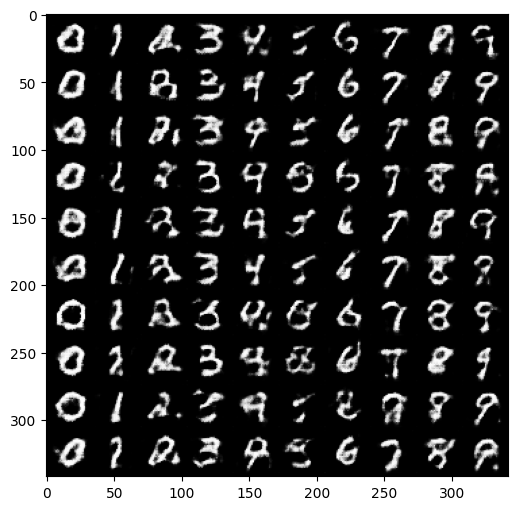

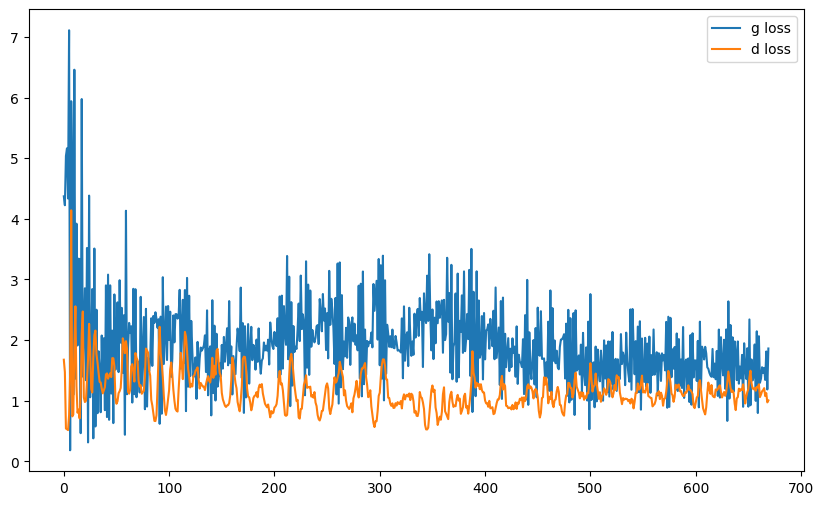

it: 869; g_loss: 1.6175129413604736; d_loss: 1.20883309841156; avg_real_score: 0.6175172328948975; avg_fake_score: 0.4551299810409546: : 400it [00:45,  9.05it/s]    

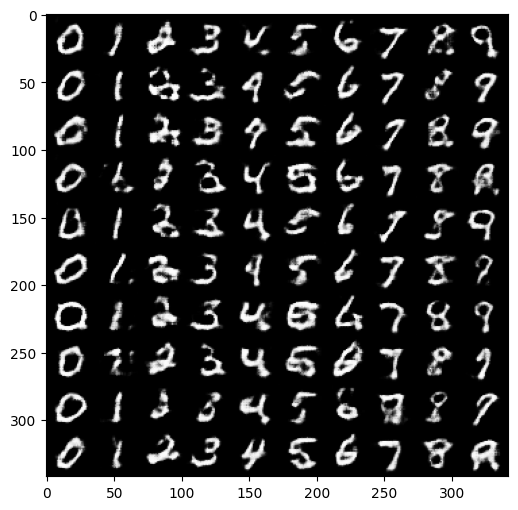

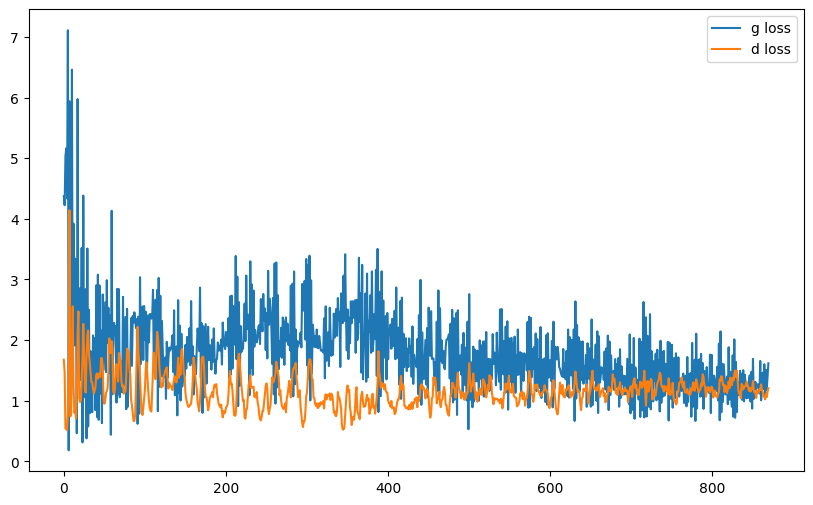

it: 937; g_loss: 1.2847875356674194; d_loss: 1.3628348112106323; avg_real_score: 0.6059287190437317; avg_fake_score: 0.5248045325279236: : 469it [00:53,  8.73it/s]   
it: 938; g_loss: 0.9996151328086853; d_loss: 1.2879674434661865; avg_real_score: 0.5059438943862915; avg_fake_score: 0.38419225811958313: : 0it [00:00, ?it/s]

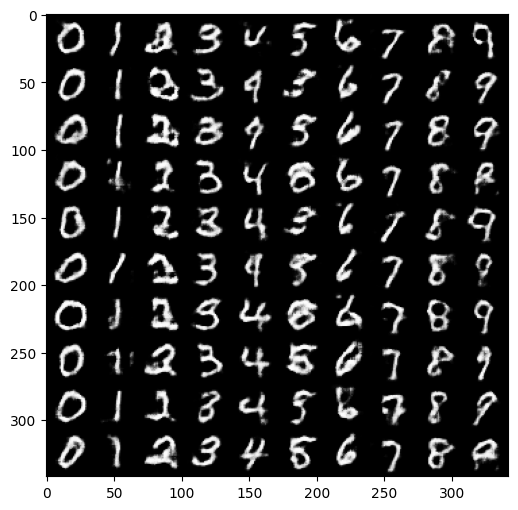

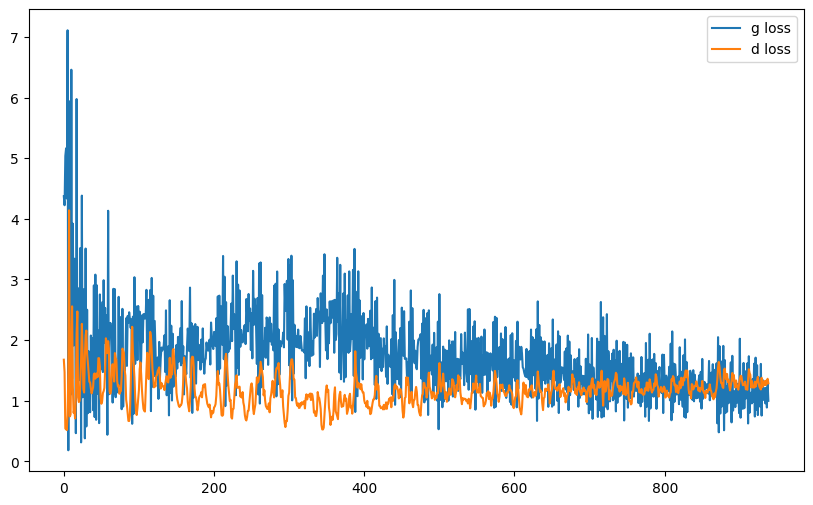

it: 1138; g_loss: 1.5307152271270752; d_loss: 1.2833101749420166; avg_real_score: 0.6742490530014038; avg_fake_score: 0.5480336546897888: : 200it [00:23,  8.59it/s]  

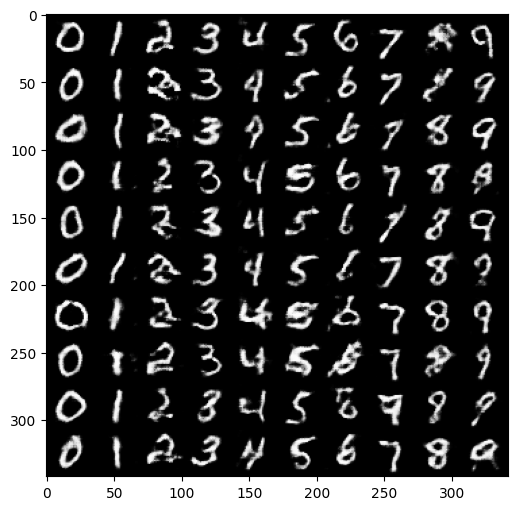

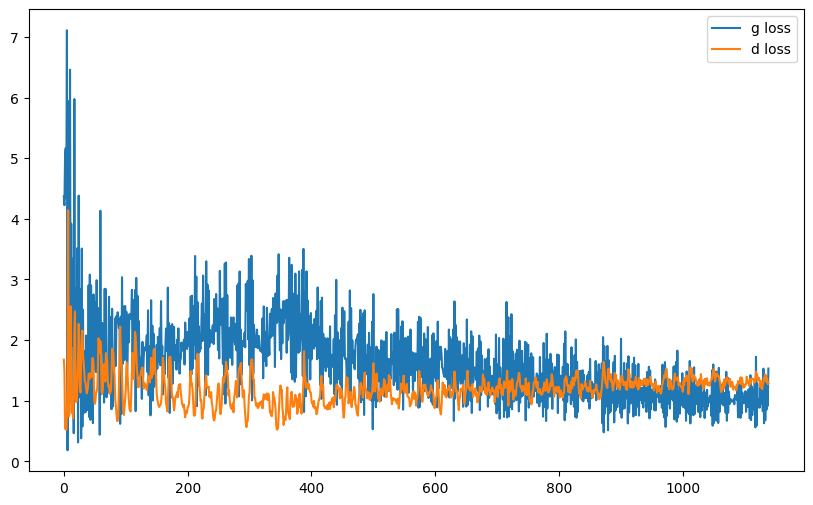

it: 1338; g_loss: 0.8005755543708801; d_loss: 1.3293452262878418; avg_real_score: 0.5188981890678406; avg_fake_score: 0.45102953910827637: : 400it [00:49,  8.66it/s] 

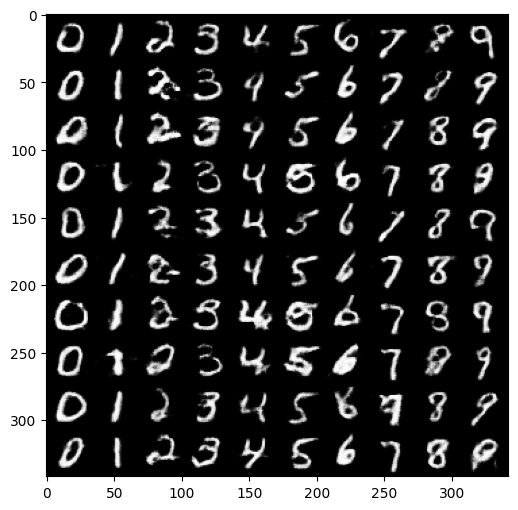

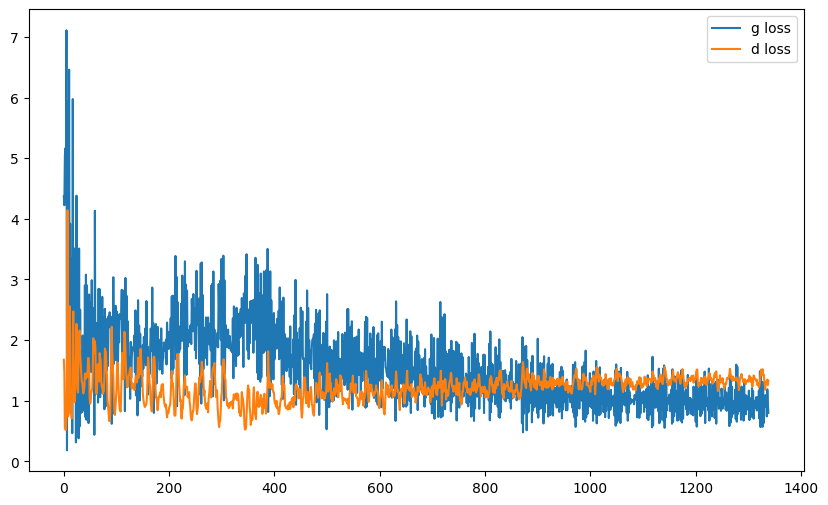

it: 1406; g_loss: 0.9038095474243164; d_loss: 1.3498495817184448; avg_real_score: 0.5247114896774292; avg_fake_score: 0.46703869104385376: : 469it [00:57,  8.20it/s] 
it: 1407; g_loss: 1.005702018737793; d_loss: 1.297744631767273; avg_real_score: 0.5518090724945068; avg_fake_score: 0.46833306550979614: : 0it [00:00, ?it/s]

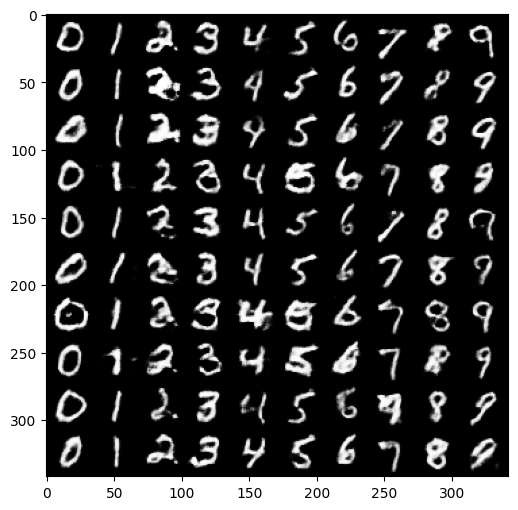

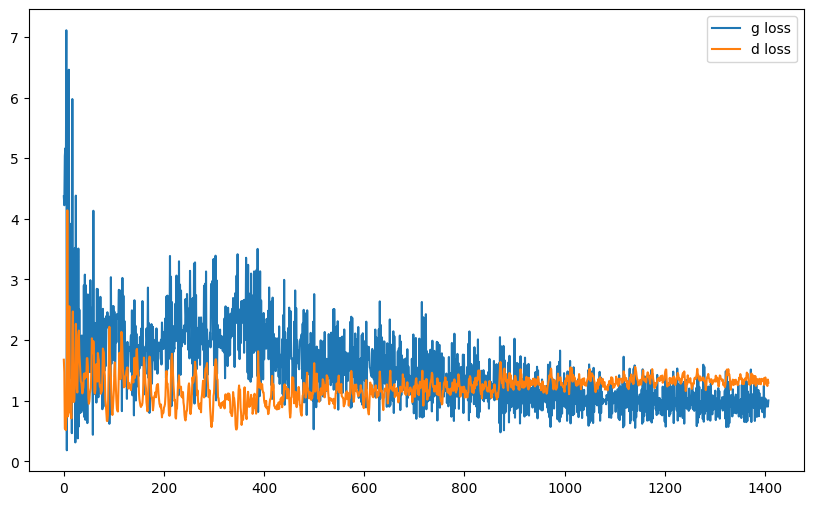

it: 1607; g_loss: 1.2630822658538818; d_loss: 1.331488013267517; avg_real_score: 0.6408848166465759; avg_fake_score: 0.5671871900558472: : 200it [00:24,  8.67it/s]   

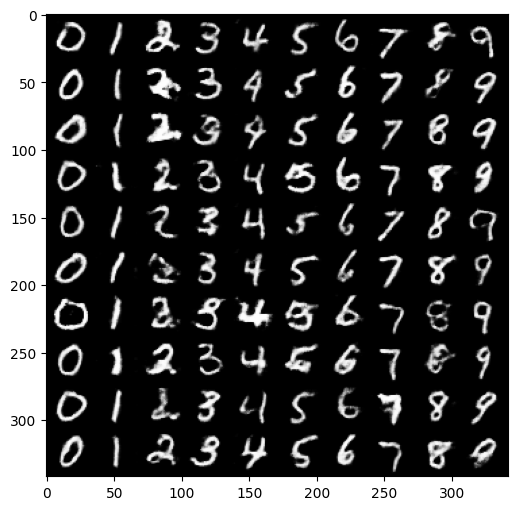

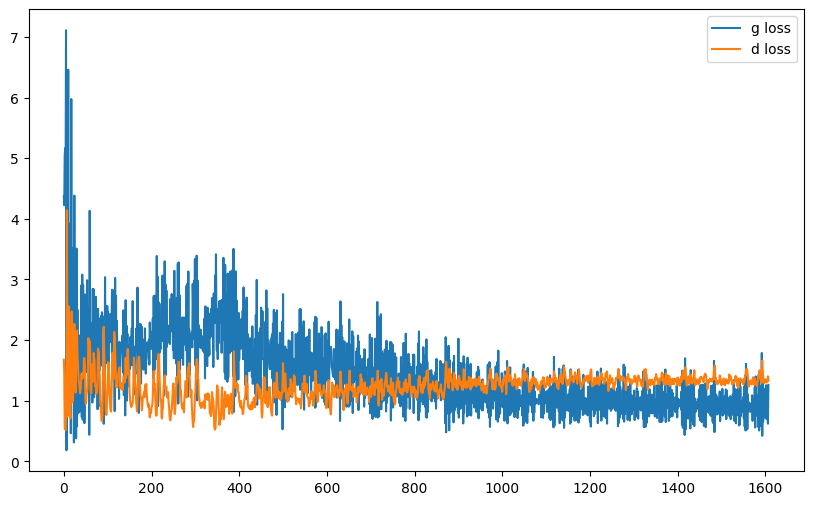

it: 1807; g_loss: 1.1736642122268677; d_loss: 1.3372998237609863; avg_real_score: 0.5729456543922424; avg_fake_score: 0.5124689340591431: : 400it [00:50,  9.06it/s]  

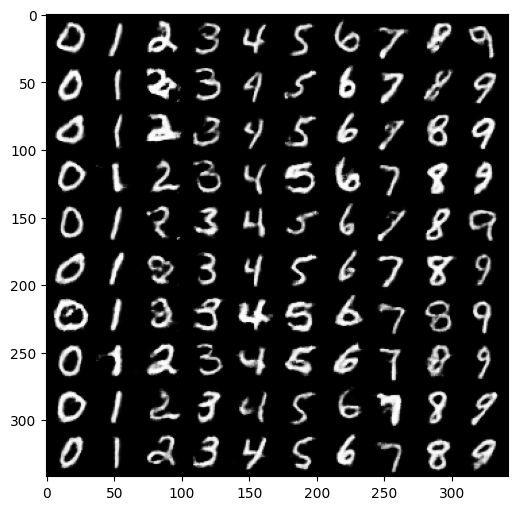

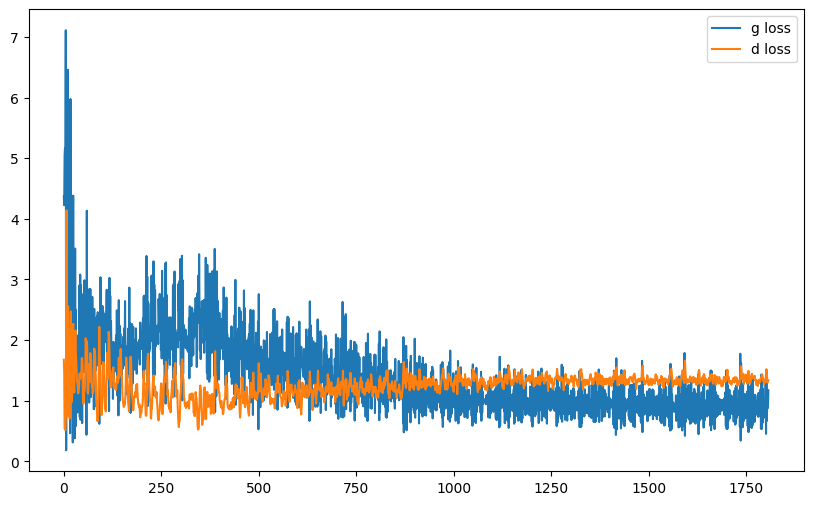

it: 1875; g_loss: 0.8304433226585388; d_loss: 1.334413766860962; avg_real_score: 0.47686967253685; avg_fake_score: 0.4262128472328186: : 469it [00:59,  7.94it/s]      
it: 1876; g_loss: 0.811731219291687; d_loss: 1.3100342750549316; avg_real_score: 0.5351053476333618; avg_fake_score: 0.47321420907974243: : 0it [00:00, ?it/s]

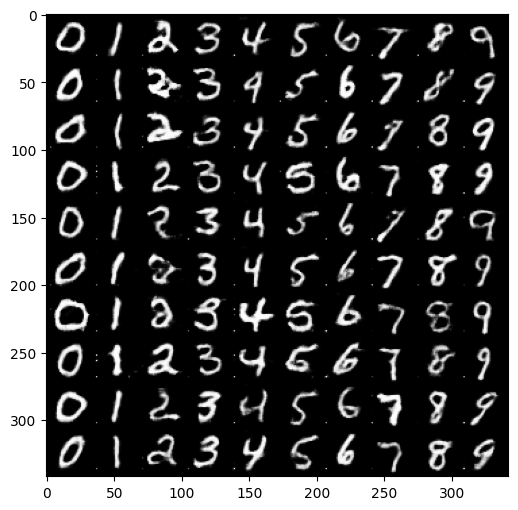

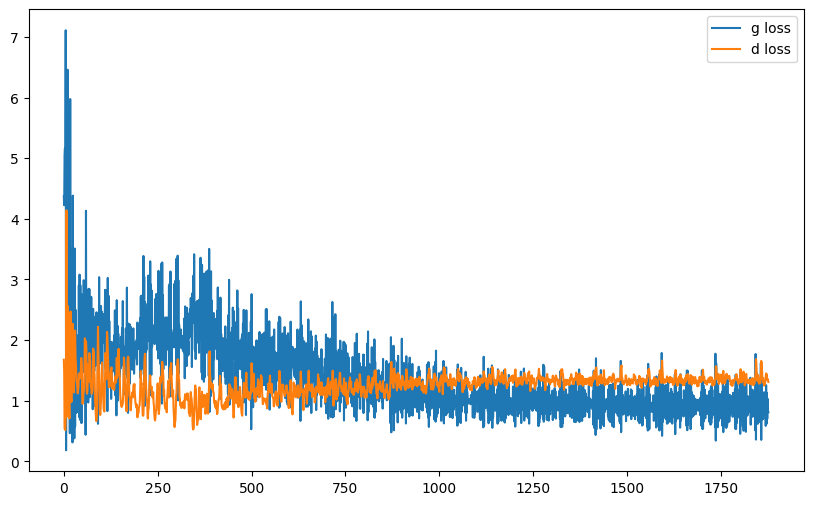

it: 2076; g_loss: 1.0455957651138306; d_loss: 1.278569221496582; avg_real_score: 0.5842822790145874; avg_fake_score: 0.5026117563247681: : 200it [00:24,  8.77it/s]   

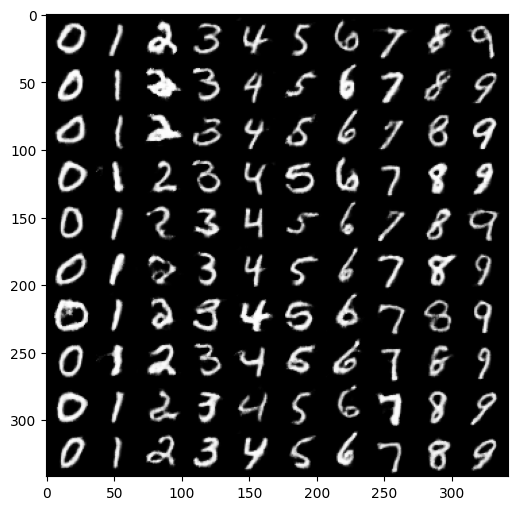

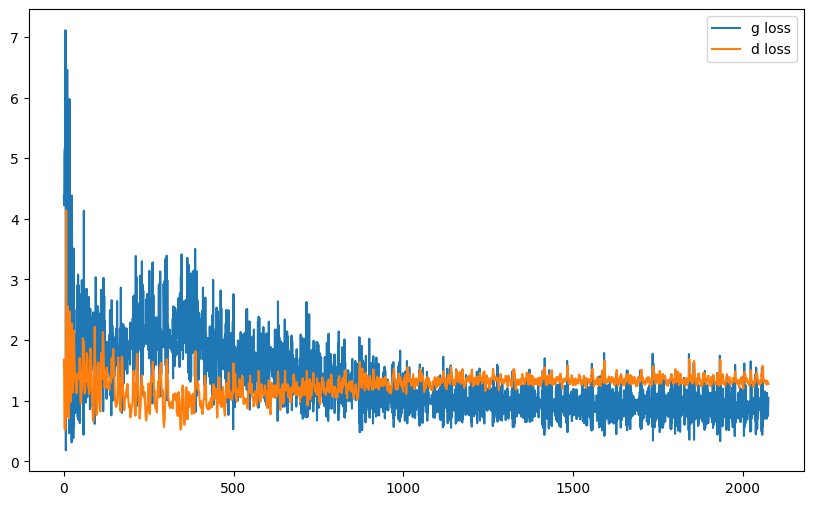

it: 2276; g_loss: 0.6766968965530396; d_loss: 1.390028953552246; avg_real_score: 0.38574695587158203; avg_fake_score: 0.3216313123703003: : 400it [00:47,  8.59it/s]   

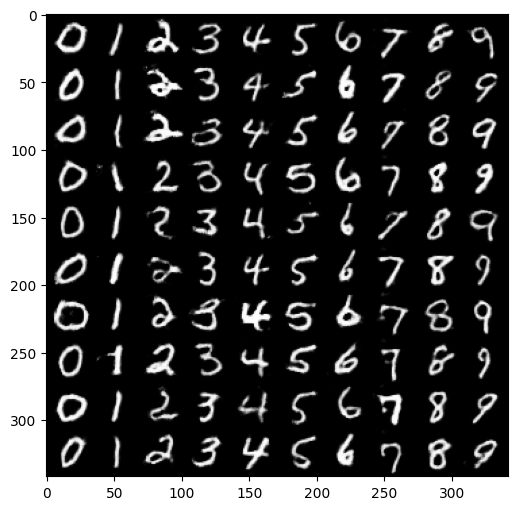

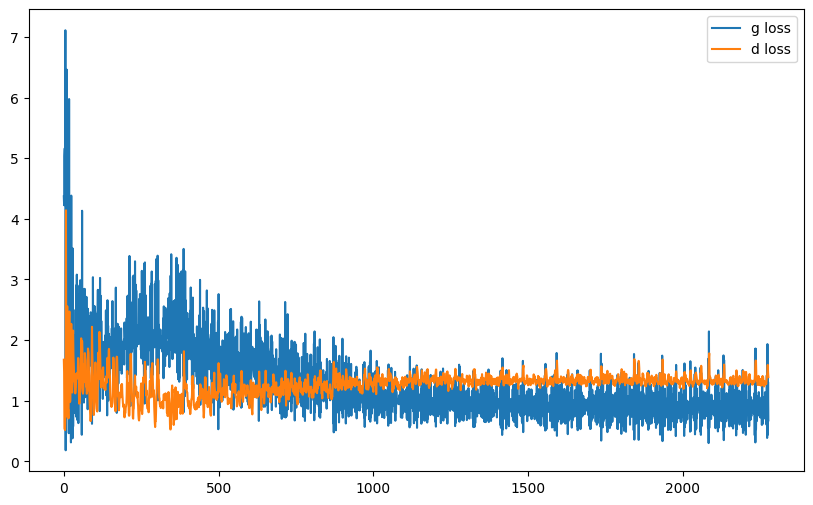

it: 2344; g_loss: 0.6962356567382812; d_loss: 1.321148157119751; avg_real_score: 0.4156584143638611; avg_fake_score: 0.33144649863243103: : 469it [00:56,  8.31it/s]  


In [68]:
nb_epochs = 5

g_losses = []
d_losses = []

j = 0

z_test = sample_z(100, nz)  # we generate the noise only once for testing


for epoch in range(nb_epochs):

    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, labels = batch
        im = im.to(device)


        y = F.one_hot(labels).float().to(device)

        cur_batch_size = im.shape[0]


        ###################
        #                 #
        # YOUR CODE HERE  #
        #                 #
        ###################

        # 1. sample a z vector
        z = sample_z(cur_batch_size, nz)
        
        # 2. Generate a fake image
        fake_images = netG(z, y)

        # 3. Classify real image with D
        yhat_real = netD(im, y)
        loss_D_real = criterion(yhat_real, get_labels_one(cur_batch_size))

        # 4. Classify fake image with D
        yhat_fake = netD(fake_images.detach(), y)
        loss_D_fake = criterion(yhat_fake, get_labels_zero(cur_batch_size))


        ###
        ### Discriminator
        ###

        d_loss = loss_D_real + loss_D_fake# YOUR CODE HERE
        d_opt.zero_grad()
        d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()


        ###
        ### Generator
        ###


        g_loss = criterion(netD(fake_images, y), get_labels_one(cur_batch_size))# YOUR CODE HERE
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()


        # Save Metrics

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        avg_real_score = yhat_real.mean().item()
        avg_fake_score = yhat_fake.mean().item()

        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")

        if i % display_freq == 0:
            labels = torch.arange(0, 10).expand(size=(10, 10)).flatten().to(device)
            y = F.one_hot(labels).float().to(device)
            fake_im = netG(z_test, y)

            un_norm = renorm(fake_im) # for visualization

            grid = torchvision.utils.make_grid(un_norm, nrow=10)
            pil_grid = to_pil(grid)

            plt.imshow(pil_grid)
            plt.show()


            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')

            plt.legend()
            plt.show()

        j += 1


## 4.2 Testing
Visualization of the impact of z on generation. All digits in the same column have the same noise vector z.

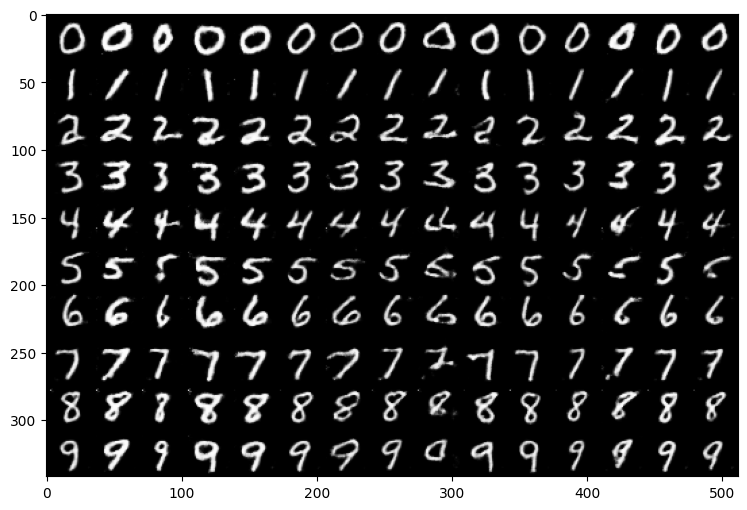

In [69]:
n_ex = 15
n_classes = 10

z = sample_z(n_ex, nz).repeat(n_classes, 1) #.expand(10, nz)

netG.eval()

labels = torch.arange(n_classes).unsqueeze(0).reshape(-1, 1).repeat(1, n_ex).flatten().to(device)

ys = F.one_hot(labels).float()
fake_ims = netG(z, ys)

un_norm= renorm(fake_ims) # for visualization
grid = torchvision.utils.make_grid(un_norm, nrow=n_ex)
pil_grid = to_pil(grid)

plt.imshow(pil_grid)
plt.show()
